#Natural Language Processing for Semantics of Multicultural Proverbs

<h3> PART 2 - Data Analytics and ML</h3>

**AUTHOR: CAMELIA CIOLAC**  
ciolac_c@inria-alumni.fr

In this mini-project we perform Natural Language Processing on proverbs and aphorisms from a variety of cultures, being primarily interested in their semantic analysis.

In PART 1, we develop an elaborated Spacy pipeline with multiple custom components, which include: 
- expanding contractions, 
- negated verbs detection,
- word sense disambiguation (WSD) based on WordNet 3.1 using SupWSD, BlazeGraph and SPARQL over BabelNet ,
- semantic role labelling (SRL) using AllenNLP,
- coreference resolution of pronouns (COREF) using AllenNLP.  

In PART 2, we start by performing analytics at part of speech level.  
Then, we use various embeddings techniques (static vectors from Spacy, Node2Vec on WordNet, BERT embeddings on dynamic word contexts) and evaluate how well these capture the semantic similarity between the nouns in our dataset.    
Finally, we train a Tensorflow model using BERT embeddings to classify a proverb as figurative (metaphoric) vs realistic.






---------------

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from IPython.core.display import display, HTML, Image
#display(HTML("<style>.container { width:100% !important; }</style>"))

from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle, Circle
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import axes3d

from tabulate import tabulate
from PIL import Image as pilim


import seaborn as sns
%matplotlib inline

**Install various utility tools**

In [ ]:
%%bash

sudo apt-get install tree > /dev/null 2>&1


sudo apt-get install jq  > /dev/null 2>&1
#is neded by pyjq
yes | sudo apt-get install autoconf libtool > /dev/null 2>&1

sudo apt-get install graphviz

Reading package lists...
Building dependency tree...
Reading state information...
graphviz is already the newest version (2.40.1-2).
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.


## Install Python packages 

In [ ]:
!pip --version
!pip3 --version

pip 19.3.1 from /usr/local/lib/python3.7/dist-packages/pip (python 3.7)
pip 19.3.1 from /usr/local/lib/python3.7/dist-packages/pip (python 3.7)


In [ ]:
!pip install -q graphviz
!pip install -q pipdeptree
!pip install -q pip-licenses==3.3.1 

In [ ]:
%%bash

mkdir -p /home/jupyter/tmp/

TMP_SETUP_FOLDER=/home/jupyter/tmp/

cat <<EOF > $TMP_SETUP_FOLDER/requirements_nlp.txt

nltk==3.5

spacy==3.0.3  
deplacy==1.9.1
visualise_spacy_tree==0.0.6

gensim==3.8.3 
textblob==0.15.3 

transformers==4.3.3
sentence-transformers
bertviz

lime

#hyphenate==1.1.0
PyHyphen==4.0.1

editdistance==0.5.3

rdflib==5.0.0 
sparqlwrapper
xmltodict

apyori==1.1.2

node2vec

EOF

pip install -q -r $TMP_SETUP_FOLDER/requirements_nlp.txt

ERROR: pathy 0.4.0 has requirement smart-open<4.0.0,>=2.2.0, but you'll have smart-open 5.0.0 which is incompatible.
ERROR: botocore 1.20.53 has requirement urllib3<1.27,>=1.25.4, but you'll have urllib3 1.24.3 which is incompatible.


Now install more python packages with utilities:

In [ ]:
%%bash

TMP_SETUP_FOLDER=/home/jupyter/tmp/

cat <<EOF > $TMP_SETUP_FOLDER/requirements_tools.txt

intervaltree

tabulate
more-itertools==8.7.0

pydotplus
graphviz
adjustText

pyjq
methodtools

GPUtil

line_profiler==3.0.2

EOF

pip install -q -r $TMP_SETUP_FOLDER/requirements_tools.txt

In [ ]:
!pip show spacy

Name: spacy
Version: 3.0.3
Summary: Industrial-strength Natural Language Processing (NLP) in Python
Home-page: https://spacy.io
Author: Explosion
Author-email: contact@explosion.ai
License: MIT
Location: /usr/local/lib/python3.7/dist-packages
Requires: pathy, importlib-metadata, cymem, packaging, thinc, spacy-legacy, pydantic, jinja2, preshed, typer, wasabi, catalogue, blis, srsly, requests, setuptools, numpy, typing-extensions, murmurhash, tqdm
Required-by: fastai, en-core-web-sm


In [ ]:
#what is the default path for packages 
import site
print(site.getsitepackages())

['/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/usr/lib/python3.7/dist-packages']


##Download pretrained models

**For syllables hyphenation:**

In [ ]:
from hyphen.dictools import *
from hyphen import dictools

#see https://cgit.freedesktop.org/libreoffice/dictionaries/
print(dictools.LANGUAGES)


for lang in ['en_US', 'en_GB', 'fr_FR', 'es_ES', 'de_DE', 'it_IT', 'sv_SE', 'da_DK', 'nl_NL', 'ro_RO']:
    install(lang)

print(list_installed())

['af_ZA', 'be_BY', 'bg_BG', 'cs_CZ', 'da_DK', 'de_AT', 'de_CH', 'de_DE', 'el_GR', 'en_GB', 'en_US', 'es', 'et_EE', 'fr', 'gl', 'hr_HR', 'hu_HU', 'id_ID', 'is', 'it_IT', 'lt', 'lv_LV', 'nl_NL', 'nb_NO', 'nn_NO', 'pl_PL', 'pt_BR', 'pt_PT', 'ro_RO', 'ru_RU', 'sk_SK', 'sl_SI', 'sq_AL', 'sr-Latn', 'sr', 'sv', 'te_IN', 'uk_UA', 'zu_ZA']
['da_DK', 'de', 'de_DE', 'en_AU', 'en_BS', 'en_BZ', 'en_CA', 'en_GB', 'en_GH', 'en_IE', 'en_IN', 'en_JM', 'en_MW', 'en_NA', 'en_NZ', 'en_PH', 'en_TT', 'en_US', 'en_ZA', 'en_ZW', 'es', 'es_AR', 'es_BO', 'es_CL', 'es_CO', 'es_CR', 'es_CU', 'es_DO', 'es_EC', 'es_ES', 'es_GQ', 'es_GT', 'es_HN', 'es_MX', 'es_NI', 'es_PA', 'es_PE', 'es_PH', 'es_PR', 'es_PY', 'es_SV', 'es_US', 'es_UY', 'es_VE', 'fr_BE', 'fr_CA', 'fr_CH', 'fr_FR', 'fr_LU', 'fr_MC', 'it_IT', 'nl_BE', 'nl_NL', 'ro_RO', 'sv_FI', 'sv_SE']


In [ ]:
!ls ~/.local/share/pyhyphen

dictionaries.json  hyph_en_GB.dic  hyph_fr_FR.dic  hyph_ro_RO.dic
hyph_da_DK.dic	   hyph_en_US.dic  hyph_it_IT.dic  hyph_sv_SE.dic
hyph_de_DE.dic	   hyph_es_ES.dic  hyph_nl_NL.dic


**Spacy models**

In [ ]:
#see https://spacy.io/models/en

#no  vectors, needed by allennlp 
!python -m spacy download en_core_web_sm  >/dev/null

#44MB; 20k unique vectors (300 dimensions)
!python -m spacy download en_core_web_md  >/dev/null

#778.8MB ; 685k unique vectors (300 dimensions)
!python -m spacy download en_core_web_lg >/dev/null

#transformers in spacy
!python -m spacy download en_core_web_trf >/dev/null

#in several languages, see https://spacy.io/usage
!python -m spacy download fr_core_news_sm  >/dev/null
!python -m spacy download de_core_news_sm  >/dev/null
!python -m spacy download it_core_news_sm  >/dev/null
!python -m spacy download ro_core_news_sm  >/dev/null

2021-04-17 09:37:24.691772: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:37:36.490390: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:37:47.175677: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:38:30.351116: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:39:05.350156: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:39:15.394066: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-17 09:39:25.582142: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic libr

In [ ]:
!python -m spacy validate

2021-04-17 09:39:45.537672: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
✔ Loaded compatibility table

================= Installed pipeline packages (spaCy v3.0.3) =================
ℹ spaCy installation: /usr/local/lib/python3.7/dist-packages/spacy

NAME              SPACY            VERSION                            
en_core_web_lg    >=3.0.0,<3.1.0   3.0.0   ✔
en_core_web_md    >=3.0.0,<3.1.0   3.0.0   ✔
de_core_news_sm   >=3.0.0,<3.1.0   3.0.0   ✔
en_core_web_sm    >=3.0.0,<3.1.0   3.0.0   ✔
en_core_web_trf   >=3.0.0,<3.1.0   3.0.0   ✔
it_core_news_sm   >=3.0.0,<3.1.0   3.0.0   ✔
fr_core_news_sm   >=3.0.0,<3.1.0   3.0.0   ✔
ro_core_news_sm   >=3.0.0,<3.1.0   3.0.0   ✔



**For sentiment polarity**

In [ ]:
import nltk

nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

**For word sense disambiguation:**

In [ ]:
#download models and corpora for nltk
#see list of corpora at http://www.nltk.org/nltk_data/
#also check https://github.com/nltk/nltk_data/tree/gh-pages/packages/corpora

import nltk

nltk.download('wordnet')
nltk.download('framenet_v17')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package framenet_v17 to /root/nltk_data...
[nltk_data]   Unzipping corpora/framenet_v17.zip.


True

In [ ]:
#!find / -type d -name 'nltk_data'
!tree -L 2 -h ~/nltk_data

/root/nltk_data
├── [4.0K]  corpora
│   ├── [4.0K]  framenet_v17
│   ├── [ 95M]  framenet_v17.zip
│   ├── [4.0K]  wordnet
│   └── [ 10M]  wordnet.zip
└── [4.0K]  sentiment
    └── [ 88K]  vader_lexicon.zip

4 directories, 3 files


In [ ]:
from nltk.wsd import wordnet
wordnet.get_version()

'3.0'

### Download WordNet in RDF format

See:  
 http://wordnet-rdf.princeton.edu/   
 https://wordnet.princeton.edu/download/current-version

In [ ]:
%%bash

TMP_SETUP_FOLDER=/home/jupyter/tmp/

cd $TMP_SETUP_FOLDER

wget -q "http://wordnet-rdf.princeton.edu/static/wordnet.nt.gz"

gunzip < ./wordnet.nt.gz > ./wordnet.nt

du -h ./wordnet.nt

head -c 200 ./wordnet.nt

380M	./wordnet.nt
_:genid100000 <http://www.w3.org/2000/01/rdf-schema#label> "The banks %s the check"@en .
_:genid100001 <http://www.w3.org/1999/02/22-rdf-syntax-ns#value> "live in the house where one works; &quot;our 

In [ ]:
!du -h /home/jupyter/tmp/*.*

4.0K	/home/jupyter/tmp/requirements_nlp.txt
4.0K	/home/jupyter/tmp/requirements_tools.txt
380M	/home/jupyter/tmp/wordnet.nt
22M	/home/jupyter/tmp/wordnet.nt.gz


------------------

## Import packages

In [ ]:
import pandas as pd
import numpy as np
import math
import scipy.interpolate
import scipy.stats
from scipy.stats import randint
from sklearn.metrics import pairwise_distances

from PIL import Image as pilim

import pprint
from tabulate import tabulate
from tqdm import tqdm

import json
import pickle
import pyjq

import time
import datetime

import os
import glob
import shutil
from shutil import copyfile
import sys
import GPUtil

import collections as coll
import itertools
from more_itertools import unique_everseen, flatten

import io
import copy

import pydotplus

from enum import Enum
from xml.dom import minidom
import xml.etree.ElementTree as ET

from adjustText import adjust_text
import textwrap

import re

from methodtools import lru_cache
import functools

import statsmodels.api as sm

from subprocess import PIPE, Popen
import concurrent.futures
from multiprocessing.pool import ThreadPool


#for abstract classes
from abc import ABC, abstractmethod

from urllib.request import urlopen
import requests

from intervaltree import Interval, IntervalTree

import gc

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
#NLP
import spacy
from spacy.matcher import Matcher, DependencyMatcher
from spacy.tokens import Doc, Token, Span
from spacy.language import Language

print(spacy.__version__)

from spacy.util import filter_spans 

from spacy import displacy
import visualise_spacy_tree
import deplacy

import nltk
import nltk.collocations 

from nltk.wsd import wordnet
from nltk.corpus import framenet
from nltk.sentiment.vader import SentimentIntensityAnalyzer


from gensim import corpora, matutils
from gensim.models import Word2Vec
from gensim.models.poincare import PoincareModel, PoincareKeyedVectors, PoincareRelations


from transformers import pipeline as trf_pipeline
from sentence_transformers import SentenceTransformer, CrossEncoder
from sentence_transformers import util as sent_util

#--from hyphenate import hyphenate_word
from hyphen import Hyphenator

import editdistance


#Wikidata specific
from SPARQLWrapper import SPARQLWrapper, JSON, XML
import xmltodict


#RDF
import rdflib
from rdflib.namespace import XSD, SDO
from rdflib import Graph, Literal, RDF, URIRef, BNode
from rdflib.plugins import sparql
from rdflib.tools.rdf2dot import rdf2dot
from rdflib.extras.external_graph_libs import rdflib_to_networkx_multidigraph, rdflib_to_networkx_graph

import networkx as nx
import networkx.algorithms.isomorphism as iso
from networkx.algorithms import isomorphism

from node2vec import Node2Vec

from apyori import apriori

3.0.3


In [ ]:
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore",category=DeprecationWarning)
    warnings.filterwarnings("ignore",category=FutureWarning)
    

#to mute SettingWithCopyWarning
pd.options.mode.chained_assignment = None
    
pd.set_option('display.max_colwidth', 0)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [ ]:
pp = pprint.PrettyPrinter(width=150, compact=True)


def utility_print_lists_columnized(long_list, num_cols_columnize = 5):
    """ columnize print of list of strings"""
    
    num_columns = num_cols_columnize
    num_rows = int(len(long_list)/num_columns) 

    list_aux = []
    for ii in range(num_rows):
        list_aux.append(long_list[num_columns * ii: num_columns *(ii+1)])

    list_aux.append(long_list[num_columns * num_rows:])

    print(tabulate(list_aux, tablefmt="plain"))


def utility_dir(obj):
    utility_print_lists_columnized([el for el in dir(obj) if el[0]!="_"],
                                   num_cols_columnize = 7)

--------------

## Load Wordnet 3.1. RDF in RDFLib Graph 

In [ ]:
os.environ["TMP_SETUP_FOLDER"] = "/home/jupyter/tmp/"

In [ ]:
%%time
g_rdf = Graph()
g_rdf.parse(os.environ["TMP_SETUP_FOLDER"] + "wordnet.nt", format="nt")

CPU times: user 3min 18s, sys: 4.98 s, total: 3min 23s
Wall time: 3min 21s


In [ ]:
print(len(g_rdf))

2637168


In [ ]:
def visualize_rdf(g, dgsize = '"20,10!"'):
    #source: https://stackoverflow.com/questions/39274216/visualize-an-rdflib-graph-in-python
    stream = io.StringIO()
    rdf2dot(g, stream, opts = {display})
    dg = pydotplus.graph_from_dot_data(stream.getvalue())
    print("Visualization with: ", dg.prog)
    dg.set_size(dgsize)
    dg.set_fontsize(10)
    #layout can be one of: circo dot fdp neato nop nop1 nop2 osage patchwork sfdp twopi
    dg.set_layout("fdp")
    png = dg.create_png()
    display(Image(png))

### Extract triplets contaning a synset

In [ ]:
def extract_triplets(wn_id, g_rdf):

    rdf_sub_graph = Graph()

    uri_node = URIRef("http://wordnet-rdf.princeton.edu/id/" + wn_id)
    if (uri_node, None, None) not in g_rdf:
        print("the rdf graph has no {} in it".format(wn_id))
        return

    rdf_sub_graph += g_rdf.triples((uri_node, None, None))
    rdf_sub_graph += g_rdf.triples((None, None, uri_node))

    return rdf_sub_graph

Visualization with:  dot


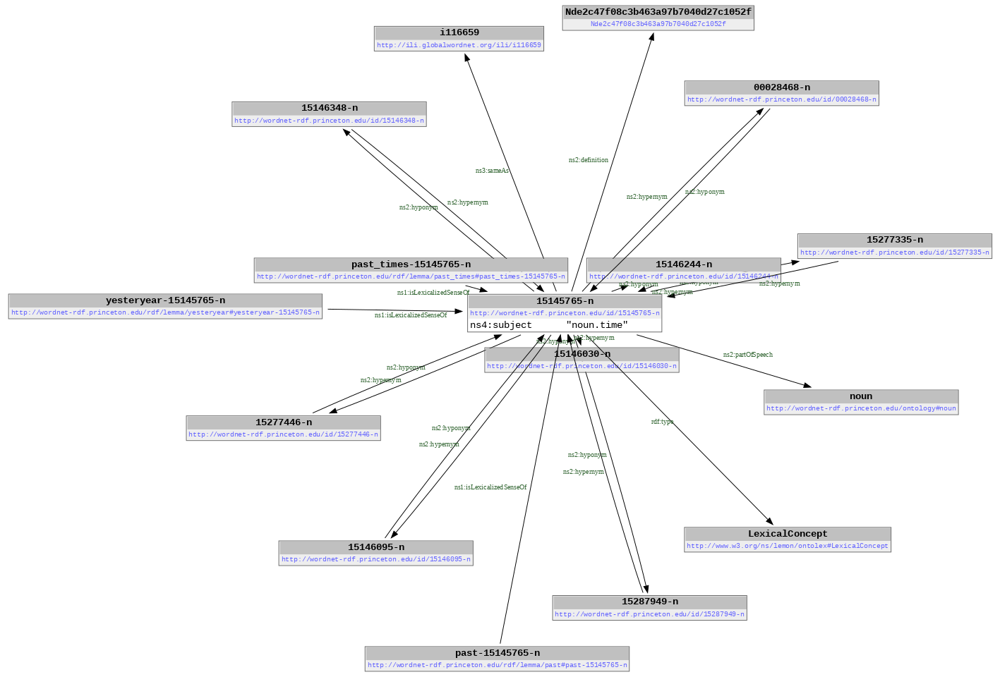

In [ ]:
rdf_sub_graph = extract_triplets(wn_id = "15145765-n", g_rdf = g_rdf)
visualize_rdf(rdf_sub_graph)

**A SPARQL query to extract specfic triples**

Remark the difference in results between a CONSTRUCT and a SELECT query:

In [ ]:
qq_construct ="""
        PREFIX ontolex: <http://www.w3.org/ns/lemon/ontolex#> 
        PREFIX rdf: <http://www.w3.org/1999/02/22-rdf-syntax-ns#>
        PREFIX rdfs: <http://www.w3.org/2000/01/rdf-schema#> 
        PREFIX purl: <http://purl.org/dc/terms/>
        PREFIX wn: <http://wordnet-rdf.princeton.edu/ontology#> 
        PREFIX wnid: <http://wordnet-rdf.princeton.edu/id/> 

        CONSTRUCT {
            ?top wn:hypernym ?hypernym;
                 wn:hyponym ?hyponym;
                 wn:mero_member ?mero_member;
                 purl:subject ?topic.
        }
        WHERE {
            VALUES ?top  { wnid:15145765-n } 
            ?top rdf:type ontolex:LexicalConcept;
                    wn:partOfSpeech wn:noun;
                    purl:subject ?topic.

            OPTIONAL { ?top wn:hypernym ?hypernym.}
            OPTIONAL { ?top wn:hyponym ?hyponym.}   
            OPTIONAL { ?top wn:mero_member ?mero_member.}                  
        }
    """ 

g_qres_construct = g_rdf.query(qq_construct)

print(type(g_qres_construct))
print(len(g_qres_construct))
utility_dir(g_qres_construct)
print("--------------------------------------------------")
print(type(g_qres_construct.graph))
utility_dir(g_qres_construct.graph)


<class 'rdflib.plugins.sparql.processor.SPARQLResult'>
9
askAnswer  bindings  graph  parse  serialize  type  vars

--------------------------------------------------
<class 'rdflib.graph.Graph'>
absolutize          add         addN               all_nodes          base                bind                 close
collection          comment     commit             compute_qname      connected           context_aware        de_skolemize
default_union       destroy     formula_aware      identifier         isomorphic          items                label
load                n3          namespace_manager  namespaces         objects             open                 parse
predicate_objects   predicates  preferredLabel     qname              query               remove               resource
rollback            seq         serialize          set                skolemize           store                subject_objects
subject_predicates  subjects    toPython           transitiveClosure  transitive_ob

In [ ]:
if g_qres_construct.bindings is None:
    print("NULL")
else:
    print(g_qres_construct.bindings)

NULL


In [ ]:
g_qres_construct.graph

<Graph identifier=N21e020e4b48544708513fe4db16123d2 (<class 'rdflib.graph.Graph'>)>

Visualization with:  dot


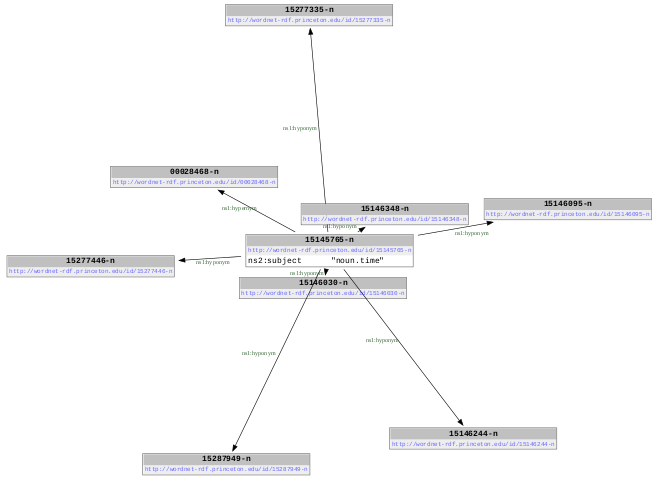

In [ ]:
visualize_rdf(g_qres_construct.graph, dgsize = '"10,5!"')

In [ ]:
qq_select ="""
        PREFIX ontolex: <http://www.w3.org/ns/lemon/ontolex#> 
        PREFIX rdf: <http://www.w3.org/1999/02/22-rdf-syntax-ns#>
        PREFIX rdfs: <http://www.w3.org/2000/01/rdf-schema#> 
        PREFIX purl: <http://purl.org/dc/terms/>
        PREFIX wn: <http://wordnet-rdf.princeton.edu/ontology#> 
        PREFIX wnid: <http://wordnet-rdf.princeton.edu/id/> 

        SELECT DISTINCT *
        WHERE {
            VALUES ?top  { wnid:15145765-n } 
            ?top rdf:type ontolex:LexicalConcept;
                    wn:partOfSpeech wn:noun;
                    purl:subject ?topic.

            OPTIONAL { ?top wn:hypernym ?hypernym.}
            OPTIONAL { ?top wn:hyponym ?hyponym.} 
            OPTIONAL { ?top wn:mero_member ?mero_member.}                     
        }
    """ 

g_qres_select = g_rdf.query(qq_select)

print(type(g_qres_select))
print(len(g_qres_select))
utility_dir(g_qres_select)

<class 'rdflib.plugins.sparql.processor.SPARQLResult'>
7
askAnswer  bindings  graph  parse  serialize  type  vars



In [ ]:
g_qres_select.bindings

[{rdflib.term.Variable('top'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/15145765-n'), rdflib.term.Variable('topic'): rdflib.term.Literal('noun.time'), rdflib.term.Variable('hypernym'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/00028468-n'), rdflib.term.Variable('hyponym'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/15146030-n')},
 {rdflib.term.Variable('top'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/15145765-n'), rdflib.term.Variable('topic'): rdflib.term.Literal('noun.time'), rdflib.term.Variable('hypernym'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/00028468-n'), rdflib.term.Variable('hyponym'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/15146244-n')},
 {rdflib.term.Variable('top'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/15145765-n'), rdflib.term.Variable('topic'): rdflib.term.Literal('noun.time'), rdflib.term.Variable('hypernym'): rdflib.term.URIRef('http://wordnet-rdf.princeton.edu

In [ ]:
if g_qres_select.graph is None:
    print("NULL")

NULL


### SPARQL query to select RDF subgraph concerning nouns

Note: we drop namespaces, to simplify the NetworkX graph that will be created at the next stage

In [ ]:
qq_nouns ="""
        PREFIX ontolex: <http://www.w3.org/ns/lemon/ontolex#> 
        PREFIX rdf: <http://www.w3.org/1999/02/22-rdf-syntax-ns#>
        PREFIX rdfs: <http://www.w3.org/2000/01/rdf-schema#> 
        PREFIX purl: <http://purl.org/dc/terms/>
        PREFIX wn: <http://wordnet-rdf.princeton.edu/ontology#> 
        PREFIX wnid: <http://wordnet-rdf.princeton.edu/id/> 
        PREFIX none: <>

        CONSTRUCT {
            ?top none:hypernym ?hypernym;
                 none:hyponym ?hyponym;
                 none:instance_hyponym ?instance_hypo;
                 none:instance_hypernym ?instance_hyper;
                 none:mero_member ?mero_member;
                 none:mero_part ?mero_part;
                 none:mero_substance ?mero_substance;
                 none:holo_member ?holo_member;
                 none:holo_part ?holo_part;
                 none:holo_substance ?holo_substance;
                 none:domain_topic ?domain;
                 none:subject ?topic;
                 none:lem ?lem.
        }
        WHERE {

            ?top rdf:type ontolex:LexicalConcept;
                    wn:partOfSpeech wn:noun.

            ?top_sense ontolex:isLexicalizedSenseOf ?top.
            ?top_entry ontolex:sense ?top_sense;
                       ontolex:canonicalForm [ ontolex:writtenRep ?lem].

            OPTIONAL { ?top wn:hypernym ?hypernym.}
            OPTIONAL { ?top wn:hyponym ?hyponym.}
            OPTIONAL { ?top wn:instance_hyponym ?instance_hypo.}
            OPTIONAL { ?top wn:instance_hypernym ?instance_hyper.}  

            OPTIONAL { ?top wn:mero_member ?mero_member.}
            OPTIONAL { ?top wn:mero_part ?mero_part.}
            OPTIONAL { ?top wn:mero_substance ?mero_substance.}
            OPTIONAL { ?top wn:holo_member ?holo_member.}
            OPTIONAL { ?top wn:holo_part ?holo_part.}
            OPTIONAL { ?top wn:holo_substance ?holo_substance.}

            OPTIONAL { ?top wn:domain_topic ?domain.}
            OPTIONAL { ?top purl:subject ?topic.}
                     
        }
    """ 

In [ ]:
%%time

g_qres_nouns = g_rdf.query(qq_nouns)
print(len(g_qres_nouns))

446401
CPU times: user 28min 32s, sys: 5.22 s, total: 28min 37s
Wall time: 28min 45s


Visualization with:  dot


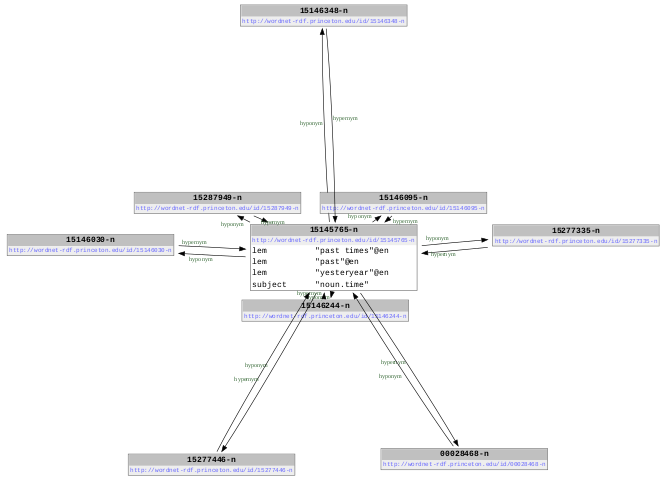

In [ ]:
rdf_sub_graph = extract_triplets(wn_id = "15145765-n", g_rdf = g_qres_nouns.graph)
visualize_rdf(rdf_sub_graph, dgsize = '"10,5!"')

### Export into a NetworkX graph

Note: by default, the conversion doesn't store properties on nodes

In [ ]:
%%time
g_nx_nouns = rdflib_to_networkx_graph(g_qres_nouns)

CPU times: user 12.8 s, sys: 831 ms, total: 13.6 s
Wall time: 13.6 s


In [ ]:
#example node in graph
list(g_nx_nouns.nodes(data=True))[0]

(rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/08716193-n'), {})

In [ ]:
#example edge in graph
[e for e in list(g_nx_nouns.edges(data=True))][0]

(rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/08716193-n'),
 rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/09189894-n'),
 {'triples': [(rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/08716193-n'),
    rdflib.term.URIRef('instance_hyponym'),
    rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/09189894-n')),
   (rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/09189894-n'),
    rdflib.term.URIRef('instance_hypernym'),
    rdflib.term.URIRef('http://wordnet-rdf.princeton.edu/id/08716193-n'))],
  'weight': 2})

We create a custom export function instead:

In [ ]:
def export_rdf_to_networkx(g_qres_nouns):
    g_nx_nouns = nx.DiGraph()

    ii = 0
    for s,p,o in g_qres_nouns.graph:
        src = str(s).split("/")[-1]
        if isinstance(o, URIRef):
            dst = str(o).split("/")[-1]
            edge_label = str(p)
            if ii == 0:
                print(src," || ", dst, " || ", edge_label)

            g_nx_nouns.add_edge(src, dst, label=edge_label)
            ii += 1
        
        
    #now add attrib on nodes
    for s,p,o in g_qres_nouns.graph:
        src = str(s).split("/")[-1]
        if (str(p) == "lem") and (isinstance(o, Literal) is True):
            try:
                g_nx_nouns.nodes[src]["lemmas"] += str(o) + '|'
            except:
                try:
                    g_nx_nouns.nodes[src]["lemmas"] = str(o) + '|'
                except:
                    pass
        
        if (str(p) == "subject") and (isinstance(o, Literal) is True):
            try:
                g_nx_nouns.nodes[src]["topic"] = str(o) 
            except:
                pass

    return g_nx_nouns

In [ ]:
%%time
g_nx_nouns = export_rdf_to_networkx(g_qres_nouns)

08716193-n  ||  09189894-n  ||  instance_hyponym
CPU times: user 7.38 s, sys: 391 ms, total: 7.77 s
Wall time: 7.81 s


In [ ]:
print("Number of nodes:", len(g_nx_nouns.nodes()))
print("Number of edges:", len(g_nx_nouns.edges()))

Number of nodes: 82192
Number of edges: 217614


In [ ]:
#example of a node
list(g_nx_nouns.nodes(data=True))[2]

('04832208-n', {'lemmas': 'implicitness|', 'topic': 'noun.attribute'})

In [ ]:
#example of an edge
[e for e in list(g_nx_nouns.edges(data=True))][0]

('08716193-n', '09189894-n', {'label': 'instance_hyponym'})

----------------

## Load dataframe from pickle file

In [ ]:
#note we need to register again the extensions 

try:
    Token.set_extension("SRL", default=dict())
    Token.set_extension("COREF_TARGET", default=-1)
    Token.set_extension("IS_NEG", default=False)
    Token.set_extension("WSD_WN31_ID_SEMCOR", default="-")
    Token.set_extension("WSD_WN31_ID_TOMATIC", default="-")
    Token.set_extension("WSD_INDICES_SEMCOR", default=[])
    Token.set_extension("WSD_INDICES_TOMATIC", default=[])
    Token.set_extension("WSD_WN31_ID_EXT", default="-")
    Token.set_extension("WSD_INDICES_EXT", default=[])

    Token.set_extension("WSD_CHOSEN_SENSE", default={})

    Token.set_extension('plot', default={}) 
except:
    pass

In [ ]:
df_proverbs = pd.read_pickle("/content/gdrive/My Drive/proverbs/df_proverbs.pkl")
df_proverbs.memory_usage(deep = True, index=True).sum()

438430

In [ ]:
df_proverbs.head()

,idx,translated,original,lang,author,key,validation,seqno,id,doc
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"(Breaking, the, watch, does, not, stop, the, fleeting, time, .)"
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"(Time, and, hours, do, not, wait, .)"
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,"(Lost, time, is, never, regained, .)"
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"(No, man, is, rich, enough, to, buy, back, his, past, .)"
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,"(The, day, that, has, passed, ,, one, does, not, get, back, .)"


In [ ]:
class DocHelper:

    def __init__(self, doc):
        self.doc = doc

    def display_tree(self,):
                
        #customize plot to highlight numbers, verbs and proper names
        for token in self.doc:
            node_label = '{0}  [{1}] \n {2} / {3}'.format(token.text, token.i, 
                                                        token.pos_, token.dep_)
            token._.plot['label'] = node_label
            if token.pos_ in ["PUNCT", "DET", "ADP"]:
                token._.plot["color"] = "lightgray" 
            elif token.pos_ == "NOUN":
                token._.plot["color"] = "orange"
            elif token.pos_ in ["VERB", "AUX"]:
                token._.plot["color"] = "blue"
            else:
                token._.plot["color"] = "black" 
                
        png_tree = visualise_spacy_tree.create_png(self.doc)
        display(Image(png_tree))


    def tabular_doc_summary(self,):
        
        list_pipeline = []
        for tok in  self.doc:
            list_pipeline.append((tok.i, tok.text, tok.lemma_, tok.tag_, tok.pos_, tok.dep_, tok.head, tok.morph, 
                                tok.is_stop, tok.is_punct, tok.is_digit, tok.is_oov, tok.ent_iob_, tok.ent_type_,
                                '\n'.join(textwrap.wrap(json.dumps(tok._.SRL), width = 40)), tok._.COREF_TARGET,
                                tok._.IS_NEG,
                                tok._.WSD_WN31_ID_SEMCOR, tok._.WSD_WN31_ID_TOMATIC, tok._.WSD_WN31_ID_EXT,
                                tok._.WSD_INDICES_SEMCOR, tok._.WSD_INDICES_TOMATIC, tok._.WSD_INDICES_EXT))
            

        print(tabulate(list_pipeline, tablefmt="fancy_grid",
                    headers=["i", "text", "lemma", "tag", "pos", "dep", "head", "morph", "stopword", "punctuation", "digit", "oov", "iob", "ent",
                             "SRL", "COREF", "IS_NEG", 
                            "WSD_ID_SEMCOR", "WSD_ID_TOMATIC", "WSD_ID_EXT",
                            "WSD_INDICES_SEMCOR", "WSD_INDICES_TOMATIC", "WSD_INDICES_EXT"]))

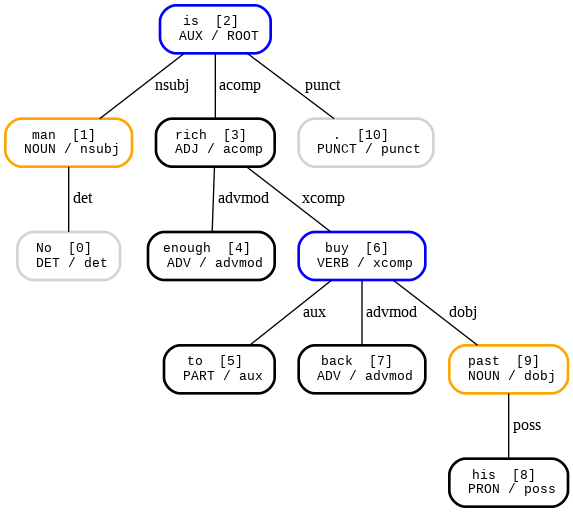

In [ ]:
dh =  DocHelper(df_proverbs.loc[3]["doc"])
dh.display_tree()

In [ ]:
dh.tabular_doc_summary()

╒═════╤════════╤═════════╤═══════╤═══════╤════════╤════════╤════════════════════════════════════════════════════════╤════════════╤═══════════════╤═════════╤═══════╤═══════╤═══════╤════════════════════════════════════════╤═════════╤══════════╤═════════════════╤══════════════════╤══════════════╤══════════════════════╤═══════════════════════╤═══════════════════╕
│   i │ text   │ lemma   │ tag   │ pos   │ dep    │ head   │ morph                                                  │ stopword   │ punctuation   │ digit   │ oov   │ iob   │ ent   │ SRL                                    │   COREF │ IS_NEG   │ WSD_ID_SEMCOR   │ WSD_ID_TOMATIC   │ WSD_ID_EXT   │ WSD_INDICES_SEMCOR   │ WSD_INDICES_TOMATIC   │ WSD_INDICES_EXT   │
╞═════╪════════╪═════════╪═══════╪═══════╪════════╪════════╪════════════════════════════════════════════════════════╪════════════╪═══════════════╪═════════╪═══════╪═══════╪═══════╪════════════════════════════════════════╪═════════╪══════════╪═════════════════╪════════════════

---------------------------

## Checking the brevity of proverbs 

A characteristic of proverbs is usually their brevity and their words' simplicity. For the latter, we count syllables in the original language of the proverbs for top 5 languages by proverbs counts.

Counts by language of origin:

In [ ]:
list_lang = list(df_proverbs["lang"].values)
count_lang = coll.Counter(list_lang)
count_lang.most_common(n = 10)

[('it', 126),
 ('de', 121),
 ('en', 110),
 ('fr', 89),
 ('ro', 55),
 ('nl', 34),
 ('sv', 31),
 ('dk', 22),
 ('he', 10),
 ('ru', 8)]

### Counting number of words per proverb

In [ ]:
nlp_multilang = {
    "en" : spacy.load("en_core_web_sm", disable = ['ner']),
    "fr" : spacy.load("fr_core_news_sm", disable = ['ner']),
    "de" :  spacy.load("de_core_news_sm", disable = ['ner']),
    "it" :  spacy.load("it_core_news_sm", disable = ['ner']),
    "ro" :  spacy.load("ro_core_news_sm", disable = ['ner'])
}

In [ ]:
%%time
df_proverbs["doc_orig"] = df_proverbs[["original", "lang"]].apply(lambda x: nlp_multilang.get(x[1])(x[0]) if x[1] in nlp_multilang else None, axis = 1)


CPU times: user 2.7 s, sys: 26 ms, total: 2.73 s
Wall time: 2.81 s


In [ ]:
def sns_barplot_from_counter(the_counter, ax = None, labels_dict = None, min_x = 2, max_x = 22):
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize = (10,7))

    for ii in range(min_x, max_x):
        if ii not in the_counter:
            the_counter[ii] = 0

    sns.barplot(x=list(the_counter.keys()), y=list(the_counter.values()), ax= ax, color="darkgray")
    ax.set_ylabel(labels_dict.get("ylabel"))
    ax.set_xlabel(labels_dict.get("xlabel"))
    ax.set_title(labels_dict.get("title").upper())




def visualize_barplot_numwords(translated = False, lang = None, ax = None):

    if translated is True:
        list_docs = list(df_proverbs["doc"].values)
    else:
        if lang in nlp_multilang:
            df_aux = df_proverbs[(df_proverbs["lang"] == lang)&(df_proverbs["original"].str.len() > 5)]
            list_docs = list(df_aux["doc_orig"].values)
        else:
            print("not supported yet")
            return

    list_proverbs_lengths = [sum([1 for tok in doc if tok.pos_ != "PUNCT"]) for doc in list_docs]

    count1 = coll.Counter(list_proverbs_lengths) 
    print(lang, " ||| ", count1)

    ssum = sum(count1.values())
    count1_perc = coll.Counter({k: round(v/ssum, 2) for k,v in count1.items()}) 

    #coalesce effect in (lang or "TRANSLATED"), i.e. take the first non-null value
    fig_labels = {"ylabel" : "Number of proverbs",
                  "xlabel" : "Number of words per proverb",
                  "title" : lang or "TRANSLATED"}
    sns_barplot_from_counter(the_counter = count1_perc, ax= ax,
                             labels_dict = fig_labels)



None  |||  Counter({7: 104, 8: 88, 9: 87, 6: 73, 10: 64, 11: 49, 5: 44, 12: 37, 14: 29, 13: 25, 16: 15, 4: 14, 15: 10, 3: 6, 17: 5, 18: 4, 2: 2, 19: 2, 21: 1})


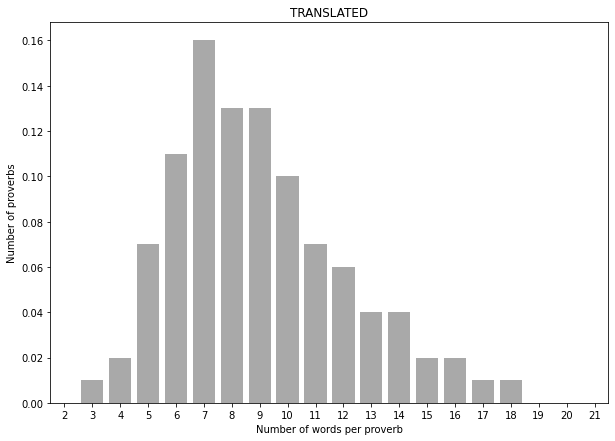

In [ ]:
visualize_barplot_numwords(translated = True)

en  |||  Counter({6: 21, 7: 19, 8: 13, 9: 13, 5: 9, 10: 7, 4: 6, 16: 4, 12: 4, 14: 3, 11: 3, 3: 2, 21: 1, 2: 1, 13: 1, 18: 1, 15: 1})
fr  |||  Counter({9: 16, 8: 14, 7: 12, 5: 11, 12: 8, 10: 6, 6: 6, 11: 5, 15: 3, 13: 3, 4: 2, 14: 2, 19: 1})
de  |||  Counter({8: 18, 7: 15, 10: 14, 9: 14, 5: 12, 11: 9, 6: 9, 12: 8, 14: 5, 13: 4, 4: 2, 15: 2, 16: 2, 19: 1, 3: 1, 20: 1, 17: 1, 21: 1, 18: 1})
it  |||  Counter({7: 25, 5: 21, 9: 20, 6: 18, 8: 14, 10: 13, 11: 4, 12: 3, 13: 3, 4: 2, 15: 1, 3: 1, 17: 1})
ro  |||  Counter({5: 14, 6: 8, 7: 6, 10: 5, 8: 5, 4: 3, 9: 3, 11: 3, 15: 2, 13: 2, 12: 1, 19: 1, 14: 1, 3: 1})


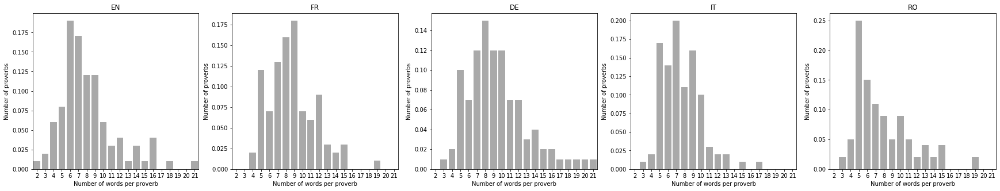

In [ ]:
fig, ax = plt.subplots(1, 5, figsize = (30,5))
visualize_barplot_numwords(lang = "en", ax = ax[0])
visualize_barplot_numwords(lang = "fr", ax = ax[1])
visualize_barplot_numwords(lang = "de", ax = ax[2])
visualize_barplot_numwords(lang = "it", ax = ax[3])
visualize_barplot_numwords(lang = "ro", ax = ax[4])

### Counting the number of syllables per word

In [ ]:
syllabeler_multilang = \
    { "en" : Hyphenator('en_US'),
      "fr" : Hyphenator('fr_FR'),
      "it" : Hyphenator('it_IT'),
      "de" : Hyphenator('de_DE'),
      "ro" : Hyphenator('ro_RO')
    }

In [ ]:
top5_lang = [el[0] for el in count_lang.most_common(n = 5)]
print(top5_lang)

dict_sylab_by_lang = {k: [] for k in top5_lang}
dict_sylab_by_lang

['it', 'de', 'en', 'fr', 'ro']


{'de': [], 'en': [], 'fr': [], 'it': [], 'ro': []}

In [ ]:
%%time

dict_words_by_numsylab = {}

for i, row in df_proverbs.iterrows():
    doc = row["doc_orig"]

    if (row["lang"] in top5_lang) and len(row["original"]) > 5:
        for tok in doc:
            if (tok.pos_ != "PUNCT") and (tok.is_stop is False):

                num_syll = len( syllabeler_multilang.get(row["lang"]).syllables(tok.text))
                dict_sylab_by_lang[row["lang"]].append(num_syll)                

                s_aux = str(tok.text).lower() + "|" + row["lang"]
                if num_syll in dict_words_by_numsylab:
                    #in the dict we keep a set (without repetitions) of words foir each number of syllabels
                    dict_words_by_numsylab[num_syll] |= set([ s_aux ])
                else:
                    dict_words_by_numsylab[num_syll] = set([ s_aux ])
            
   

CPU times: user 137 ms, sys: 997 µs, total: 138 ms
Wall time: 139 ms


In [ ]:
max_num_syl = max(list(dict_words_by_numsylab.keys()))
print("max number of sylables:", max_num_syl)
print("examples words with largest number of syllables:", dict_words_by_numsylab[max_num_syl], "\n")

print("---------------------------------------------------------------------")
print("\n examples words with second largest number of sylables: \n")
utility_print_lists_columnized( sorted(list(dict_words_by_numsylab[max_num_syl - 1])) , num_cols_columnize=8)

print("---------------------------------------------------------------------")
print("\n examples words with third largest number of sylables: \n")
utility_print_lists_columnized( sorted(list(dict_words_by_numsylab[max_num_syl - 2])) , num_cols_columnize=8)


max number of sylables: 6
examples words with largest number of syllables: {'personalitate|ro'} 

---------------------------------------------------------------------

 examples words with second largest number of sylables: 

accompagnati|it  addormentare|it  anticipată|ro  deopotrivă|ro   dimenticare|it  dușmanului|ro   généralement|fr     haushälterinnen|de
illimitata|it    interiorul|ro    lavoratore|it  prietenului|ro  reputazione|it  superficial|ro  zusammenbringen|de
---------------------------------------------------------------------

 examples words with third largest number of sylables: 

adulatore|it    affezione|it       affondare|it    apparenze|it   arboscello|it    badehose|de      bastimento|it    bunatatea|ro
buturuga|ro     campanile|it       capitano|it     castigate|it   cavaliere|it     comandare|it     compromisuri|ro  conservare|it
consigliato|it  contentare|it      copilărie|ro    dominare|it    dușmănia|ro      evangelium|de    felicità|it      frecventeaza|ro

In [ ]:
#note: words with 0 syllables
utility_print_lists_columnized(list(dict_words_by_numsylab[0]) , num_cols_columnize=20)

l'|it   e|en    ami|fr  d'|it   arm|de  rat|de  ciò|it  pan|en  man|en  aff|de  neu|de  bob|ro  nid|fr  -mi|ro  nt|en   om|ro   ce|it   hop|ro  art|de  son|it
-i|ro   x|de    ehe|de  -ți|ro  set|en  uva|it  ear|en  sow|en  err|en  son|en  un'|it  n-|ro   pot|en  or|fr   ou|ro   mur|fr  run|en  vai|it  bun|ro  u|de
rea|ro  ami|it  new|en  -il|fr  -ţi|ro  lot|en  ti-|ro  val|it  vol|fr  old|en  ll|fr   oro|it  egg|en  puț|ro  use|en  fan|ro  bad|en  -l|ro   |fr     sa|it
ver|it  feu|fr  y|fr    far|en  fan|it  e|it    rau|ro  dir|it  bit|en  lob|de  tor|de  wit|en  owl|en  cer|ro  aur|ro  è|en    ape|en  säß|de  ama|it  s'|it
buy|en  -te|ro  c'|it   cai|ro  apă|ro  ehr|de  fir|ro  eye|en  oul|ro  mer|fr  eau|fr  è|it    bou|ro  wo|en   îşi|ro  mal|it  try|en  lac|ro  dog|en  dà|it
vin|fr  i|it    mal|fr  păr|ro  da|en   mar|it  né|fr   pot|fr  ´|de    sac|fr  nod|ro  ei|de   tut|de  tas|fr


en  ||| Counter({1: 263, 2: 92, 0: 49, 3: 13, 4: 1})
fr  ||| Counter({1: 171, 2: 123, 0: 23, 3: 19, 5: 1})
it  ||| Counter({2: 225, 3: 146, 0: 81, 4: 28, 1: 19, 5: 6})
de  ||| Counter({2: 232, 1: 147, 3: 62, 0: 20, 4: 12, 5: 2})
ro  ||| Counter({2: 88, 3: 65, 0: 36, 4: 22, 1: 20, 5: 6, 6: 1})


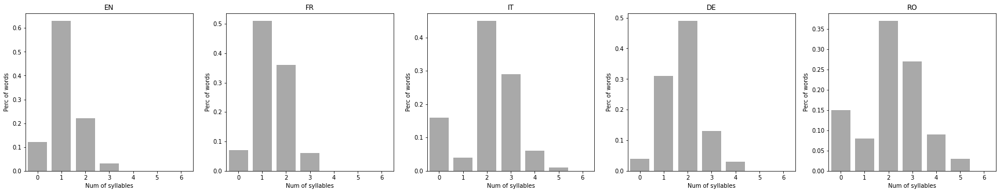

In [ ]:
fig, ax = plt.subplots(1, 5, figsize = (30,5))

ii = 0
for lang in syllabeler_multilang:
    count1 = coll.Counter(dict_sylab_by_lang[lang]) 
    print(lang, " |||", count1)

    ssum = sum(count1.values())
    count1_perc = coll.Counter({k: round(v/ssum, 2) for k,v in count1.items()}) 

    for jj in range(0, 7):
        if jj not in count1_perc:
            count1_perc[jj] = 0.0

    sns.barplot(x=list(count1_perc.keys()), y=list(count1_perc.values()), ax= ax[ii], color="darkgray")
    ax[ii].set_title(lang.upper())
    ax[ii].set_xlabel("Num of syllables")
    ax[ii].set_ylabel("Perc of words")
    ii += 1

In [ ]:
#extract rows containing proverbs with a specified long word
df_proverbs[df_proverbs["original"].str.contains("Gelegenheit")]

,idx,translated,original,lang,author,key,validation,seqno,id,doc,doc_orig
181,181,Whoever has one opportunity should not wait for the other.,"Wer eine Gelegenheit hat, soll auf die andre nicht warten.",de,,group12,1.0,11,12_11,"(Whoever, has, one, opportunity, should, not, wait, for, the, other, .)","(Wer, eine, Gelegenheit, hat, ,, soll, auf, die, andre, nicht, warten, .)"


------------

## Term - document matrix


### Prepare corpus based on lemmas 

Basically we adopt here a bag-of-words document representation, that doesn't account for the word order, but only for presence of term in document. We use only selected parts of speech for this demo.

In [ ]:
df_proverbs_cpy = df_proverbs[["translated", "doc"]]

df_proverbs_cpy["nouns_lemmas"] = df_proverbs_cpy["doc"].apply(lambda x: [tok.lemma_ for tok in x if tok.pos_ == "NOUN"])
df_proverbs_cpy["verbs_lemmas"] = df_proverbs_cpy["doc"].apply(lambda x: [tok.lemma_ for tok in x if tok.pos_ == "VERB"])
df_proverbs_cpy["adj_lemmas"] = df_proverbs_cpy["doc"].apply(lambda x: [tok.lemma_ for tok in x if tok.pos_ == "ADJ"])

In [ ]:
#on each dataframe row, concat the lists of lemmatized nouns,adj,verbs and adverbs

df_proverbs_cpy["bow"] = df_proverbs_cpy[["nouns_lemmas","verbs_lemmas", "adj_lemmas"]].apply(lambda x: list(itertools.chain(x[0],x[1],x[2])), axis=1)
df_proverbs_cpy.iloc[3]

translated      No man is rich enough to buy back his past.             
doc             (No, man, is, rich, enough, to, buy, back, his, past, .)
nouns_lemmas    [man, past]                                             
verbs_lemmas    [buy]                                                   
adj_lemmas      [rich]                                                  
bow             [man, past, buy, rich]                                  
Name: 3, dtype: object

In [ ]:
all_bow_lol = list(df_proverbs_cpy["bow"].values)
all_bow_lol[0:5]

[['watch', 'time', 'break', 'stop', 'fleeting'],
 ['time', 'hour', 'wait'],
 ['time', 'lose', 'regain'],
 ['man', 'past', 'buy', 'rich'],
 ['day', 'pass', 'get']]

In building the dictionary, the words are assigned ids as follows:

each list in the list-of-lists is sorted :

`['watch', 'time', 'break', 'stop', 'fleeting']  -- > ['break', 'fleeting', 'stop', 'time', 'watch']` 

Then, each word is evaluated whether it's first occurring (case in whiich next id from seq is assigned) or if it already was registered

break -> 0, fleeting -> 1 , stop -> 2, time -> 3, watch -> 4,   
hour -> 5, time (already assined),  wait -> 6,   
etc....


In [ ]:
gs_dictionary = corpora.Dictionary(all_bow_lol)

#token2id is a dict mapping  word --> id, e.g. for "time":
for ww in ['watch', 'time', 'break', 'stop', 'fleeting']:
    print("id of {} is: {}".format( str(ww).ljust(10), gs_dictionary.token2id[ww]))


id of watch      is: 4
id of time       is: 3
id of break      is: 0
id of stop       is: 2
id of fleeting   is: 1


In [ ]:
#note: the reverse is simply gs_dictionary[3],no need to use id2token
assert(gs_dictionary[gs_dictionary.token2id["time"]] == "time")

In [ ]:
#the gs_corpus contains for each proverb, for each word an entry (tokid,num_occurencies)
gs_corpus = [gs_dictionary.doc2bow(text) for text in all_bow_lol]
gs_corpus[0:5]

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1)],
 [(3, 1), (5, 1), (6, 1)],
 [(3, 1), (7, 1), (8, 1)],
 [(9, 1), (10, 1), (11, 1), (12, 1)],
 [(13, 1), (14, 1), (15, 1)]]

### Inverted index  (aka term-document matrix)

Its shape is VOCAB_SIZE x NUM_PROVERBS

In [ ]:
#convert to dense numpy array
gs_corpus_arr = matutils.corpus2dense(gs_corpus, num_terms = 1100)
print(type(gs_corpus_arr), gs_corpus_arr.shape)

print("----------------------------------------------------------")
with np.printoptions(edgeitems=5):
    print(gs_corpus_arr[0:20])

<class 'numpy.ndarray'> (1100, 659)
----------------------------------------------------------
[[1. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [1. 1. 1. 0. 0. ... 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 ...
 [0. 0. 0. 0. 1. ... 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. ... 0. 0. 0. 0. 0.]]


Remark the 4th line, corresponding to "time" which has 1 for first 3 proverbs, yet in the 4th and 5th proverbs it is absent.

In [ ]:
def extract_proverbs_containing_word(searched_word, debug_flag = False):

    #use get, maybe word not in selected 1000
    word_id = gs_dictionary.token2id.get(searched_word)
    df_result = None

    if word_id is not None:
        #query the index for all proverbs containing searched_word => it's enough to get positions on iith row where value != 0
        proverbs_idx = np.nonzero(gs_corpus_arr[word_id])
        if debug_flag is True:
            print("Proverbs that contain '{}' (id = {}) :".format(searched_word, word_id), proverbs_idx)
            print("----------------------------------------------------------")

        df_result = df_proverbs_cpy.iloc[proverbs_idx][["translated"]]

    return df_result

In [ ]:
df_result = extract_proverbs_containing_word(searched_word = "horse", debug_flag = True)

with pd.option_context('display.max_colwidth', -1):
    print(df_result)

Proverbs that contain 'horse' (id = 32) : (array([ 11,  18, 158, 191, 215, 226, 243, 278, 521, 551]),)
----------------------------------------------------------
                                                                       translated
11   If luck comes as a horse, then don't be too lazy to ride it.                
18   Time is not tied to a post, like a horse to the manger.                     
159  Make a horse out of a mosquito.                                             
192  If the rider is not capable, the horse is to blame.                         
216  It's wrong to judge the horse by its saddle.                                
227  Horse does not make a rider.                                                
244  A golden saddle is worth a lot, but it doesn't make a horse out of a donkey.
279  A good horse does not need to be trotted.                                   
524  You cannot ride two horses at once.                                         
554  To run after 

In [ ]:
df_result = extract_proverbs_containing_word(searched_word = "drop", debug_flag = True)

with pd.option_context('display.max_colwidth', -1):
    print(df_result)

Proverbs that contain 'drop' (id = 76) : (array([ 28,  43, 302, 349, 354, 357, 576]),)
----------------------------------------------------------
                                       translated
28   The sea is made drop by drop.               
43   The heaviest rain starts with drops.        
304  From the rain into the drop.                
351  A pot of milk is ruined by a drop of poison.
356  The drop shall hollow out the rock.         
359  A drop of honey does treat a sea of gall.   
580  The drop that made the bucket to overflow.  


In [ ]:
df_result = extract_proverbs_containing_word(searched_word = "branch", debug_flag = True)

with pd.option_context('display.max_colwidth', -1):
    print(df_result)

Proverbs that contain 'branch' (id = 229) : (array([100, 175, 182, 452, 580]),)
----------------------------------------------------------
                                                      translated
100  The branch does not go far from the trunk.                 
176  Better finch in the pocket than thrush in the branches.    
183  Better one hazel grouse in the bag, than ten on the branch.
455  The fallen blossoms don't return to branch.                
584  Overloaded tree branches break off.                        


-------------------

## Choose the word sense to use

Recall we had 3 methods that gave sense disambiguation on tokens/ groups of tokens and these methods often had disagreements between their results

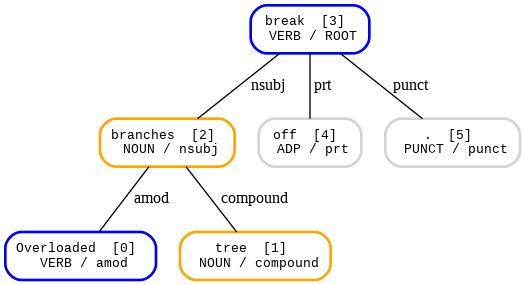

╒═════╤════════════╤══════════╤═══════╤═══════╤══════════╤══════════╤══════════════════════════════════════╤════════════╤═══════════════╤═════════╤═══════╤═══════╤═══════╤═══════════════════════════════╤═════════╤══════════╤═════════════════╤══════════════════╤══════════════╤══════════════════════╤═══════════════════════╤═══════════════════╕
│   i │ text       │ lemma    │ tag   │ pos   │ dep      │ head     │ morph                                │ stopword   │ punctuation   │ digit   │ oov   │ iob   │ ent   │ SRL                           │   COREF │ IS_NEG   │ WSD_ID_SEMCOR   │ WSD_ID_TOMATIC   │ WSD_ID_EXT   │ WSD_INDICES_SEMCOR   │ WSD_INDICES_TOMATIC   │ WSD_INDICES_EXT   │
╞═════╪════════════╪══════════╪═══════╪═══════╪══════════╪══════════╪══════════════════════════════════════╪════════════╪═══════════════╪═════════╪═══════╪═══════╪═══════╪═══════════════════════════════╪═════════╪══════════╪═════════════════╪══════════════════╪══════════════╪══════════════════════╪═════════════

In [ ]:
dh =  DocHelper(df_proverbs.loc[584]["doc"])
dh.display_tree()
dh.tabular_doc_summary()

In [ ]:
#how it works, note: the interval upper bound must be 1 + bound in list in table above
t = IntervalTree()
t[1:2] = ("13124818-n", "SEMCOR")
t[1:2] = ("13124818-n", "TOMATIC")
t[2:3] = ("13936864-n", "SEMCOR")
t[2:3] = ("13184148-n", "TOMATIC")
t[1:3] = ("13184701-n", "EXT")
t[3:5] = ("00363458-v", "SEMCOR")
t[3:5] = ("00363458-v", "EXT")

#query by point
print(sorted(t[2]))


[Interval(1, 3, ('13184701-n', 'EXT')), Interval(2, 3, ('13184148-n', 'TOMATIC')), Interval(2, 3, ('13936864-n', 'SEMCOR'))]


In [ ]:
def choose_wsd_sense(doc, debug_flag = False):
    """ of the 3 choices (SEMCOR, TRAIN-O-MATIC, EXT) decide upon one to use in the analytics"""

    dict_indices = {"EXT": [tok._.WSD_INDICES_EXT for tok in doc],
                    "TOMATIC" : [tok._.WSD_INDICES_TOMATIC for tok in doc],
                    "SEMCOR" :  [tok._.WSD_INDICES_SEMCOR for tok in doc]
    }
    if debug_flag is True:
        pp.pprint(dict_indices)
        print("-------------------------------------------------------------")

    #build the interval tree
    t = IntervalTree()
    for tok in doc:
        if (len(tok._.WSD_INDICES_SEMCOR) == 1) and (tok._.WSD_WN31_ID_SEMCOR != "-"):
            t[tok._.WSD_INDICES_SEMCOR[0]:tok._.WSD_INDICES_SEMCOR[0]+1] = (tok._.WSD_WN31_ID_SEMCOR, "SEMCOR")
        elif len(tok._.WSD_INDICES_SEMCOR) > 1:
            t[tok._.WSD_INDICES_SEMCOR[0]:tok._.WSD_INDICES_SEMCOR[-1]+1] = (tok._.WSD_WN31_ID_SEMCOR, "SEMCOR")    

        if (len(tok._.WSD_INDICES_TOMATIC) == 1) and (tok._.WSD_WN31_ID_TOMATIC != "-"):
            t[tok._.WSD_INDICES_TOMATIC[0]:tok._.WSD_INDICES_TOMATIC[0]+1] = (tok._.WSD_WN31_ID_TOMATIC, "TOMATIC")
        elif len(tok._.WSD_INDICES_TOMATIC) > 1:
            t[tok._.WSD_INDICES_TOMATIC[0]:tok._.WSD_INDICES_TOMATIC[-1]+1] = (tok._.WSD_WN31_ID_TOMATIC, "TOMATIC") 

        if (len(tok._.WSD_INDICES_EXT) == 1) and (tok._.WSD_WN31_ID_EXT != "-"):
            t[tok._.WSD_INDICES_EXT[0]:tok._.WSD_INDICES_EXT[0]+1] = (tok._.WSD_WN31_ID_EXT, "EXT")
        elif len(tok._.WSD_INDICES_EXT) > 1:
            t[tok._.WSD_INDICES_EXT[0]:tok._.WSD_INDICES_EXT[-1]+1] = (tok._.WSD_WN31_ID_EXT, "EXT") 

    #print(t)

    #query the tree
    for tok in doc:
        candidate_senses = sorted(t[tok.i], key = lambda x: (x.end - x.begin, x.data[1]), reverse = True)
        if len(candidate_senses) == 0:
            tok._.WSD_CHOSEN_SENSE = {}
        else:
            #try with first candidate 
            ii = 0                       
            if (candidate_senses[ii].data[0] == "-") and (len(candidate_senses) > 1):
                ii = 1
                
            word_expr = "_".join([doc[jj].lemma_.lower() for jj in  dict_indices[candidate_senses[ii].data[1]][tok.i] ])                

            if len(word_expr) > 0:
                tok._.WSD_CHOSEN_SENSE = {"wnid": candidate_senses[ii].data[0], 
                                          "pos" : str(candidate_senses[ii].data[0]).split("-")[-1],
                                          "word": word_expr
                                         }
            else:
               tok._.WSD_CHOSEN_SENSE = {} 

        if debug_flag is True:
            print(tok.text, " ||| ", candidate_senses, " --> ", tok._.WSD_CHOSEN_SENSE)


In [ ]:
choose_wsd_sense(df_proverbs.loc[584]["doc"], debug_flag=True)

{'EXT': [[], [1, 2], [], [3, 4], [], []], 'SEMCOR': [[0], [1], [2], [3, 4], [], [5]], 'TOMATIC': [[0], [1], [2], [3], [], [5]]}
-------------------------------------------------------------
Overloaded  |||  []  -->  {}
tree  |||  [Interval(1, 3, ('13184701-n', 'EXT')), Interval(1, 2, ('13124818-n', 'TOMATIC')), Interval(1, 2, ('13124818-n', 'SEMCOR'))]  -->  {'wnid': '13184701-n', 'pos': 'n', 'word': 'tree_branch'}
branches  |||  [Interval(1, 3, ('13184701-n', 'EXT')), Interval(2, 3, ('13184148-n', 'TOMATIC')), Interval(2, 3, ('13936864-n', 'SEMCOR'))]  -->  {}
break  |||  [Interval(3, 5, ('00363458-v', 'SEMCOR')), Interval(3, 5, ('00363458-v', 'EXT'))]  -->  {'wnid': '00363458-v', 'pos': 'v', 'word': 'break_off'}
off  |||  [Interval(3, 5, ('00363458-v', 'SEMCOR')), Interval(3, 5, ('00363458-v', 'EXT'))]  -->  {}
.  |||  []  -->  {}


In [ ]:
%%time

for i, row in df_proverbs.iterrows():
    choose_wsd_sense(row["doc"], debug_flag= False)

CPU times: user 633 ms, sys: 6.02 ms, total: 639 ms
Wall time: 645 ms


## Analysis of nouns used in proverbs

In [ ]:
df_proverbs["nouns"] = df_proverbs["doc"].apply(lambda x: [tok for tok in x if (tok._.WSD_CHOSEN_SENSE.get("pos") == "n") ])

df_proverbs["nouns_wn_ids"] = df_proverbs["nouns"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["wnid"] for tok in x]) 
df_proverbs["nouns_wn_words"] = df_proverbs["nouns"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["word"] for tok in x]) 


df_proverbs.drop(columns = ["doc", "doc_orig"]).head(5)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]"
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]"
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]"
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day]


Extract column values into list of lists

In [ ]:
#lol i.e. list of lists
all_nouns_lol = list(df_proverbs["nouns"].values)
all_nouns_lol[0:5]

[[watch, time], [Time, hours], [time], [man, past], [day]]

In [ ]:
#lol i.e. list of lists
all_nouns_lemmas_lol = list(df_proverbs["nouns_wn_words"].values)
all_nouns_lemmas_lol[0:5]

[['watch', 'time'], ['time', 'hour'], ['time'], ['man', 'past'], ['day']]

In [ ]:
all_nouns_ids_lol = list(df_proverbs["nouns_wn_ids"].values)
all_nouns_ids_lol[0:5]

[['04563183-n', '07324217-n'],
 ['15147173-n', '15253174-n'],
 ['15295388-n'],
 ['10306910-n', '15145765-n'],
 ['15148032-n']]

In [ ]:
#flatten the lol
list_all_nouns = [item for sublist in all_nouns_lol for item in sublist]
list_all_nouns_lemmas = [item for sublist in all_nouns_lemmas_lol for item in sublist]
list_all_nouns_ids = [item for sublist in all_nouns_ids_lol for item in sublist]

print(list_all_nouns[0:10])
print(list_all_nouns_lemmas[0:10])
print(list_all_nouns_ids[0:10])

[watch, time, Time, hours, time, man, past, day, Time, tide]
['watch', 'time', 'time', 'hour', 'time', 'man', 'past', 'day', 'time', 'tide']
['04563183-n', '07324217-n', '15147173-n', '15253174-n', '15295388-n', '10306910-n', '15145765-n', '15148032-n', '15147173-n', '07417119-n']


### Top nouns by their frequency

In [ ]:
count1 = coll.Counter(list_all_nouns_lemmas)
print("TOTAL:", len(count1))

utility_print_lists_columnized( count1.most_common(50) )

TOTAL: 654
('one', 53)      ('friend', 40)  ('time', 25)   ('two', 20)    ('water', 15)
('tree', 15)     ('bird', 14)    ('man', 13)    ('love', 12)   ('heart', 12)
('thing', 11)    ('egg', 11)     ('dog', 11)    ('horse', 10)  ('word', 10)
('fence', 10)    ('sea', 9)      ('lot', 9)     ('step', 9)    ('crow', 9)
('praise', 9)    ('drop', 8)     ('hen', 8)     ('eye', 8)     ('people', 8)
('neighbor', 8)  ('bag', 7)      ('rain', 7)    ('cat', 7)     ('.', 7)
('donkey', 7)    ('feather', 6)  ('wood', 6)    ('calf', 6)    ('cow', 6)
('fire', 6)      ('hair', 6)     ('fool', 5)    ('river', 5)   ('mosquito', 5)
('house', 5)     ('stone', 5)    ('forest', 5)  ('fish', 5)    ('kind', 5)
('world', 5)     ('storm', 5)    ('hand', 5)    ('shoe', 5)    ('gold', 5)



Compound nouns used:

In [ ]:
count1_compound = {k:v for k,v in count1.items() if "_" in k} 
utility_print_lists_columnized( [(k,v) for k,v in count1_compound.items()] )

('sit_down', 1)   ('hiding_place', 1)   ('good_part', 1)  ('bell_tower', 1)  ('bad_weather', 1)
('hard_time', 1)  ('cash_register', 1)  ('wise_man', 2)   ('old_age', 1)     ('tree_branch', 1)



### Plurality of nouns used

In [ ]:
all_nouns_plurality = [tok.morph.get("Number")[0] for tok in list_all_nouns if (tok.pos_ in ["NOUN","PROPN"])]

count2 = coll.Counter(all_nouns_plurality )
count2

Counter({'Plur': 263, 'Sing': 1054})

In [ ]:
#top plural nouns by freq
list_all_nouns_plural = [tok.text.lower() for tok in list_all_nouns 
                         if (tok.pos_ in ["NOUN","PROPN"]) and (tok.morph.get("Number")[0] == "Plur")]
#list_all_nouns_plural = [tok.text.lower() for tok in list_all_nouns if tok.tag_ == "NNS"]   #idem
count3 = coll.Counter(list_all_nouns_plural)

utility_print_lists_columnized( count3.most_common(50) )

('friends', 16)  ('words', 9)    ('people', 8)    ('birds', 7)        ('things', 7)
('ones', 5)      ('eggs', 5)     ('shoes', 5)     ('trees', 4)        ('dogs', 4)
('crows', 3)     ('castles', 3)  ('feathers', 3)  ('hearts', 3)       ('clothes', 3)
('hours', 2)     ('roses', 2)    ('actions', 2)   ('seeds', 2)        ('hens', 2)
('pigeons', 2)   ('mice', 2)     ('vipers', 2)    ('thorns', 2)       ('thistles', 2)
('thoughts', 2)  ('ears', 2)     ('gooses', 2)    ('tastes', 2)       ('fruits', 2)
('faces', 2)     ('tools', 2)    ('glitters', 2)  ('appearances', 2)  ('books', 2)
('pills', 2)     ('flowers', 2)  ('fleas', 2)     ('clouds', 2)       ('times', 2)
('mistakes', 2)  ('enemies', 2)  ('spots', 2)     ('neighbors', 2)    ('foxes', 2)
('cooks', 2)     ('horses', 2)   ('legs', 2)      ('wings', 2)        ('minutes', 1)



### Topics of nouns used

In [ ]:
#example of using the networkx graph to get the info on node
g_nx_nouns.nodes(data = True)["04563183-n"]

{'lemmas': 'watch|ticker|', 'topic': 'noun.artifact'}

In [ ]:
df_proverbs["nouns_topics"] = df_proverbs["nouns_wn_ids"].apply(lambda x: [g_nx_nouns.nodes(data = True)[wnid]["topic"] for wnid in x])

df_proverbs.drop(columns = ["doc", "doc_orig"]).head(5)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]","[noun.artifact, noun.event]"
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]","[noun.time, noun.time]"
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time],[noun.time]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]","[noun.person, noun.time]"
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day],[noun.time]


In [ ]:
#lol i.e. list of lists
all_nouns_topics_lol = list(df_proverbs["nouns_topics"].values)

all_nouns_topics_lol[0:5]

[['noun.artifact', 'noun.event'],
 ['noun.time', 'noun.time'],
 ['noun.time'],
 ['noun.person', 'noun.time'],
 ['noun.time']]

In [ ]:
list_all_nouns_topics = [item for sublist in all_nouns_topics_lol for item in sublist]
print(list_all_nouns_topics[0:10])

['noun.artifact', 'noun.event', 'noun.time', 'noun.time', 'noun.time', 'noun.person', 'noun.time', 'noun.time', 'noun.time', 'noun.event']


In [ ]:
count4 = coll.Counter(list_all_nouns_topics)

utility_print_lists_columnized( count4.most_common(50) )

('noun.person', 193)   ('noun.artifact', 186)      ('noun.animal', 152)  ('noun.quantity', 115)   ('noun.cognition', 84)
('noun.plant', 76)     ('noun.communication', 74)  ('noun.act', 67)      ('noun.object', 55)      ('noun.state', 54)
('noun.body', 51)      ('noun.event', 45)          ('noun.time', 43)     ('noun.substance', 42)   ('noun.attribute', 41)
('noun.feeling', 40)   ('noun.food', 39)           ('noun.group', 29)    ('noun.phenomenon', 24)  ('noun.Tops', 23)
('noun.location', 20)  ('noun.possession', 17)     ('noun.shape', 14)    ('noun.motive', 1)


Example nouns per topic:

In [ ]:
def illustrate_topic(noun_topic, topn= 100):
    #examples of nouns in a given topic
    idx = [ii for ii,el in enumerate(list_all_nouns_topics) if el == noun_topic]
    words_of_topic = [list_all_nouns_lemmas[el] for el in idx]
    count5 = coll.Counter(words_of_topic)
    utility_print_lists_columnized( count5.most_common(topn), num_cols_columnize=10 )

In [ ]:
illustrate_topic("noun.time")

('time', 6)       ('old', 5)     ('day', 4)     ('hour', 3)  ('tomorrow', 3)  ('night', 3)   ('wait', 2)  ('today', 2)  ('winter', 2)  ('past', 1)
('minute', 1)     ('spring', 1)  ('summer', 1)  ('tail', 1)  ('month', 1)     ('moment', 1)  ('year', 1)  ('april', 1)  ('may', 1)     ('old_age', 1)
('yesterday', 1)  ('noon', 1)


In [ ]:
illustrate_topic("noun.location")

('spot', 3)  ('side', 3)  ('place', 2)  ('or', 2)   ('post', 1)  ('nest', 1)  ('desert', 1)  ('core', 1)  ('top', 1)  ('hiding_place', 1)
('hell', 1)  ('city', 1)  ('spain', 1)  ('air', 1)


In [ ]:
illustrate_topic("noun.animal")

('bird', 11)    ('egg', 10)     ('horse', 9)    ('crow', 8)    ('hen', 7)          ('cat', 7)     ('dog', 6)       ('calf', 6)   ('cow', 6)        ('mosquito', 5)
('feather', 5)  ('ape', 5)      ('fish', 4)     ('owl', 4)     ('fox', 4)          ('pigeon', 3)  ('dove', 3)      ('wolf', 3)   ('mouse', 2)      ('swan', 2)
('viper', 2)    ('sparrow', 2)  ('firefly', 2)  ('flea', 2)    ('falcon', 2)       ('wing', 2)    ('peacock', 2)   ('giant', 1)  ('fledgling', 1)  ('cub', 1)
('raven', 1)    ('lamb', 1)     ('eaglet', 1)   ('piglet', 1)  ('nightingale', 1)  ('shell', 1)   ('sprat', 1)     ('pig', 1)    ('elephant', 1)   ('salmon', 1)
('goose', 1)    ('monkey', 1)   ('billy', 1)    ('goat', 1)    ('butterfly', 1)    ('sow', 1)     ('woodworm', 1)  ('human', 1)  ('pheasant', 1)   ('udder', 1)
('bear', 1)     ('chicken', 1)  ('ox', 1)       (',', 1)       ('hare', 1)


In [ ]:
illustrate_topic("noun.plant")

('tree', 12)    ('flower', 5)  ('rose', 4)   ('bush', 4)      ('branch', 4)    ('needle', 4)   ('cheese', 3)       ('seed', 2)   ('oak', 2)   ('acorn', 2)
('sapling', 2)  ('twig', 2)    ('thorn', 2)  ('thistle', 2)   ('mushroom', 2)  ('fruit', 2)    ('grass', 2)        ('berry', 1)  ('leaf', 1)  ('apple', 1)
('trunk', 1)    ('kernel', 1)  ('nut', 1)    ('snowdrop', 1)  ('bramble', 1)   ('shoot', 1)    ('hazel', 1)        ('cap', 1)    ('bark', 1)  ('ashe', 1)
('prickle', 1)  ('root', 1)    ('herb', 1)   ('cactus', 1)    ('spine', 1)     ('blossom', 1)  ('tree_branch', 1)


In [ ]:
illustrate_topic("noun.feeling")

('love', 12)       ('sorrow', 4)  ('fear', 3)  ('grief', 3)    ('joy', 2)      ('shame', 2)      ('heartache', 1)    ('anguish', 1)  ('sadness', 1)     ('gladness', 1)
('bitterness', 1)  ('vanity', 1)  ('be', 1)    ('triumph', 1)  ('remorse', 1)  ('happiness', 1)  ('forgiveness', 1)  ('passion', 1)  ('repugnance', 1)  ('desire', 1)



**Make a dictionary with composite key (word, topic) -> wn_id**

In [ ]:
list_composite_keys = list(zip(list_all_nouns_lemmas, list_all_nouns_topics))
print(list_composite_keys[0:5])

dict_nouns_wnid = dict(zip(list_composite_keys, list_all_nouns_ids))

dict_nouns_wnid[('hour', 'noun.time')]

[('watch', 'noun.artifact'), ('time', 'noun.event'), ('time', 'noun.time'), ('hour', 'noun.time'), ('time', 'noun.time')]


'15253174-n'

-------------------------

### Association rules between topics of co-occuring nouns

Recap [11]:  
Support - "how popular an itemset is, as measured by the proportion of transactions in which an itemset appears".

Confidence - "how likely item Y is purchased when item X is purchased, expressed as {X -> Y}. This is measured by the proportion of transactions with item X, in which item Y also appears.".   

Lift - "how likely item Y is purchased when item X is purchased, while controlling for how popular item Y is. A lift value greater than 1 means that item Y is likely to be bought if item X is bought, while a value less than 1 means that item Y is unlikely to be bought if item X is bought."

It may happen that a rule has a rather high confidence because both X and Y are popular, but a lift value equal to 1 which denotes no association between X and Y.

[11] https://www.kdnuggets.com/2016/04/association-rules-apriori-algorithm-tutorial.html


In [ ]:
#recap
all_nouns_topics_lol[0:10]

[['noun.artifact', 'noun.event'],
 ['noun.time', 'noun.time'],
 ['noun.time'],
 ['noun.person', 'noun.time'],
 ['noun.time'],
 ['noun.time', 'noun.event', 'noun.time', 'noun.person'],
 ['noun.time', 'noun.event', 'noun.event', 'noun.time', 'noun.quantity'],
 ['noun.phenomenon', 'noun.person', 'noun.artifact'],
 ['noun.phenomenon', 'noun.artifact'],
 ['noun.quantity', 'noun.attribute', 'noun.attribute']]

In [ ]:
assoc = apriori(all_nouns_topics_lol, 
                min_length = 2, min_support = 0.005, min_confidence = 0.1, min_lift = 1.5)
list_assoc = list(assoc)
print(len(list_assoc))

print("Examples assoc rules:")
list_assoc[0:10]

21
Examples assoc rules:


[RelationRecord(items=frozenset({'noun.cognition', 'noun.Tops'}), support=0.010622154779969651, ordered_statistics=[OrderedStatistic(items_base=frozenset({'noun.Tops'}), items_add=frozenset({'noun.cognition'}), confidence=0.31818181818181823, lift=2.833538083538084)]),
 RelationRecord(items=frozenset({'noun.feeling', 'noun.act'}), support=0.007587253414264037, ordered_statistics=[OrderedStatistic(items_base=frozenset({'noun.feeling'}), items_add=frozenset({'noun.act'}), confidence=0.16129032258064516, lift=1.771505376344086)]),
 RelationRecord(items=frozenset({'noun.act', 'noun.group'}), support=0.006069802731411229, ordered_statistics=[OrderedStatistic(items_base=frozenset({'noun.group'}), items_add=frozenset({'noun.act'}), confidence=0.14285714285714285, lift=1.569047619047619)]),
 RelationRecord(items=frozenset({'noun.animal', 'noun.body'}), support=0.018209408194233688, ordered_statistics=[OrderedStatistic(items_base=frozenset({'noun.animal'}), items_add=frozenset({'noun.body'}), c

In [ ]:
def utility_print_assoc_rules(list_assoc):
    list_rules = []
    for assoc_rule in list_assoc:
        a_b = assoc_rule.ordered_statistics[0]
        list_rules.append([ " " .join(list(a_b.items_base)),
                            " ".join(list(a_b.items_add)),
                            round(a_b.confidence,2), a_b.lift])
        try:
            b_a = assoc_rule.ordered_statistics[1]
            list_rules.append([ " " .join(list(b_a.items_base)),
                                " ".join(list(b_a.items_add)),
                                round(b_a.confidence,2), b_a.lift])
        except:
            pass


    list_rules_sorted = sorted(list_rules, key=lambda el: (-el[2], -el[3] ))

    print(tabulate(list_rules_sorted, tablefmt = "simple", headers = ["antecedent(X)", "consequent(Y)", "confidence", "lift"]))

In [ ]:
utility_print_assoc_rules(list_assoc)

antecedent(X)                consequent(Y)                  confidence     lift
---------------------------  ---------------------------  ------------  -------
noun.event noun.person       noun.quantity                        0.57  3.72843
noun.animal noun.quantity    noun.artifact                        0.42  1.65412
noun.possession              noun.person                          0.41  1.70662
noun.food                    noun.artifact                        0.39  1.54384
noun.event noun.quantity     noun.person                          0.36  1.50715
noun.artifact noun.event     noun.quantity                        0.33  2.17492
noun.Tops                    noun.cognition                       0.32  2.83354
noun.shape                   noun.object                          0.31  4.13815
noun.time                    noun.quantity                        0.29  1.91904
noun.artifact noun.plant     noun.quantity                        0.27  1.73993
noun.event                   noun.quanti

**Get proverbs with specified topics of nouns:**

In [ ]:
from termcolor import colored

help(colored)

Help on function colored in module termcolor:

colored(text, color=None, on_color=None, attrs=None)
    Colorize text.
    
    Available text colors:
        red, green, yellow, blue, magenta, cyan, white.
    
    Available text highlights:
        on_red, on_green, on_yellow, on_blue, on_magenta, on_cyan, on_white.
    
    Available attributes:
        bold, dark, underline, blink, reverse, concealed.
    
    Example:
        colored('Hello, World!', 'red', 'on_grey', ['blue', 'blink'])
        colored('Hello, World!', 'green')



In [ ]:
def get_proverbs_containing_nouns_topics(list_topics_sel):

    list_idx_proverbs = []
    dict_colors_topics = dict(zip(list_topics_sel, ["blue", "green", "red", "magenta", "cyan"]))
    #print(dict_colors_topics)

    for i,row in df_proverbs.iterrows():
        list_noun_topics_ = row["nouns_topics"]
        intersection_topics = list(set(list_noun_topics_) & set(list_topics_sel))
        if len(intersection_topics) == len(list_topics_sel):
            list_idx_proverbs.append(i)
            
            #post-process    
            txt_explained = ""
            jj = 0
            proverb_doc = row["doc"]
            for tok in proverb_doc:
                if  (tok._.WSD_CHOSEN_SENSE.get("pos") == "n"):
                    the_color = dict_colors_topics.get(row["nouns_topics"][jj]) or "yellow"
                    txt_explained += tok.text + colored("[{}]".format(row["nouns_topics"][jj]), 
                                                        color = the_color, attrs=["bold"])
                    jj += 1
                else:
                    txt_explained += tok.text
                txt_explained += " "
                

            print(txt_explained)


In [ ]:
get_proverbs_containing_nouns_topics(list_topics_sel = ["noun.animal", "noun.quantity", "noun.artifact"])

Better one[noun.quantity] bird[noun.animal] in hand[noun.person] than ten[noun.artifact] in the sky[noun.object] . 
One[noun.quantity] trout[noun.food] in the bowl[noun.artifact] is worth more than two[noun.quantity] salmon[noun.animal] in the river[noun.object] . 
A golden saddle[noun.artifact] is worth a lot[noun.quantity] , but it does n't make a horse[noun.animal] out of a donkey[noun.communication] . 
One[noun.quantity] butterfly[noun.animal] does not make spring[noun.artifact] . 
like a cow[noun.animal] eating[noun.act] from two[noun.quantity] shores[noun.artifact] . 


In [ ]:
get_proverbs_containing_nouns_topics(list_topics_sel = ["noun.feeling", "noun.act"])

Love[noun.feeling] in words[noun.communication] is flourishing everywhere , but love[noun.feeling] in action[noun.act] rarely comes . 
Love[noun.feeling] sees no faults[noun.act] . 
Rush[noun.act] is followed by error[noun.act] and remorse[noun.feeling] ! 
The best revenge[noun.act] is forgiveness[noun.feeling] . 
The mistakes[noun.act] that you excuse and the passions[noun.feeling] that you forgive are always only your own . 


In [ ]:
get_proverbs_containing_nouns_topics(list_topics_sel = ["noun.substance", "noun.object"])

From such wood[noun.substance] , such splinter[noun.object] . 
How lovely is the sun[noun.object] after rain[noun.substance] , and how lovely is laughter[noun.communication] after sorrow[noun.feeling] . 
Wrong friends[noun.person] are the water[noun.substance] bubbles[noun.object] that only show themselves when it rains . 
Even the sun[noun.object] has its spots[noun.location] and the gold[noun.possession] has its dross[noun.substance] . 
To promise the sea[noun.object] with the salt[noun.substance] . 
The pebble[noun.object] in the brook[noun.object] secretly thinks itself a precious stone[noun.substance] . 


In [ ]:
get_proverbs_containing_nouns_topics(list_topics_sel = ["noun.group", "noun.plant"])

You have to collect the seeds[noun.plant] to have the heap[noun.group] . 
The flowers[noun.plant] make the garden[noun.group] , not the fence[noun.person] . 
A single thread[noun.artifact] does n't make a clothe , a single tree[noun.plant] does n't make a forest[noun.group] . 
A single tree[noun.plant] does n't make a forest[noun.group] , one[noun.quantity] string[noun.artifact] makes no music[noun.cognition] . 
Find the needle[noun.plant] in a haystack[noun.group] 


----------------------------

### Semantic distance in Wordnet graph between co-occuring nouns

In [ ]:
def wn_shortest_path(G_nx_nouns, wn_id1, wn_id2, w= None, debug_flag = False):

    if debug_flag is True:
        print("\n Shortest path from {} to {}:\n".format(wn_id1, wn_id2))
 
    sp = nx.shortest_path(G_nx_nouns, 
                          source = wn_id1, 
                          target = wn_id2,
                          weight=w, method='dijkstra')

    sp_path = nx.path_graph(sp) 

    if debug_flag is True:
        for ii, edge in enumerate(sp_path.edges()):
            if ii == 0:
                print("NODE ON PATH:", edge[0], "\t", G_nx_nouns.nodes[edge[0]])
            
            print("\tEDGE: \t", G_nx_nouns.edges[edge[0], edge[1]])
            print("NODE ON PATH:", edge[1], "\t", G_nx_nouns.nodes[edge[1]])

    sp_graph = G_nx_nouns.edge_subgraph(sp_path.edges())
    return sp_graph


In [ ]:
def draw_subgraph(sp_graph):

    fig, ax = plt.subplots(1, 1, figsize = (30,5))

    pos = nx.spring_layout(sp_graph)    
    nx.draw(sp_graph, pos, 
            edge_color='black', width=1, linewidths=1, 
            node_size=500,node_color='pink',alpha=0.9,
            labels={node:node for node in sp_graph.nodes()},
            ax = ax)
    
    nx.draw_networkx_edge_labels(sp_graph, pos, 
                                 edge_labels={(u,v):d["label"] for u,v,d in sp_graph.edges(data=True)},
                                 font_color='red')
    ax.axis('off')


In [ ]:
#working example
df_proverbs.drop(columns = ["doc", "doc_orig"]).loc[14]

idx               14                                                                    
translated        Even the most expensive clock still shows sixty minutes in every hour.
original          Even the most expensive clock still shows sixty minutes in every hour.
lang              he                                                                    
author                                                                                  
key               group1                                                                
validation        0                                                                     
seqno             15                                                                    
id                1_15                                                                  
nouns             [clock, sixty, minutes, hour]                                         
nouns_wn_ids      [03050242-n, 13771918-n, 15259561-n, 15253174-n]                      
nouns_wn_words    [cl


 Shortest path from 15259561-n to 15253174-n:

NODE ON PATH: 15259561-n 	 {'topic': 'noun.time', 'lemmas': 'minute|min|'}
	EDGE: 	 {'label': 'hypernym'}
NODE ON PATH: 15179734-n 	 {'topic': 'noun.time', 'lemmas': 'time unit|unit of time|'}
	EDGE: 	 {'label': 'hyponym'}
NODE ON PATH: 15180180-n 	 {'lemmas': 'solar day|mean solar day|twenty-four hours|twenty-four hour period|24-hour interval|day|', 'topic': 'noun.time'}
	EDGE: 	 {'label': 'mero_part'}
NODE ON PATH: 15190537-n 	 {'lemmas': 'high noon|noon|midday|noonday|twelve noon|noontide|', 'topic': 'noun.time'}
	EDGE: 	 {'label': 'hypernym'}
NODE ON PATH: 15253174-n 	 {'topic': 'noun.time', 'lemmas': 'time of day|hour|'}


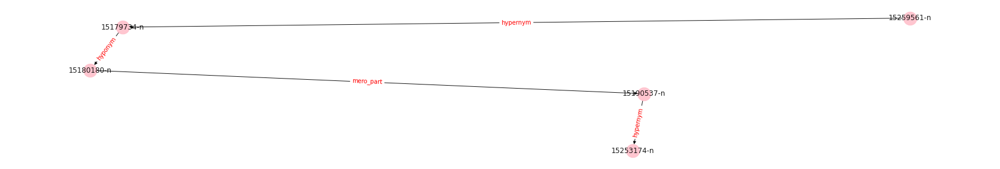

In [ ]:
#shortest path from "minute" to "hour"
sp_graph = wn_shortest_path(g_nx_nouns, "15259561-n", "15253174-n" , debug_flag = True)

draw_subgraph(sp_graph)


 Shortest path from 15253174-n to 15259561-n:

NODE ON PATH: 15253174-n 	 {'topic': 'noun.time', 'lemmas': 'time of day|hour|'}
	EDGE: 	 {'label': 'hyponym'}
NODE ON PATH: 15190537-n 	 {'lemmas': 'high noon|noon|midday|noonday|twelve noon|noontide|', 'topic': 'noun.time'}
	EDGE: 	 {'label': 'holo_part'}
NODE ON PATH: 15180180-n 	 {'lemmas': 'solar day|mean solar day|twenty-four hours|twenty-four hour period|24-hour interval|day|', 'topic': 'noun.time'}
	EDGE: 	 {'label': 'mero_part'}
NODE ON PATH: 15252642-n 	 {'lemmas': 'hour|60 minutes|hr|', 'topic': 'noun.time'}
	EDGE: 	 {'label': 'mero_part'}
NODE ON PATH: 15259561-n 	 {'topic': 'noun.time', 'lemmas': 'minute|min|'}


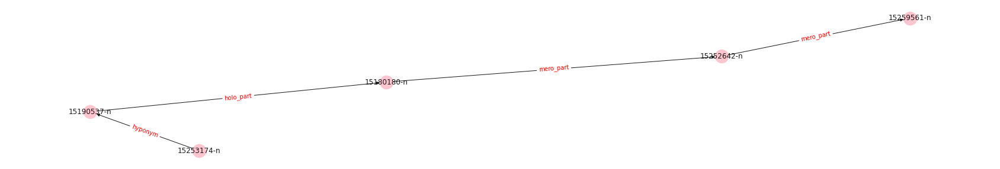

In [ ]:
#shortest path from  "hour" to "minute"
sp_graph = wn_shortest_path(g_nx_nouns, "15253174-n" , "15259561-n", debug_flag = True)

draw_subgraph(sp_graph)


 Shortest path from 03050242-n to 15259561-n:

NODE ON PATH: 03050242-n 	 {'lemmas': 'clock|', 'topic': 'noun.artifact'}
	EDGE: 	 {'label': 'instance_hyponym'}
NODE ON PATH: 02839980-n 	 {'lemmas': 'Big Ben|', 'topic': 'noun.artifact'}
	EDGE: 	 {'label': 'holo_part'}
NODE ON PATH: 08893849-n 	 {'lemmas': 'London|Greater London|capital of the United Kingdom|British capital|', 'topic': 'noun.location'}
	EDGE: 	 {'label': 'mero_part'}
NODE ON PATH: 08894500-n 	 {'lemmas': 'City of London|the City|', 'topic': 'noun.location'}
	EDGE: 	 {'label': 'instance_hypernym'}
NODE ON PATH: 08540894-n 	 {'lemmas': 'heart|middle|eye|center|centre|', 'topic': 'noun.location'}
	EDGE: 	 {'label': 'hyponym'}
NODE ON PATH: 08588822-n 	 {'topic': 'noun.location', 'lemmas': 'midfield|'}
	EDGE: 	 {'label': 'domain_topic'}
NODE ON PATH: 00469555-n 	 {'lemmas': 'football|football game|', 'topic': 'noun.act'}
	EDGE: 	 {'label': 'mero_part'}
NODE ON PATH: 15282640-n 	 {'lemmas': 'half|', 'topic': 'noun.time'}
	ED

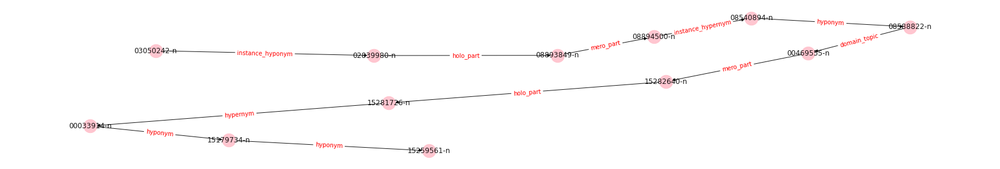

In [ ]:
#shortest path from "clock" to "minute"
sp_graph = wn_shortest_path(g_nx_nouns, "03050242-n", "15259561-n" , debug_flag = True)

draw_subgraph(sp_graph)

We see some interesting shortest path via Big Ben, football and playtime ... but we can improve the result by penalizing certain edge labels

In [ ]:
#maks a deep copy, while G.copy() makes a shallow copy that shares everything with orig
g_nx_nouns_modified = copy.deepcopy(g_nx_nouns)


for u,v,d in g_nx_nouns_modified.edges(data=True):
    if ("holo" in d["label"]) or ("mero" in d["label"]):
        d["weight"] = 4
    elif ("domain" in d["label"]):
        d["weight"] = 2
    else:
        d["weight"] = 1


 Shortest path from 03050242-n to 15259561-n:

NODE ON PATH: 03050242-n 	 {'lemmas': 'clock|', 'topic': 'noun.artifact'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 04445087-n 	 {'lemmas': 'timepiece|timekeeper|horologe|', 'topic': 'noun.artifact'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 03739416-n 	 {'lemmas': 'measuring instrument|measuring system|measuring device|', 'topic': 'noun.artifact'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 03579967-n 	 {'topic': 'noun.artifact', 'lemmas': 'instrument|'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 03187746-n 	 {'topic': 'noun.artifact', 'lemmas': 'device|'}
	EDGE: 	 {'label': 'hyponym', 'weight': 1}
NODE ON PATH: 07015100-n 	 {'lemmas': 'slide chart|', 'topic': 'noun.communication'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 07012462-n 	 {'lemmas': 'chart|graph|', 'topic': 'noun.communication'}
	EDGE: 	 {'label': 'hypernym', 'weight': 1}
NODE ON PATH: 06886302-n 	

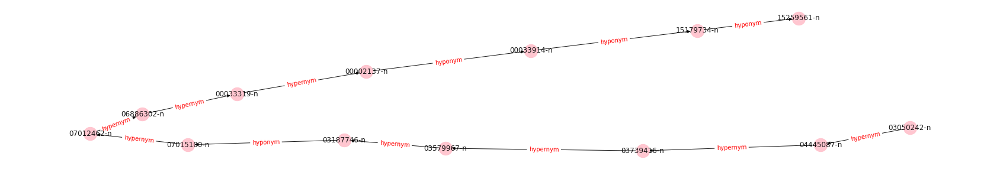

In [ ]:
#shortest path from "clock" to "minute"
sp_graph = wn_shortest_path(g_nx_nouns_modified, "03050242-n", "15259561-n" , w="weight", debug_flag = True)

draw_subgraph(sp_graph)

**Compute shortest paths between co-occuring nouns**

In [ ]:
def grah_of_shortest_paths_nouns(list_nouns_ids):

    list_nouns_ids_uniq = list(set(list_nouns_ids)) 
    list_nouns_ids_pairs = list(itertools.combinations(list_nouns_ids_uniq,2))

    sub_G = nx.DiGraph()
    for noun_pair in list_nouns_ids_pairs:
        if noun_pair[0] != noun_pair[1]:
            #print(noun_pair)
            try:
                subgraph_pair_nouns = wn_shortest_path(g_nx_nouns_modified, 
                                                       noun_pair[0],
                                                       noun_pair[1], 
                                                       w = "weight", debug_flag = False)
                
                subgraph_pair_nouns_ = wn_shortest_path(g_nx_nouns_modified, 
                                                        noun_pair[1],
                                                        noun_pair[0], 
                                                        w = "weight", debug_flag = False)
                #merge graphs in networkx
                sub_G = nx.compose(sub_G, subgraph_pair_nouns)
                sub_G = nx.compose(sub_G, subgraph_pair_nouns_)
            except Exception as e:
                print("error for pair:", noun_pair, " --> ", e)

    return sub_G

graph diameter: 16


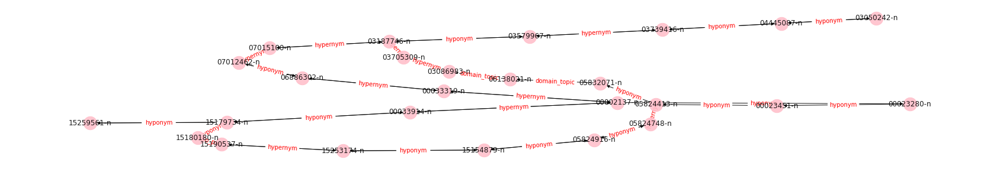

In [ ]:
#example
sub_G = grah_of_shortest_paths_nouns(list_nouns_ids =  ["03050242-n", "15259561-n", "15253174-n"])
print("graph diameter:", nx.diameter(sub_G))

draw_subgraph(sub_G)

In [ ]:
%%time
df_proverbs["nouns_sub_G"] = df_proverbs["nouns_wn_ids"].apply(lambda x: grah_of_shortest_paths_nouns(list_nouns_ids = x)) 


CPU times: user 18min 26s, sys: 8.84 s, total: 18min 35s
Wall time: 18min 37s


In [ ]:
df_proverbs["nouns_sub_G_diameter"] = df_proverbs["nouns_sub_G"].apply(lambda x: nx.diameter(x) if len(x.nodes()) > 1 else 0) 

print("min diameter: {}, max diameter: {}".format(df_proverbs["nouns_sub_G_diameter"].min(),
                                                  df_proverbs["nouns_sub_G_diameter"].max()))

min diameter: 0, max diameter: 30


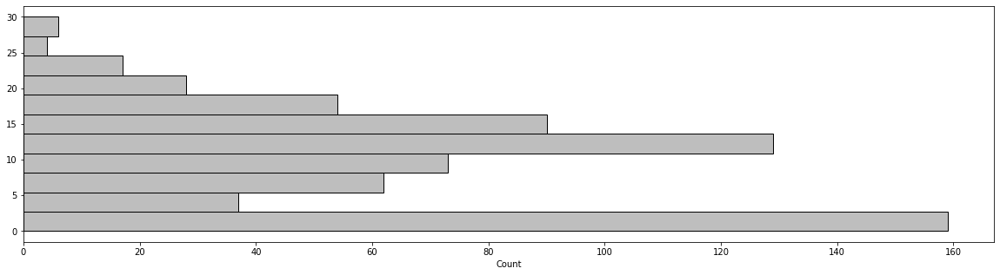

In [ ]:
fig,ax = plt.subplots(1,1, figsize=(20,5))
sns.histplot(y=list(df_proverbs["nouns_sub_G_diameter"].values), ax= ax, color="darkgray");

The diameter is 0 when the NetworkX graph contains at most 1 node in it. Examples:

In [ ]:
df_proverbs[df_proverbs["nouns_sub_G_diameter"] ==0 ].drop(columns=["original", "nouns_sub_G"]).head(5)

,idx,translated,lang,author,key,validation,seqno,id,doc,doc_orig,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,nouns_sub_G_diameter
2,2,Lost time is never regained.,it,,group1,0.0,3,1_3,"(Lost, time, is, never, regained, .)","(Tempo, perduto, mai, non, si, riacquista, .)",[time],[15295388-n],[time],[noun.time],0
4,4,"The day that has passed, one does not get back.",no,,group1,0.0,5,1_5,"(The, day, that, has, passed, ,, one, does, not, get, back, .)",None,[day],[15148032-n],[day],[noun.time],0
22,22,Between saying and doing there is the sea.,it,,group2,0.0,4,2_4,"(Between, saying, and, doing, there, is, the, sea, .)","(Tra, il, dire, e, il, fare, c', è, di, mezzo, il, mare, .)",[sea],[13799183-n],[sea],[noun.quantity],0
25,25,Lead by example.,fr,,group2,0.0,7,2_7,"(Lead, by, example, .)","(Il, faut, prêcher, d', exemple, .)",[example],[05828980-n],[example],[noun.cognition],0
30,30,Many fews make a lot.,it,,group3,0.0,4,3_4,"(Many, fews, make, a, lot, .)","(Tanti, pochi, fanno, un, assai, .)",[lot],[13796604-n],[lot],[noun.quantity],0


In [ ]:
df_proverbs[df_proverbs["nouns_sub_G_diameter"] == df_proverbs["nouns_sub_G_diameter"].max() ].drop(columns=["original", "nouns_sub_G"]).head(7)

,idx,translated,lang,author,key,validation,seqno,id,doc,doc_orig,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,nouns_sub_G_diameter
182,182,Better a caged bird than a swimming goose.,fr,,group12,1.0,12,12_12,"(Better, a, caged, bird, than, a, swimming, goose, .)","(Mieux, vaut, oiseau, en, cage, que, poule, qui, nage, .)","[bird, swimming, goose]","[01505702-n, 00443055-n, 01858313-n]","[bird, swimming, goose]","[noun.animal, noun.act, noun.animal]",30
331,331,It's more worth having friends in the square than money in the cash register.,it,,group24,0.0,3,24_3,"(It, 's, more, worth, having, friends, in, the, square, than, money, in, the, cash, register, .)","(Val, più, avere, amici, in, piazza, ,, che, denari, nella, cassa, .)","[friends, square, money, cash]","[09804483-n, 13901273-n, 13405730-n, 02980897-n]","[friend, square, money, cash_register]","[noun.person, noun.shape, noun.possession, noun.artifact]",30
502,502,"Wherever the fox has its camp, no robbery happens.",de,,group43,0.0,8,43_8,"(Wherever, the, fox, has, its, camp, ,, no, robbery, happens, .)","(Wo, der, Fuchs, sein, Lager, hat, ,, da, raubt, er, nicht, .)","[fox, camp, robbery]","[02120985-n, 02948281-n, 00783339-n]","[fox, camp, robbery]","[noun.animal, noun.artifact, noun.act]",30


--------------

## Analysis of adjectives used in proverbs

In [ ]:
df_proverbs["adjs"] = df_proverbs["doc"].apply(lambda x: [tok for tok in x if (tok.pos_ == "ADJ" ) and (tok._.WSD_CHOSEN_SENSE.get("pos") in ["a","s"] ) ])

df_proverbs["adjs_wn_ids"] = df_proverbs["adjs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["wnid"] for tok in x]) 
df_proverbs["adjs_wn_words"] = df_proverbs["adjs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["word"] for tok in x])

df_proverbs.drop(columns = ["doc", "doc_orig", "nouns_sub_G", "nouns_sub_G_diameter"]).head(10)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,adjs,adjs_wn_ids,adjs_wn_words
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]","[noun.artifact, noun.event]",[fleeting],[01445988-s],[fleeting]
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]","[noun.time, noun.time]",[],[],[]
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time],[noun.time],[],[],[]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]","[noun.person, noun.time]",[rich],[02029118-a],[rich]
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day],[noun.time],[],[],[]
5,5,Time and tide wait for no man.,Time and tide wait for no man.,en,,group1,0.0,6,1_6,"[Time, tide, wait, man]","[15147173-n, 07417119-n, 15297015-n, 10306910-n]","[time, tide, wait, man]","[noun.time, noun.event, noun.time, noun.person]",[],[],[]
6,6,"Time, low tide and high tide wait for no one.","Zeit, Ebbe und Flut warten für niemand.",de,,group1,0.0,7,1_7,"[Time, tide, tide, wait, one]","[15147173-n, 07417119-n, 07417119-n, 15297015-n, 13764713-n]","[time, tide, tide, wait, one]","[noun.time, noun.event, noun.event, noun.time, noun.quantity]","[low, high]","[01215141-a, 01213526-a]","[low, high]"
7,7,Fortune knocks once at every man's door.,Fortune knocks once at every man's door.,en,,group1,0.0,8,1_8,"[Fortune, man, door]","[11438252-n, 10306910-n, 03226423-n]","[fortune, man, door]","[noun.phenomenon, noun.person, noun.artifact]",[],[],[]
8,8,"When fortune is at the door, you must open it without making it wait.","Quand la fortune est à la porte, il faut lui ouvrir sans la faire attendre.",fr,,group1,0.0,9,1_9,"[fortune, door]","[11438252-n, 03226423-n]","[fortune, door]","[noun.phenomenon, noun.artifact]",[],[],[]
9,9,"What the sea brings on the way up, it takes back on the way back.","Ce que la mer apporte en montant, elle le remporte en descendant.",fr,,group1,0.0,10,1_10,"[sea, way, way]","[13799183-n, 04936080-n, 04936080-n]","[sea, way, way]","[noun.quantity, noun.attribute, noun.attribute]",[],[],[]


Extract column values into list of lists

In [ ]:
#lol i.e. list of lists
all_adjs_lol = list(df_proverbs["adjs"].values)
all_adjs_lol[0:5]

[[fleeting], [], [], [rich], []]

In [ ]:
#lol i.e. list of lists
all_adjs_lemmas_lol = list(df_proverbs["adjs_wn_words"].values)
all_adjs_lemmas_lol[0:5]

[['fleeting'], [], [], ['rich'], []]

In [ ]:
all_adjs_ids_lol = list(df_proverbs["adjs_wn_ids"].values)
all_adjs_ids_lol[0:5]

[['01445988-s'], [], [], ['02029118-a'], []]

In [ ]:
#flatten the lol
list_all_adjs = [item for sublist in all_adjs_lol for item in sublist]
list_all_adjs_lemmas = [item for sublist in all_adjs_lemmas_lol for item in sublist]
list_all_adjs_ids = [item for sublist in all_adjs_ids_lol for item in sublist]

print(list_all_adjs[0:10])
print(list_all_adjs_lemmas[0:10])
print(list_all_adjs_ids[0:10])

[fleeting, rich, low, high, lazy, expensive, Good, bad, wise, mad]
['fleeting', 'rich', 'low', 'high', 'lazy', 'expensive', 'good', 'bad', 'wise', 'mad']
['01445988-s', '02029118-a', '01215141-a', '01213526-a', '00984495-s', '00936423-a', '01126910-a', '01129296-a', '02579686-a', '02082451-s']


### Top adjectives by their frequency

In [ ]:
count1 = coll.Counter(list_all_adjs_lemmas)

utility_print_lists_columnized( count1.most_common(50) )

('good', 31)    ('old', 17)     ('beautiful', 15)  ('bad', 14)     ('many', 14)
('small', 14)   ('little', 11)  ('other', 11)      ('great', 8)    ('same', 8)
('single', 7)   ('worth', 7)    ('large', 6)       ('golden', 6)   ('bitter', 6)
('big', 6)      ('more', 6)     ('own', 6)         ('blind', 5)    ('whole', 5)
('sweet', 5)    ('hard', 5)     ('similar', 4)     ('young', 4)    ('few', 4)
('sure', 4)     ('strong', 3)   ('stupid', 3)      ('quiet', 3)    ('silent', 3)
('false', 3)    ('deaf', 3)     ('rich', 2)        ('low', 2)      ('lazy', 2)
('wise', 2)     ('full', 2)     ('such', 2)        ('open', 2)     ('new', 2)
('human', 2)    ('evil', 2)     ('wrong', 2)       ('first', 2)    ('lovely', 2)
('patient', 2)  ('rotten', 2)   ('easy', 2)        ('greener', 2)  ('green', 2)



### The degree of the adjective (positive, comparative, superlative)

It's suitable to use the dependency info in establishing the adjectives degree:

In [ ]:
all_adjs_degree = []
special_modifiers = set()

list_superlatives = []
list_comparatives = []

for el in list_all_adjs:
    degree = el.morph.get("Degree")[0]
    the_modifier = ""
    if degree == "Pos":        
        #check if any modifier among its children
        modifiers = [tok for tok in el.children if tok.pos_ == "ADV"]
        if len(modifiers) > 0:
            the_modifier = modifiers[0].text.lower()
            try:
                degree = modifiers[0].morph.get("Degree")[0]
            except:
                special_modifiers |= set([modifiers[0].text.lower()])

    all_adjs_degree.append(degree)
    full_adj = the_modifier + (" " if len(the_modifier)!=0 else "") + el.text.lower()
    if degree == "Cmp":
        list_comparatives.append(full_adj)
    elif degree == "Sup":
        list_superlatives.append(full_adj)

print("SPECIAL ADJ MODIFIERS:", special_modifiers)

SPECIAL ADJ MODIFIERS: {'as', 'so', 'very', 'enough', 'only', 'how', 'excessively', 'long', 'too'}


In [ ]:
count2 = coll.Counter(all_adjs_degree)
count2

Counter({'Cmp': 19, 'Pos': 314, 'Sup': 17})

#### Top adjectives in comparative degree, by their frequency

In [ ]:
count3 = coll.Counter(list_comparatives)
utility_print_lists_columnized(count3.most_common(50))

('more', 6)        ('more beautiful', 2)  ('worse', 2)   ('bigger', 2)    ('less', 1)
('more worth', 1)  ('better safe', 1)     ('easier', 1)  ('stronger', 1)  ('smaller', 1)
('warmer', 1)


#### Top adjectives in superlative degree, by their frequency

In [ ]:
#most frequently used adj in superlative form
count4 = coll.Counter(list_superlatives)
utility_print_lists_columnized(count4.most_common(50))

('best', 7)            ('most beautiful', 4)  ('most expensive', 1)  ('largest', 1)  ('heaviest', 1)
('most effective', 1)  ('hardest', 1)         ('biggest', 1)


### Collocations involving a given adjective

Here we can use a Spacy Matcher

In [ ]:
nlp = spacy.load("en_core_web_lg", disable = ['ner'])

In [ ]:
def collocate_adj(adj_lemma):
    pattern_adj_noun = [
        # anchor token: 
        {
            "RIGHT_ID": "the_adj",
            "RIGHT_ATTRS": {"POS": "ADJ", "LEMMA": adj_lemma} 
        },
        #  thenoun1 <- thenoun2
        {
            "LEFT_ID": "the_adj",
            "REL_OP": "<",
            "RIGHT_ID": "the_noun",
            "RIGHT_ATTRS": {"POS": "NOUN"} 
        }
    ]

    dep_matcher = DependencyMatcher(nlp.vocab)
    dep_matcher.add(key = "Patt_AN", patterns = [pattern_adj_noun])

    for i,row in df_proverbs.iterrows():
        doc = row["doc"]
        matches = dep_matcher(doc)
        if len(matches) > 0:
            print(str(row["translated"]).ljust(100), " ||| ", matches, end = "      ||| ")
            for match in matches:
                pattern_matched = dep_matcher.vocab.strings[match[0]]
                if pattern_matched == "Patt_AN":
                    adj1 = doc[match[1][0]]
                    noun2 = doc[match[1][1]]
                    adj_noun_pair = (adj1 .lemma_ , noun2.lemma_)
                    print(adj_noun_pair)

In [ ]:
collocate_adj(adj_lemma = "golden")

He that would make a golden gate, must bring a nail to it daily.                                      |||  [(6350179079179089219, [5, 6])]      ||| ('golden', 'gate')
A golden saddle is worth a lot, but it doesn't make a horse out of a donkey.                          |||  [(6350179079179089219, [1, 2])]      ||| ('golden', 'saddle')
An ape remains an ape, even if he is sitting on a golden chair.                                       |||  [(6350179079179089219, [13, 14])]      ||| ('golden', 'chair')
To promise golden mountains to someone.                                                               |||  [(6350179079179089219, [2, 3])]      ||| ('golden', 'mountain')
Good fame is better than a golden belt.                                                               |||  [(6350179079179089219, [6, 7])]      ||| ('golden', 'belt')


In [ ]:
collocate_adj(adj_lemma = "sweet")

The bitter the peel, the sweeter the core.                                                            |||  [(6350179079179089219, [6, 8])]      ||| ('sweet', 'core')
There are many kinds of fruit that grow on the tree of life, but none so sweet as friendship.         |||  [(6350179079179089219, [17, 15])]      ||| ('sweet', 'none')
Better a bitter truth than a sweet lie.                                                               |||  [(6350179079179089219, [6, 7])]      ||| ('sweet', 'lie')
Hypocrisy is a sweet poison and satir is a bitter medicine.                                           |||  [(6350179079179089219, [3, 4])]      ||| ('sweet', 'poison')
Flattery is sweet food for those who can swallow it.                                                  |||  [(6350179079179089219, [2, 3])]      ||| ('sweet', 'food')


In [ ]:
collocate_adj(adj_lemma = "beautiful")

There's only one beautiful child in the world and every mother has it.                                |||  [(6350179079179089219, [4, 5])]      ||| ('beautiful', 'child')
The most beautiful snowdrops are found among the brambles.                                            |||  [(6350179079179089219, [2, 3])]      ||| ('beautiful', 'snowdrop')
Beautiful head is sometimes an evil beast.                                                            |||  [(6350179079179089219, [0, 1])]      ||| ('beautiful', 'head')
Beautiful vineyard may give few grapes.                                                               |||  [(6350179079179089219, [0, 1])]      ||| ('beautiful', 'vineyard')
The more poisonous the mushroom, the more beautiful the cap.                                          |||  [(6350179079179089219, [8, 10])]      ||| ('beautiful', 'cap')
Some have the most beautiful fence around a barren garden.                                            |||  [(6350179079179089219, [4, 5])]   

### Sentiment polarity associated with adjectives used

In [ ]:
#how it works

vader = SentimentIntensityAnalyzer()

for expr in ["dumbest", "dumber", "dumb", "smart", "smarter", "smartest"]:
    print( str(expr).ljust(30), vader.polarity_scores(expr))


dumbest                        {'neg': 1.0, 'neu': 0.0, 'pos': 0.0, 'compound': -0.5106}
dumber                         {'neg': 1.0, 'neu': 0.0, 'pos': 0.0, 'compound': -0.3612}
dumb                           {'neg': 1.0, 'neu': 0.0, 'pos': 0.0, 'compound': -0.5106}
smart                          {'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.4019}
smarter                        {'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.4588}
smartest                       {'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.6124}


In [ ]:
list_polarity = []
for k,v in count1.items():
    d = vader.polarity_scores(k)
    d["adj"] = k
    list_polarity.append(d)

df_polarity = pd.DataFrame(list_polarity)
df_polarity.head()

,neg,neu,pos,compound,adj
0,0.0,1.0,0.0,0.0000,fleeting
1,0.0,0.0,1.0,0.5574,rich
2,1.0,0.0,0.0,-0.2732,low
3,0.0,1.0,0.0,0.0000,high
4,1.0,0.0,0.0,-0.3612,lazy


Most negative adjectives:

In [ ]:
df_polarity.sort_values(by = "compound").head(10)

,neg,neu,pos,compound,adj
58,1.0,0.0,0.0,-0.6597,evil
7,1.0,0.0,0.0,-0.5423,bad
30,1.0,0.0,0.0,-0.5267,stupid
79,1.0,0.0,0.0,-0.5106,rotten
40,1.0,0.0,0.0,-0.5106,ugly
9,1.0,0.0,0.0,-0.4939,mad
61,1.0,0.0,0.0,-0.4767,wrong
63,1.0,0.0,0.0,-0.4767,poor
48,1.0,0.0,0.0,-0.4404,dirty
42,1.0,0.0,0.0,-0.4215,bitter


Most positive adjectives:

In [ ]:
df_polarity.sort_values(by = "compound").tail(10)

,neg,neu,pos,compound,adj
8,0.0,0.0,1.0,0.4767,wise
27,0.0,0.0,1.0,0.5106,strong
115,0.0,0.0,1.0,0.5106,free
112,0.0,0.0,1.0,0.5574,divine
1,0.0,0.0,1.0,0.5574,rich
37,0.0,0.0,1.0,0.5719,wonderful
116,0.0,0.0,1.0,0.5719,precious
72,0.0,0.0,1.0,0.5859,lovely
38,0.0,0.0,1.0,0.5994,beautiful
14,0.0,0.0,1.0,0.6249,great


Of course, it depends if used in an oxymoron , like "sweet poison" or "bitter truth", the score is different for the entire expression

In [ ]:
print(vader.polarity_scores("sweet"))
print(vader.polarity_scores("poison"))
print(vader.polarity_scores("sweet poison"))


{'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.4588}
{'neg': 1.0, 'neu': 0.0, 'pos': 0.0, 'compound': -0.5423}
{'neg': 0.538, 'neu': 0.0, 'pos': 0.462, 'compound': -0.128}


In [ ]:
print(vader.polarity_scores("bitter"))
print(vader.polarity_scores("truth"))
print(vader.polarity_scores("bitter truth"))


{'neg': 1.0, 'neu': 0.0, 'pos': 0.0, 'compound': -0.4215}
{'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.3182}
{'neg': 0.549, 'neu': 0.0, 'pos': 0.451, 'compound': -0.128}


-----------------------------------------

## Analysis of adverbs used in proverbs

In [ ]:
df_proverbs["advs"] = df_proverbs["doc"].apply(lambda x: [tok for tok in x if (tok._.WSD_CHOSEN_SENSE.get("pos") == "r" ) ])

df_proverbs["advs_wn_ids"] = df_proverbs["advs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["wnid"] for tok in x]) 
df_proverbs["advs_wn_words"] = df_proverbs["advs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["word"] for tok in x])

df_proverbs.drop(columns = ["doc", "doc_orig", "nouns_sub_G", "nouns_sub_G_diameter"]).head(10)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,adjs,adjs_wn_ids,adjs_wn_words,advs,advs_wn_ids,advs_wn_words
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]","[noun.artifact, noun.event]",[fleeting],[01445988-s],[fleeting],[],[],[]
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]","[noun.time, noun.time]",[],[],[],[],[],[]
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time],[noun.time],[],[],[],[never],[00021214-r],[never]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]","[noun.person, noun.time]",[rich],[02029118-a],[rich],[enough],[00146749-r],[enough]
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day],[noun.time],[],[],[],[],[],[]
5,5,Time and tide wait for no man.,Time and tide wait for no man.,en,,group1,0.0,6,1_6,"[Time, tide, wait, man]","[15147173-n, 07417119-n, 15297015-n, 10306910-n]","[time, tide, wait, man]","[noun.time, noun.event, noun.time, noun.person]",[],[],[],[],[],[]
6,6,"Time, low tide and high tide wait for no one.","Zeit, Ebbe und Flut warten für niemand.",de,,group1,0.0,7,1_7,"[Time, tide, tide, wait, one]","[15147173-n, 07417119-n, 07417119-n, 15297015-n, 13764713-n]","[time, tide, tide, wait, one]","[noun.time, noun.event, noun.event, noun.time, noun.quantity]","[low, high]","[01215141-a, 01213526-a]","[low, high]",[],[],[]
7,7,Fortune knocks once at every man's door.,Fortune knocks once at every man's door.,en,,group1,0.0,8,1_8,"[Fortune, man, door]","[11438252-n, 10306910-n, 03226423-n]","[fortune, man, door]","[noun.phenomenon, noun.person, noun.artifact]",[],[],[],[once],[00119765-r],[once]
8,8,"When fortune is at the door, you must open it without making it wait.","Quand la fortune est à la porte, il faut lui ouvrir sans la faire attendre.",fr,,group1,0.0,9,1_9,"[fortune, door]","[11438252-n, 03226423-n]","[fortune, door]","[noun.phenomenon, noun.artifact]",[],[],[],[],[],[]
9,9,"What the sea brings on the way up, it takes back on the way back.","Ce que la mer apporte en montant, elle le remporte en descendant.",fr,,group1,0.0,10,1_10,"[sea, way, way]","[13799183-n, 04936080-n, 04936080-n]","[sea, way, way]","[noun.quantity, noun.attribute, noun.attribute]",[],[],[],"[up, back]","[00096883-r, 00074673-r]","[up, back]"


In [ ]:
#lol i.e. list of lists
all_advs_lemmas_lol = list(df_proverbs["advs_wn_words"].values)
print(all_advs_lemmas_lol[0:5])
list_all_advs_lemmas = [item for sublist in all_advs_lemmas_lol for item in sublist]
print(list_all_advs_lemmas[0:10])

[[], [], ['never'], ['enough'], []]
['never', 'enough', 'once', 'up', 'back', 'then', 'too', 'never_again', 'even', 'most']


In [ ]:
count1 = coll.Counter(list_all_advs_lemmas)

utility_print_lists_columnized( count1.most_common(50) )

('well', 23)     ('never', 19)       ('always', 15)    ('even', 10)       ('so', 9)
('only', 9)      ('often', 8)        ('still', 7)      ('together', 7)    ('far', 7)
('long', 6)      ('once', 5)         ('most', 5)       ('more', 5)        ('alone', 5)
('too_much', 5)  ('then', 4)         ('too', 4)        ('sometimes', 4)   ('away', 4)
('twice', 4)     ('back', 3)         ('no_long', 3)    ('also', 3)        ('as', 3)
('enough', 2)    ('everywhere', 2)   ('alike', 2)      ('soon', 2)        ('little', 2)
('very', 2)      ('seldom', 2)       ('inside', 2)     ('badly', 2)       ('yet', 2)
('up', 1)        ('never_again', 1)  ('there', 1)      ('rarely', 1)      ('originally', 1)
('daily', 1)     ('slowly', 1)       ('quickly', 1)    ('usually', 1)     ('directly', 1)
('nowhere', 1)   ('deep', 1)         ('therefore', 1)  ('eventually', 1)  ('indeed', 1)



### A focus on temporal entities and SRL args

In [ ]:
#date/time-related entities are spans, not only adverbs
all_ents_date = []
for i, row in df_proverbs.iterrows():
    doc = row["doc"]
    for ent in doc.ents:
        ent_type = ent[0].ent_type_
        if ent_type in ["DATE","TIME","DURATION"]:
            all_ents_date.append(ent.text.lower())


count7 = coll.Counter(all_ents_date)
utility_print_lists_columnized(count7.most_common(50))

('tomorrow', 3)  ('today', 2)      ('the day', 1)          ('sixty minutes', 1)   ('daily', 1)
('winter', 1)    ('one month', 1)  ('a hundred years', 1)  ('overnight', 1)       ('april', 1)
('one day', 1)   ('yesterday', 1)  ('noon', 1)             ('the after-noon', 1)


In [ ]:
#date/time args in srl are more complex spans
simple_args_temporal = []
elaborated_args_temporal = []

for i, row in df_proverbs.iterrows():
    doc = row["doc"]
    for tok in doc:
        if (bool(tok._.SRL) is True) and ("ARGM-TMP" in tok._.SRL):
            arg_tmp = (tok._.SRL)["ARGM-TMP"]
            #extrat the limits of the span; recap that arg_tm is a list of indices that form that arg
            min_ii = min(arg_tmp)
            max_ii = max(arg_tmp)
            temporal_span = doc[min_ii:max_ii+1].text.lower()
            if max_ii - min_ii <= 2:
                simple_args_temporal.append(temporal_span)
            else:
                elaborated_args_temporal.append(temporal_span)


count8 = coll.Counter(simple_args_temporal)
utility_print_lists_columnized(count8.most_common(50))

print("----------------------------------------------------------")

count9 = coll.Counter(elaborated_args_temporal)
utility_print_lists_columnized(count9.most_common(50), num_cols_columnize=4)

('always', 14)        ('when', 13)            ('often', 8)               ('once', 5)            ('sometimes', 5)
('twice', 4)          ('still', 3)            ('no longer', 3)           ('tomorrow', 3)        ('at once', 3)
('seldom', 2)         ('today', 2)            ('when luck comes', 1)     ('rarely', 1)          ('originally', 1)
('in a day', 1)       ('daily', 1)            ('at a time', 1)           ('soon', 1)            ('after every mosquito', 1)
('as you sow', 1)     ('eventually', 1)       ('after black clouds', 1)  ('after a storms', 1)  ('after rain', 1)
('one month', 1)      ('when in trouble', 1)  ('in uncertain times', 1)  ('the hours', 1)       ('when it rains', 1)
('anew', 1)           ('its time', 1)         ('before you leap', 1)     ('overnight', 1)       ('before you run', 1)
('before', 1)         ('yet', 1)              ('already', 1)             ('before victory', 1)  ('immediately', 1)
('soon and well', 1)  ('in one day', 1)       ('in old age', 1)          (

--------------

## Analysis of verbs used in proverbs

In [ ]:
df_proverbs["verbs"] = df_proverbs["doc"].apply(lambda x: [tok for tok in x if (tok._.WSD_CHOSEN_SENSE.get("pos") == "v" ) and (tok.pos_ != "AUX") ])

df_proverbs["verbs_wn_ids"] = df_proverbs["verbs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["wnid"] for tok in x]) 
df_proverbs["verbs_wn_words"] = df_proverbs["verbs"].apply(lambda x: [tok._.WSD_CHOSEN_SENSE["word"] for tok in x])

df_proverbs.drop(columns = ["doc", "doc_orig", "nouns_sub_G", "nouns_sub_G_diameter"]).head(5)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,adjs,adjs_wn_ids,adjs_wn_words,advs,advs_wn_ids,advs_wn_words,verbs,verbs_wn_ids,verbs_wn_words
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]","[noun.artifact, noun.event]",[fleeting],[01445988-s],[fleeting],[],[],[],"[Breaking, stop]","[02674312-v, 02565578-v]","[break, stop]"
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]","[noun.time, noun.time]",[],[],[],[],[],[],[wait],[02644022-v],[wait]
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time],[noun.time],[],[],[],[never],[00021214-r],[never],[regained],[02252785-v],[regain]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]","[noun.person, noun.time]",[rich],[02029118-a],[rich],[enough],[00146749-r],[enough],[buy],[02212672-v],[buy_back]
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day],[noun.time],[],[],[],[],[],[],[get],[01113995-v],[get_back]


Extract column values into list of lists

In [ ]:
#lol i.e. list of lists
all_verbs_lol = list(df_proverbs["verbs"].values)
all_verbs_lol[0:5]

[[Breaking, stop], [wait], [regained], [buy], [get]]

In [ ]:
#lol i.e. list of lists
all_verbs_lemmas_lol = list(df_proverbs["verbs_wn_words"].values)
all_verbs_lemmas_lol[0:5]

[['break', 'stop'], ['wait'], ['regain'], ['buy_back'], ['get_back']]

In [ ]:
all_verbs_ids_lol = list(df_proverbs["verbs_wn_ids"].values)
all_verbs_ids_lol[0:5]

[['02674312-v', '02565578-v'],
 ['02644022-v'],
 ['02252785-v'],
 ['02212672-v'],
 ['01113995-v']]

In [ ]:
#flatten the lol
list_all_verbs = [item for sublist in all_verbs_lol for item in sublist]
list_all_verbs_lemmas = [item for sublist in all_verbs_lemmas_lol for item in sublist]
list_all_verbs_ids = [item for sublist in all_verbs_ids_lol for item in sublist]

print(list_all_verbs[0:10])
print(list_all_verbs_lemmas[0:10])
print(list_all_verbs_ids[0:10])

[Breaking, stop, wait, regained, buy, get, knocks, is, open, making]
['break', 'stop', 'wait', 'regain', 'buy_back', 'get_back', 'knock', 'be', 'open', 'make_it']
['02674312-v', '02565578-v', '02644022-v', '02252785-v', '02212672-v', '01113995-v', '01417121-v', '02661230-v', '01348685-v', '02626004-v']


### Most frequently used verbs

In [ ]:
list_simple_verbs = [el for el in list_all_verbs_lemmas if "_" not in el]


count1 = coll.Counter(list_simple_verbs)
utility_print_lists_columnized(count1.most_common(50))

('make', 52)    ('be', 46)    ('have', 46)  ('see', 14)     ('find', 13)
('want', 12)    ('know', 11)  ('come', 10)  ('think', 10)   ('sow', 10)
('do', 9)       ('tell', 9)   ('give', 9)   ('steal', 9)    ('keep', 8)
('love', 8)     ('bring', 7)  ('grow', 7)   ('teach', 7)    ('praise', 7)
('forgive', 7)  ('wait', 6)   ('say', 6)    ('take', 6)     ('fly', 6)
('follow', 6)   ('bear', 6)   ('judge', 6)  ('reap', 6)     ('learn', 6)
('command', 6)  ('build', 5)  ('catch', 5)  ('fall', 5)     ('remain', 5)
('lose', 5)     ('sit', 5)    ('blame', 5)  ('swallow', 5)  ('please', 5)
('break', 4)    ('speak', 4)  ('lead', 4)   ('sing', 4)     ('jump', 4)
('go', 4)       ('like', 4)   ('get', 4)    ('cover', 4)    ('ride', 3)



Phrasal verbs

In [ ]:
list_phrasal_verbs = [el for el in list_all_verbs_lemmas if "_" in el]

count1_ = coll.Counter(list_phrasal_verbs)
utility_print_lists_columnized(count1_.most_common(50))

('look_for', 6)     ('look_at', 4)     ('come_to', 3)        ('take_back', 2)       ('go_far', 2)
('go_to_sleep', 2)  ('give_birth', 2)  ('come_out', 2)       ('throw_out', 2)       ('fall_into', 2)
('fly_high', 2)     ('buy_back', 1)    ('get_back', 1)       ('make_it', 1)         ('bring_on', 1)
('come_back', 1)    ('take_to', 1)     ('go_a_long_way', 1)  ('bring_together', 1)  ('go_with', 1)
('talk_about', 1)   ('wipe_out', 1)    ('throw_away', 1)     ('be_on', 1)           ('end_up', 1)
('go_to', 1)        ('lie_down', 1)    ('rise_up', 1)        ('escape_from', 1)     ('hollow_out', 1)
('make_noise', 1)   ('fall_apart', 1)  ('get_along', 1)      ('take_a_look', 1)     ('act_as', 1)
('look_on', 1)      ('take_on', 1)     ('look_like', 1)      ('light_up', 1)        ('make_good', 1)
('tear_down', 1)    ('go_in', 1)       ('put_in', 1)         ('break_off', 1)       ('come_into', 1)
('prepare_for', 1)  ('climb_up', 1)    ('take_away', 1)


### Verbs forms and tenses

In [ ]:
list_verbs_forms = []

for ii, sublist in enumerate(all_verbs_lol):
    for verb in sublist:
        if (verb.pos_ == "VERB") and (verb.dep_ not in ["amod", "aux"]):
            #skip verbs used as adjectives, as in "walked path" and skip aux, as in "had ..." 
            verbform = verb.morph.get("VerbForm")[0]
            verbtense = ""
            verbaspect = ""
            if verbform == "Part":
                verbtense = verb.morph.get("Tense")[0]
                try:
                    verbaspect = verb.morph.get("Aspect")[0]
                except:
                    pass
            elif verbform == "Fin":
                verbtense = verb.morph.get("Tense")[0]

            list_verbs_forms.append({"idx": ii,  "context": df_proverbs.iloc[ii]["translated"],
                                     "verb": verb._.WSD_CHOSEN_SENSE["word"], "verb_context" : list(verb.lefts) + [verb.text] ,
                                    "verb_form" : verbform, "verb_tense" : verbtense, "verb_aspect": verbaspect})
        

df_forms_tenses = pd.DataFrame(list_verbs_forms)
df_forms_tenses.head(20)

,idx,context,verb,verb_context,verb_form,verb_tense,verb_aspect
0,0,Breaking the watch does not stop the fleeting time.,break,[Breaking],Part,Pres,Prog
1,0,Breaking the watch does not stop the fleeting time.,stop,"[Breaking, does, not, stop]",Inf,,
2,1,Time and hours do not wait.,wait,"[Time, do, not, wait]",Inf,,
3,2,Lost time is never regained.,regain,"[time, is, never, regained]",Part,Past,Perf
4,3,No man is rich enough to buy back his past.,buy_back,"[to, buy]",Inf,,
5,4,"The day that has passed, one does not get back.",get_back,"[day, ,, one, does, not, get]",Inf,,
6,7,Fortune knocks once at every man's door.,knock,"[Fortune, knocks]",Fin,Pres,
7,8,"When fortune is at the door, you must open it without making it wait.",be,"[When, fortune, is]",Fin,Pres,
8,8,"When fortune is at the door, you must open it without making it wait.",open,"[is, ,, you, must, open]",Inf,,
9,8,"When fortune is at the door, you must open it without making it wait.",make_it,[making],Part,Pres,Prog


In [ ]:
df_forms_tenses.groupby(by=["verb_form", "verb_tense", "verb_aspect"])[["idx"]].count()

idx
verb_form verb_tense verb_aspect     
Fin       Past                    19 
          Pres                    326
Inf                               356
Part      Past                    1  
                     Perf         63 
          Pres       Prog         56

### Analysis of negated verbs

In [ ]:
num_neg = 0
list_verbs_neg = []
total = 0

for ii, sublist in enumerate(all_verbs_lol):
    for verb in sublist:
        if (verb.pos_ == "VERB"):
            if verb._.IS_NEG is True:
                num_neg += 1
                list_verbs_neg.append(verb._.WSD_CHOSEN_SENSE["word"])
            total += 1

print("Negated: {} out of total {} \n".format(num_neg, total))
print("Top negated verbs:")
count11 = coll.Counter(list_verbs_neg)
utility_print_lists_columnized(count11.most_common(50))

Negated: 149 out of total 826 

Top negated verbs:
('make', 23)       ('be', 10)     ('have', 7)        ('judge', 5)      ('see', 4)
('know', 4)        ('hear', 3)    ('teach', 3)       ('say', 3)        ('wait', 2)
('fall', 2)        ('give', 2)    ('do', 2)          ('trust', 2)      ('return', 2)
('sell', 2)        ('take', 2)    ('stretch', 2)     ('stop', 1)       ('regain', 1)
('get_back', 1)    ('invite', 1)  ('jump', 1)        ('come_out', 1)   ('bear', 1)
('give_birth', 1)  ('go_far', 1)  ('fail', 1)        ('cut', 1)        ('wipe_out', 1)
('put', 1)         ('hit', 1)     ('throw_away', 1)  ('throw_out', 1)  ('swim', 1)
('find', 1)        ('show', 1)    ('mean', 1)        ('expect', 1)     ('reap', 1)
('need', 1)        ('dig', 1)     ('last', 1)        ('force', 1)      ('please', 1)
('commit', 1)      ('regret', 1)  ('serve', 1)       ('command', 1)    ('worry', 1)



### Topics of verbs used

In [ ]:
def get_topic(wn_id):
    uri_node = URIRef("http://wordnet-rdf.princeton.edu/id/" + wn_id)
    uri_predicate = URIRef("http://purl.org/dc/terms/subject")
    res = g_rdf.triples((uri_node, uri_predicate, None))
    list_res = list(res)
    topic = list_res[0][2]
    assert(isinstance(topic, Literal))

    return str(topic)

In [ ]:
#example
get_topic(wn_id = "02644022-v")

'verb.stative'

In [ ]:
df_proverbs["verbs_topics"] = df_proverbs["verbs_wn_ids"].apply(lambda x: [get_topic(wn_id = wnid) for wnid in x])

df_proverbs.drop(columns = ["doc", "doc_orig", "nouns_sub_G", "nouns_sub_G_diameter"]).head(5)

,idx,translated,original,lang,author,key,validation,seqno,id,nouns,nouns_wn_ids,nouns_wn_words,nouns_topics,adjs,adjs_wn_ids,adjs_wn_words,advs,advs_wn_ids,advs_wn_words,verbs,verbs_wn_ids,verbs_wn_words,verbs_topics
0,0,Breaking the watch does not stop the fleeting time.,Briser la montre n'arrête pas le temps qui fuit.,fr,,group1,0.0,1,1_1,"[watch, time]","[04563183-n, 07324217-n]","[watch, time]","[noun.artifact, noun.event]",[fleeting],[01445988-s],[fleeting],[],[],[],"[Breaking, stop]","[02674312-v, 02565578-v]","[break, stop]","[verb.stative, verb.social]"
1,1,Time and hours do not wait.,Zeit und Stunden warten nicht.,de,,group1,0.0,2,1_2,"[Time, hours]","[15147173-n, 15253174-n]","[time, hour]","[noun.time, noun.time]",[],[],[],[],[],[],[wait],[02644022-v],[wait],[verb.stative]
2,2,Lost time is never regained.,Tempo perduto mai non si riacquista.,it,,group1,0.0,3,1_3,[time],[15295388-n],[time],[noun.time],[],[],[],[never],[00021214-r],[never],[regained],[02252785-v],[regain],[verb.possession]
3,3,No man is rich enough to buy back his past.,No man is rich enough to buy back his past.,en,Oscar Wilde,group1,0.0,4,1_4,"[man, past]","[10306910-n, 15145765-n]","[man, past]","[noun.person, noun.time]",[rich],[02029118-a],[rich],[enough],[00146749-r],[enough],[buy],[02212672-v],[buy_back],[verb.possession]
4,4,"The day that has passed, one does not get back.","Dagen som er gått, får ein ikkje igjen.",no,,group1,0.0,5,1_5,[day],[15148032-n],[day],[noun.time],[],[],[],[],[],[],[get],[01113995-v],[get_back],[verb.competition]


In [ ]:
#lol i.e. list of lists
all_verbs_topics_lol = list(df_proverbs["verbs_topics"].values)

all_verbs_topics_lol[0:5]

[['verb.stative', 'verb.social'],
 ['verb.stative'],
 ['verb.possession'],
 ['verb.possession'],
 ['verb.competition']]

In [ ]:
list_all_verbs_topics = [item for sublist in all_verbs_topics_lol for item in sublist]
print(list_all_verbs_topics[0:10])

['verb.stative', 'verb.social', 'verb.stative', 'verb.possession', 'verb.possession', 'verb.competition', 'verb.contact', 'verb.stative', 'verb.contact', 'verb.stative']


In [ ]:
count4 = coll.Counter(list_all_verbs_topics)

utility_print_lists_columnized( count4.most_common(50) )

('verb.stative', 112)    ('verb.possession', 102)  ('verb.communication', 88)  ('verb.motion', 84)      ('verb.change', 81)
('verb.cognition', 73)   ('verb.contact', 72)      ('verb.social', 65)         ('verb.creation', 45)    ('verb.emotion', 44)
('verb.perception', 35)  ('verb.body', 22)         ('verb.consumption', 13)    ('verb.competition', 7)  ('verb.weather', 2)



Example verbs per topic:

In [ ]:
def illustrate_topic2(verb_topic, topn= 100):
    #examples of verbs in a given topic
    idx = [ii for ii,el in enumerate(list_all_verbs_topics) if el == verb_topic]
    words_of_topic = [list_all_verbs_lemmas[el] for el in idx]
    count5 = coll.Counter(words_of_topic)
    utility_print_lists_columnized( count5.most_common(topn), num_cols_columnize=10 )

In [ ]:
illustrate_topic2("verb.communication")

('tell', 8)   ('teach', 7)   ('praise', 7)  ('say', 6)        ('command', 6)    ('forgive', 6)     ('speak', 4)    ('blame', 3)       ('promise', 3)   ('chirp', 2)
('talk', 2)   ('make', 2)    ('cry', 2)     ('excuse', 2)     ('scold', 2)      ('deceive', 1)     ('grunt', 1)    ('talk_about', 1)  ('cackle', 1)    ('find', 1)
('call', 1)   ('echo', 1)    ('sow', 1)     ('caw', 1)        ('mark', 1)       ('compromise', 1)  ('present', 1)  ('commit', 1)      ('return', 1)    ('shout', 1)
('yell', 1)   ('advise', 1)  ('bark', 1)    ('convinced', 1)  ('apologize', 1)  ('accuse', 1)      ('request', 1)  ('escape', 1)      ('disagree', 1)  ('admonish', 1)
('curse', 1)


In [ ]:
illustrate_topic2("verb.motion")

('bring', 7)   ('fly', 6)    ('jump', 4)   ('ride', 3)      ('swim', 3)      ('follow', 3)    ('sink', 3)     ('go', 3)        ('walk', 3)         ('take_back', 2)
('flow', 2)    ('lead', 2)   ('come', 2)   ('overflow', 2)  ('turn', 2)      ('overturn', 2)  ('run', 2)      ('cross', 2)     ('make', 1)         ('ascend', 1)
('stroll', 1)  ('stoop', 1)  ('close', 1)  ('trot', 1)      ('dance', 1)     ('lie_down', 1)  ('rise_up', 1)  ('fall', 1)      ('escape_from', 1)  ('miss', 1)
('leap', 1)    ('crawl', 1)  ('lift', 1)   ('reach', 1)     ('scramble', 1)  ('go_in', 1)     ('march', 1)    ('weave', 1)     ('spin', 1)         ('paddle', 1)
('climb', 1)   ('bend', 1)   ('leave', 1)  ('err', 1)       ('spill', 1)     ('sail', 1)      ('row', 1)      ('climb_up', 1)  ('.', 1)


In [ ]:
illustrate_topic2("verb.perception")

('see', 5)   ('show', 3)     ('hear', 3)        ('look', 2)         ('listen', 2)   ('seem', 2)   ('catch', 1)  ('dream', 1)    ('perceive', 1)  ('glow', 1)
('meet', 1)  ('come_to', 1)  ('make_noise', 1)  ('take_a_look', 1)  ('look_on', 1)  ('watch', 1)  ('ring', 1)   ('whistle', 1)  ('find', 1)      ('gape', 1)
('scan', 1)  ('smell', 1)    ('reflect', 1)     ('search', 1)


In [ ]:
illustrate_topic2("verb.emotion")

('want', 12)    ('love', 8)     ('please', 5)     ('like', 4)    ('worry', 2)  ('fly_high', 2)  ('take_to', 1)  ('recapture', 1)  ('fall_apart', 1)  ('regret', 1)
('impress', 1)  ('oneself', 1)  ('contented', 1)  ('admire', 1)  ('fear', 1)   ('despise', 1)   ('annoy', 1)


---------------------------------

## Analysis of pronouns used in proverbs

In [ ]:
df_proverbs["prons"] = df_proverbs["doc"].apply(lambda x: [tok for tok in x if (tok.pos_ == "PRON") ])


In [ ]:
all_prons_lol = list(df_proverbs["prons"].values)
all_prons_lol[0:5]

[[], [], [], [his], [one]]

In [ ]:
#flatten the lol
list_all_prons = [item for sublist in all_prons_lol for item in sublist]
list_all_prons_lemmas = [item.lemma_ for item in list_all_prons]
list_all_prons[0:5]

[his, one, you, it, it]

### Top frequently used pronouns

In [ ]:
count12 = coll.Counter(list_all_prons_lemmas)

utility_print_lists_columnized( count12.most_common(50) )

('you', 106)       ('it', 56)        ('who', 55)       ('he', 31)       ('your', 28)
('whoever', 25)    ('they', 24)      ('his', 22)       ('we', 19)       ('its', 18)
('there', 18)      ('everyone', 15)  ('one', 11)       ('what', 10)     ('I', 10)
('everything', 6)  ('yourself', 6)   ('their', 6)      ('someone', 5)   ('anyone', 4)
('nobody', 4)      ('himself', 4)    ('she', 3)        ('nothing', 3)   ('our', 2)
('themselves', 1)  ('something', 1)  ('everybody', 1)  ('anything', 1)  ('oneself', 1)
('her', 1)         ('itself', 1)


### Analysis by pronoun person and plurality 

In [ ]:
list_pronouns_details = [ ]


for ii, sublist in enumerate(all_prons_lol):
    for pron in sublist:
        try:
            #print(pron.morph) #e.g. Gender=Masc|Number=Sing|Person=3|Poss=Yes|PronType=Prs
            pers = pron.morph.get("Person")[0]
            #note: the get from the dict returns a list or none, that's why we let the alternative be a list as well [""]
            plurality = (pron.morph.get("Number") or [""])[0]
            gender = (pron.morph.get("Gender") or [""])[0]
            possesive = (pron.morph.get("Poss") or [""])[0]

            list_pronouns_details.append({"idx": ii,  "context": df_proverbs.iloc[ii]["translated"],
                                        "pronoun": pron.text.lower(), "person": pers,
                                        "gender" : gender, "plurality": plurality,
                                        "possesive": possesive, "special":0})
        except:
            list_pronouns_details.append({"idx": ii,  "context": df_proverbs.iloc[ii]["translated"],
                                          "pronoun": pron.text.lower(), "special":1})



df_pronouns_details = pd.DataFrame(list_pronouns_details)

df_pronouns_details["person"].fillna("", inplace=True)
df_pronouns_details["plurality"].fillna("", inplace=True)
df_pronouns_details["gender"].fillna("", inplace=True)
df_pronouns_details["possesive"].fillna("", inplace=True)
df_pronouns_details.head(20)

,idx,context,pronoun,person,gender,plurality,possesive,special
0,3,No man is rich enough to buy back his past.,his,3,Masc,Sing,Yes,0
1,4,"The day that has passed, one does not get back.",one,,,,,1
2,8,"When fortune is at the door, you must open it without making it wait.",you,2,,,,0
3,8,"When fortune is at the door, you must open it without making it wait.",it,3,Neut,Sing,,0
4,8,"When fortune is at the door, you must open it without making it wait.",it,3,Neut,Sing,,0
5,9,"What the sea brings on the way up, it takes back on the way back.",what,,,,,1
6,9,"What the sea brings on the way up, it takes back on the way back.",it,3,Neut,Sing,,0
7,10,Time brings the roses and takes them back.,them,3,,Plur,,0
8,11,"If luck comes as a horse, then don't be too lazy to ride it.",it,3,Neut,Sing,,0
9,13,"When luck comes, offer it a chair.",it,3,Neut,Sing,,0


Note: for "you" it doesn't specify plurality

In [ ]:
df_pronouns_details.groupby(by=["person", "plurality", "gender", "possesive"])[["idx"]].count()

idx
person plurality gender possesive     
                                   160
1      Plur                        19 
                        Yes        2  
       Sing                        10 
2                                  112
                        Yes        28 
3      Plur                        25 
                        Yes        6  
       Sing      Fem               3  
                        Yes        1  
                 Masc              35 
                        Yes        22 
                 Neut              57 
                        Yes        18

Note: 160 occurences of special pronouns:

In [ ]:
set(list(df_pronouns_details[df_pronouns_details["special"]==1]["pronoun"]))

{'anyone',
 'anything',
 'everybody',
 'everyone',
 'everything',
 'nobody',
 'nothing',
 'one',
 'oneself',
 'someone',
 'something',
 'there',
 'what',
 'who',
 'whoever'}

### Pronouns with coreference

In [ ]:
num_coref = 0
total_prons = 0

for ii, sublist in enumerate(all_prons_lol):
    for pron in sublist:
        if pron._.COREF_TARGET != -1:
            num_coref += 1
        total_prons += 1

print("Coref pronouns {} out of total {}".format(num_coref, total_prons))

Coref pronouns 84 out of total 498


-------------------------

## Embeddings and semantic similarity

Recap: we had nouns of plants and of animals

In [ ]:
illustrate_topic("noun.animal")

('bird', 11)    ('egg', 10)     ('horse', 9)    ('crow', 8)    ('hen', 7)          ('cat', 7)     ('dog', 6)       ('calf', 6)   ('cow', 6)        ('mosquito', 5)
('feather', 5)  ('ape', 5)      ('fish', 4)     ('owl', 4)     ('fox', 4)          ('pigeon', 3)  ('dove', 3)      ('wolf', 3)   ('mouse', 2)      ('swan', 2)
('viper', 2)    ('sparrow', 2)  ('firefly', 2)  ('flea', 2)    ('falcon', 2)       ('wing', 2)    ('peacock', 2)   ('giant', 1)  ('fledgling', 1)  ('cub', 1)
('raven', 1)    ('lamb', 1)     ('eaglet', 1)   ('piglet', 1)  ('nightingale', 1)  ('shell', 1)   ('sprat', 1)     ('pig', 1)    ('elephant', 1)   ('salmon', 1)
('goose', 1)    ('monkey', 1)   ('billy', 1)    ('goat', 1)    ('butterfly', 1)    ('sow', 1)     ('woodworm', 1)  ('human', 1)  ('pheasant', 1)   ('udder', 1)
('bear', 1)     ('chicken', 1)  ('ox', 1)       (',', 1)       ('hare', 1)


In [ ]:
illustrate_topic("noun.plant")

('tree', 12)    ('flower', 5)  ('rose', 4)   ('bush', 4)      ('branch', 4)    ('needle', 4)   ('cheese', 3)       ('seed', 2)   ('oak', 2)   ('acorn', 2)
('sapling', 2)  ('twig', 2)    ('thorn', 2)  ('thistle', 2)   ('mushroom', 2)  ('fruit', 2)    ('grass', 2)        ('berry', 1)  ('leaf', 1)  ('apple', 1)
('trunk', 1)    ('kernel', 1)  ('nut', 1)    ('snowdrop', 1)  ('bramble', 1)   ('shoot', 1)    ('hazel', 1)        ('cap', 1)    ('bark', 1)  ('ashe', 1)
('prickle', 1)  ('root', 1)    ('herb', 1)   ('cactus', 1)    ('spine', 1)     ('blossom', 1)  ('tree_branch', 1)


Choose a demo set:

In [ ]:
list_demo_nouns = [("bird", "noun.animal"), ("sparrow", "noun.animal"), 
                   ("owl", "noun.animal"),  ("swan", "noun.animal"),  ("eaglet", "noun.animal"),
                   ("tree", "noun.plant"), ("bark", "noun.plant"), ("twig", "noun.plant"), 
                   ("sapling", "noun.plant"), ("leaf", "noun.plant"), ("branch", "noun.plant"), 
                   ("branch", "noun.group")
                   ]


list_demo_nouns_wnids = [dict_nouns_wnid.get(k) for k in list_demo_nouns]
print(list_demo_nouns_wnids)

['01505702-n', '01542214-n', '01623768-n', '01861082-n', '01616448-n', '13124818-n', '13183195-n', '13184889-n', '13129240-n', '13173519-n', '13184148-n', None]


In [ ]:
#the last None is because no "branch" occurrence was disambiguated as such in the proverbs we collected
#manually set this id based on http://wordnet-rdf.princeton.edu/lemma/branch
list_demo_nouns_wnids[-1] = "08418205-n"
print(list_demo_nouns_wnids)

['01505702-n', '01542214-n', '01623768-n', '01861082-n', '01616448-n', '13124818-n', '13183195-n', '13184889-n', '13129240-n', '13173519-n', '13184148-n', '08418205-n']


### Static word vectors with Spacy

In [ ]:
nlp = spacy.load("en_core_web_lg", disable = ['ner'])



Note: no distinction possible between senses given solely the word , e.g. "branch" (branch of a tree vs a company branch)

In [ ]:
#how it works
branch_id = nlp.vocab.strings["branch"]
branch_vector = nlp.vocab.vectors[branch_id]

print(type(branch_vector), branch_vector.shape, branch_vector.dtype)

<class 'numpy.ndarray'> (300,) float32


In [ ]:
dict_emb_spacy = {}

for word,topic in list_demo_nouns:
    word_id = nlp.vocab.strings[word]
    word_vector = nlp.vocab.vectors[word_id]
    new_key = "{} [ {} ]".format(word, topic)
    dict_emb_spacy[new_key] = word_vector

In [ ]:
arr_word_vectors = np.vstack(list(dict_emb_spacy.values()))
arr_word_vectors.shape

(12, 300)

In [ ]:
distances_spacy = pairwise_distances(arr_word_vectors, metric="cosine")
distances_spacy.shape

(12, 12)

In [ ]:
similarity_spacy = 1 - distances_spacy

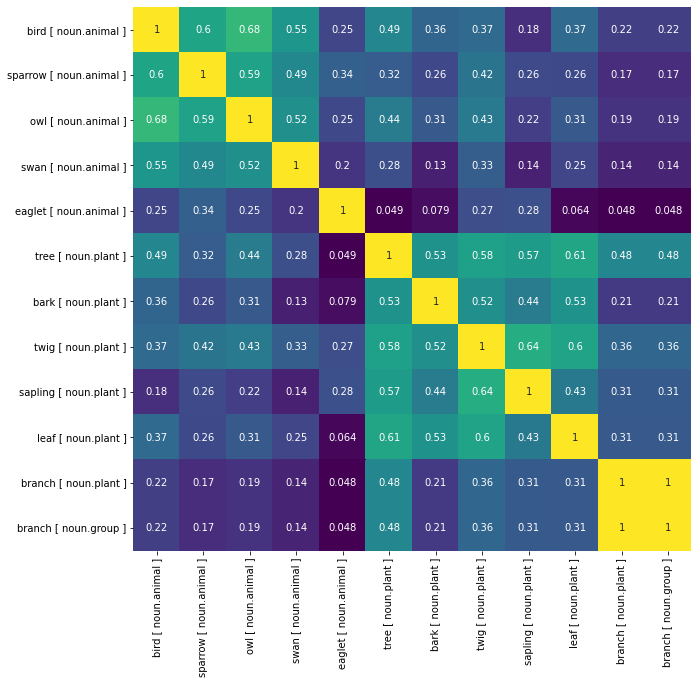

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10, 10))
sns.heatmap(similarity_spacy, 
            xticklabels = list(dict_emb_spacy.keys()), 
            yticklabels = list(dict_emb_spacy.keys()),
            annot=True, fmt=".2g", cmap='viridis', cbar = False, ax = ax);


### Embeddings with Node2Vec on Wordnet graph

In [ ]:
%%time
node2vec = Node2Vec(g_nx_nouns, dimensions=16, walk_length=10, num_walks=10, workers=4)  



CPU times: user 2min 40s, sys: 7.26 s, total: 2min 47s
Wall time: 8min 22s


In [ ]:
%%time
# Embed nodes
model_emb = node2vec.fit(window=5, min_count=2, batch_words=100)  

CPU times: user 9min 33s, sys: 32.7 s, total: 10min 6s
Wall time: 5min 55s


In [ ]:
# Save model for later use
model_emb.save("/content/gdrive/My Drive/proverbs/emb_model_node2vec.model")

We can now use the model to find most similar nodes to a given node:

In [ ]:
#for "branch" (plant), i.e. wn id 13184148-n
list_similar_ = model_emb.wv.most_similar("13184148-n")
pp.pprint(list_similar_)

print("---------------------------------------------------")

for el in list_similar_:
    print(el[1], "-->", g_nx_nouns.nodes(data=True)[el[0]])

[('13184451-n', 0.989794909954071), ('13186713-n', 0.9749986529350281), ('13184889-n', 0.9587592482566833), ('13149341-n', 0.9571037292480469),
 ('13186625-n', 0.955443263053894), ('13151064-n', 0.9536782503128052), ('13151328-n', 0.9523949027061462), ('13112741-n', 0.9515962600708008),
 ('11698650-n', 0.9515862464904785), ('11698353-n', 0.9513901472091675)]
---------------------------------------------------
0.989794909954071 --> {'lemmas': 'deadwood|', 'topic': 'noun.plant'}
0.9749986529350281 --> {'lemmas': 'tree trunk|bole|trunk|', 'topic': 'noun.plant'}
0.9587592482566833 --> {'lemmas': 'branchlet|sprig|twig|', 'topic': 'noun.plant'}
0.9571037292480469 --> {'topic': 'noun.plant', 'lemmas': 'rootstalk|rootstock|rhizome|'}
0.955443263053894 --> {'lemmas': 'bough|', 'topic': 'noun.plant'}
0.9536782503128052 --> {'lemmas': 'stock|caudex|', 'topic': 'noun.plant'}
0.9523949027061462 --> {'topic': 'noun.plant', 'lemmas': 'stipe|'}
0.9515962600708008 --> {'topic': 'noun.plant', 'lemmas': 

In [ ]:
#for "branch" (group, business unit), i.e. wn id 08418205-n
list_similar_ = model_emb.wv.most_similar("08418205-n")
pp.pprint(list_similar_)

print("---------------------------------------------------")

for el in list_similar_:
    print(el[1], "-->", g_nx_nouns.nodes(data=True)[el[0]])

[('08373830-n', 0.9671683311462402), ('08372718-n', 0.9638849496841431), ('08237635-n', 0.9619571566581726), ('08162561-n', 0.9593241214752197),
 ('08373001-n', 0.9440824389457703), ('08069301-n', 0.9368166923522949), ('08373302-n', 0.9346538782119751), ('08139743-n', 0.9273291826248169),
 ('08139116-n', 0.925023078918457), ('08136796-n', 0.9215085506439209)]
---------------------------------------------------
0.9671683311462402 --> {'topic': 'noun.group', 'lemmas': 'judicial branch|'}
0.9638849496841431 --> {'lemmas': 'US Government|United States|U.S.|United States government|U.S. government|', 'topic': 'noun.group'}
0.9619571566581726 --> {'topic': 'noun.group', 'lemmas': 'division|'}
0.9593241214752197 --> {'topic': 'noun.group', 'lemmas': 'post office|local post office|'}
0.9440824389457703 --> {'lemmas': 'Executive Office of the President|executive branch|', 'topic': 'noun.group'}
0.9368166923522949 --> {'lemmas': 'federal government|', 'topic': 'noun.group'}
0.9346538782119751 --

**Extract the embeddings:** 

In [ ]:
list_nodes_ids = model_emb.wv.index2word  
print(type(list_nodes_ids), len(list_nodes_ids))
print(list_nodes_ids[0:10])

<class 'list'> 82192
['08458195-n', '10813654-n', '00007846-n', '08542298-n', '08215965-n', '12226211-n', '01509816-n', '01867348-n', '13133423-n', '03314753-n']


In [ ]:
nodes_emb_vectors = model_emb.wv.vectors
print(type(nodes_emb_vectors), nodes_emb_vectors.shape)

<class 'numpy.ndarray'> (82192, 16)


In [ ]:
dict_emb_node2vec = {}

for ii,word_tuple in enumerate(list_demo_nouns):
    word_wnid = list_demo_nouns_wnids[ii]
    id = [jj for jj, el in enumerate(list_nodes_ids) if el == word_wnid][0]
    new_key = "{} [ {} ]".format(word_tuple[0], word_tuple[1])
    dict_emb_node2vec[new_key] = nodes_emb_vectors[id]


In [ ]:
arr_word_vectors2 = np.vstack(list(dict_emb_node2vec.values()))
arr_word_vectors2.shape

(12, 16)

In [ ]:
distances_node2vec = pairwise_distances(arr_word_vectors2, metric="cosine")
distances_node2vec.shape

(12, 12)

In [ ]:
similarity_node2vec = 1 - distances_node2vec

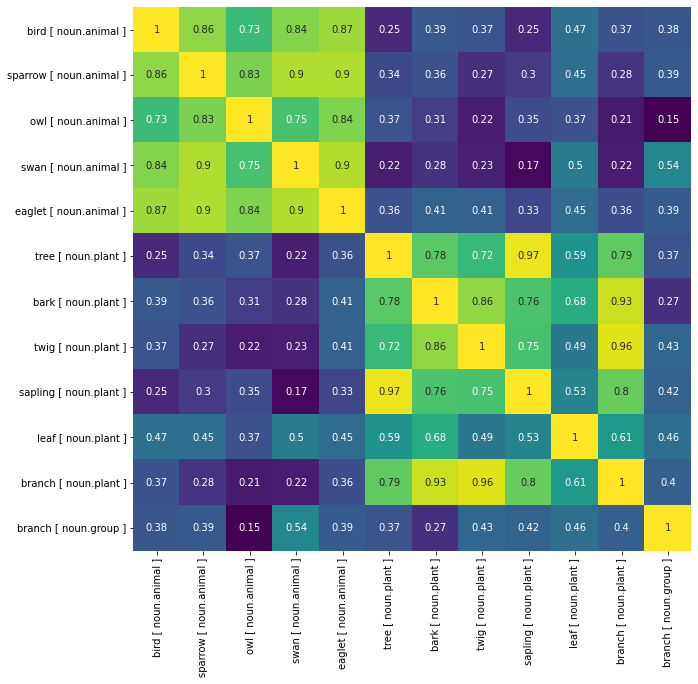

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10, 10))
sns.heatmap(similarity_node2vec, 
            xticklabels = list(dict_emb_node2vec.keys()), 
            yticklabels = list(dict_emb_node2vec.keys()),
            annot=True, fmt=".2g", cmap='viridis', cbar = False, ax = ax);


The two semantic groups are identified much better now.

In [ ]:
np.save("/content/gdrive/My Drive/proverbs/node2vec_embeddings.npy", nodes_emb_vectors)

In [ ]:
!du -h "/content/gdrive/My Drive/proverbs/node2vec_embeddings.npy"

5.1M	/content/gdrive/My Drive/proverbs/node2vec_embeddings.npy


### Embeddings with Transformers

#### Transformers in Spacy

See https://applied-language-technology.readthedocs.io/en/latest/notebooks/part_iii/04_embeddings_continued.html

In [ ]:
nlp_trf = spacy.load("en_core_web_trf")

In [ ]:
#it has no static vectors included
len(nlp_trf.vocab.vectors)

0

In [ ]:
doc1 = nlp_trf("The fallen blossoms don't return to branch.")

utility_dir(doc1)
print("---------------------------------------------------")
utility_dir(doc1._)
print("---------------------------------------------------")
utility_dir(doc1._.trf_data)

print("\n", type(doc1._.trf_data.tensors[0]), "   ||| ", type(doc1._.trf_data.tensors[1])) 
print("\n", doc1._.trf_data.tensors[0].shape, "   ||| ", doc1._.trf_data.tensors[1].shape) 


cats            char_span      copy                count_by    doc              ents                  extend_tensor
from_array      from_bytes     from_dict           from_disk   from_docs        get_extension         get_lca_matrix
has_annotation  has_extension  has_unknown_spaces  has_vector  is_nered         is_parsed             is_sentenced
is_tagged       lang           lang_               mem         noun_chunks      noun_chunks_iterator  remove_extension
retokenize      sentiment      sents               set_ents    set_extension    similarity            spans
tensor          text           text_with_ws        to_array    to_bytes         to_dict               to_disk
to_json         to_utf8_array  user_data           user_hooks  user_span_hooks  user_token_hooks      vector
vector_norm     vocab
---------------------------------------------------
get  has  set  trf_data
---------------------------------------------------
align   empty  from_bytes  from_dict  tensors  to_bytes 

Note: subword parts used by transformers need to be aligned to the original tokens

In [ ]:
#remark the blossoms split into 2 parts "bloss" and "oms"
doc1._.trf_data.tokens['input_texts']

[['<s>',
  'The',
  'Ġfallen',
  'Ġbloss',
  'oms',
  'Ġdon',
  "'t",
  'Ġreturn',
  'Ġto',
  'Ġbranch',
  '.',
  '</s>']]

In [ ]:
doc1._.trf_data.align

Ragged(data=array([[ 1],
       [ 2],
       [ 3],
       [ 4],
       [ 5],
       [ 5],
       [ 6],
       [ 7],
       [ 8],
       [ 9],
       [10]], dtype=int32), lengths=array([1, 1, 2, 1, 2, 1, 1, 1, 1], dtype=int32), data_shape=(-1,), cumsums=None)

In [ ]:
def recompose_token_vector_trf(token_idx_original, doc_trf, debug_flag = False):

    if debug_flag is True:
        print(doc_trf[token_idx_original])

    alignment_lol = doc_trf._.trf_data.align[token_idx_original].data
    #convert lol to list
    alignment = alignment_lol.flatten()
    if debug_flag is True:
        print("alignment:", alignment)

    lower_lim = alignment[0]
    upper_lim = alignment[-1] + 1
    parts_vectors = doc1._.trf_data.tensors[0][0][lower_lim: upper_lim]

    if debug_flag is True:
        print(parts_vectors.shape)

    #take mean of the subparts vectors to obtain token vector
    tok_vector = parts_vectors.mean(axis=0)

    return tok_vector

In [ ]:
v1 = recompose_token_vector_trf(7, doc1, True)
v1.shape

branch
alignment: [9]
(1, 768)


(768,)

In [ ]:
v2 = recompose_token_vector_trf(2, doc1, True)
v2.shape

blossoms
alignment: [3 4]
(2, 768)


(768,)

**Sidenote:** the same word with same sense, in 2 sentences gets different embeddings:

In [ ]:
ss_a = "The sparrow flying behind the hawk thinks the hawk is fleeing."
doc_a = nlp_trf(ss_a)
v1_a = recompose_token_vector_trf(1, doc_a, True)

ss_b = "Better a sparrow in hand than a pigeon on the roof."
doc_b = nlp_trf(ss_b)
v1_b = recompose_token_vector_trf(2, doc_b, True)

print("-------------------------------------------------------")
print(v1_a[0:10])
print(v1_b[0:10])

print("-------------------------------------------------------")

#compute cosine between vectors
cos_ab = sent_util.pytorch_cos_sim(v1_a, v1_b)
cos_ab

sparrow
alignment: [2 3]
(2, 768)
sparrow
alignment: [3 4]
(2, 768)
-------------------------------------------------------
[-0.12098317 -0.41335416  0.26651028 -0.30086178  0.662057    1.8091798
  0.05802444  0.15559706 -0.4078218   0.24074107]
[-0.3696949   0.23546433  0.29944727 -0.38480923 -0.7160555   1.9333793
  0.57818645  0.3871349  -0.74521613  0.6733587 ]
-------------------------------------------------------


tensor([[0.7614]])

Prepare a set of sentences for the nouns we use in the demo:

In [ ]:
#recap
list_demo_nouns

[('bird', 'noun.animal'),
 ('sparrow', 'noun.animal'),
 ('owl', 'noun.animal'),
 ('swan', 'noun.animal'),
 ('eaglet', 'noun.animal'),
 ('tree', 'noun.plant'),
 ('bark', 'noun.plant'),
 ('twig', 'noun.plant'),
 ('sapling', 'noun.plant'),
 ('leaf', 'noun.plant'),
 ('branch', 'noun.plant'),
 ('branch', 'noun.group')]

In [ ]:
demo_contexts = [
    ("Little by little, the bird makes its nest.", 5),
    ("Better a sparrow in hand than a pigeon on the roof.", 2),
    ("Better to sit with the owl than to fly with the falcon.", 5),
    ("It is not for the swan to teach eaglets to sing.", 5),
    ("It is not for the swan to teach eaglets to sing.", 8),
    ("The acorn never falls far from the tree.", 7),
    ("Don't judge the tree by the bark.", 7),
    ("As the twig is bent, so the tree is inclined.", 2),
    ("The strong oak gives the strong sapling.", 6),
    ("Who is in fear of every leaf must not go into the wood.", 6),
    ("The fallen blossoms don't return to branch.", 7),
    ("The company opened a new branch nearby.", 5)
]

In [ ]:
dict_emb_spacy_trf = {}

for ii,tup in enumerate(demo_contexts):
    emb_ = recompose_token_vector_trf(tup[1], nlp_trf(tup[0]), True)

    word, topic = list_demo_nouns[ii]
    new_key = "{} [ {} ]".format(word, topic)
    print("------------------", new_key)
    dict_emb_spacy_trf[new_key] = emb_

bird
alignment: [6]
(1, 768)
------------------ bird [ noun.animal ]
sparrow
alignment: [3 4]
(2, 768)
------------------ sparrow [ noun.animal ]
owl
alignment: [6]
(1, 768)
------------------ owl [ noun.animal ]
swan
alignment: [6 7]
(2, 768)
------------------ swan [ noun.animal ]
eaglets
alignment: [10 11 12]
(2, 768)
------------------ eaglet [ noun.animal ]
tree
alignment: [9]
(1, 768)
------------------ tree [ noun.plant ]
bark
alignment: [8]
(1, 768)
------------------ bark [ noun.plant ]
twig
alignment: [3 4 5]
(3, 768)
------------------ twig [ noun.plant ]
sapling
alignment: [7 8]
(2, 768)
------------------ sapling [ noun.plant ]
leaf
alignment: [7]
(1, 768)
------------------ leaf [ noun.plant ]
branch
alignment: [9]
(1, 768)
------------------ branch [ noun.plant ]
branch
alignment: [6]
(1, 768)
------------------ branch [ noun.group ]


In [ ]:
arr_word_emb = np.vstack(list(dict_emb_spacy_trf.values()))
arr_word_emb.shape

(12, 768)

In [ ]:
distances_spacy_trf = pairwise_distances(arr_word_emb, metric="cosine")
distances_spacy_trf.shape

(12, 12)

In [ ]:
similarity_spacy_trf = 1 - distances_spacy_trf

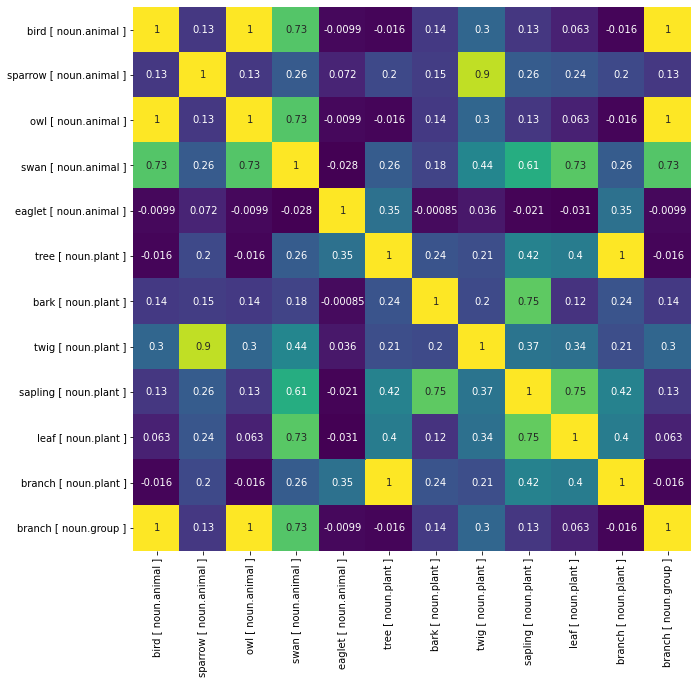

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10, 10))
sns.heatmap(similarity_spacy_trf, 
            xticklabels = list(dict_emb_spacy_trf.keys()), 
            yticklabels = list(dict_emb_spacy_trf.keys()),
            annot=True, fmt=".2g", cmap='viridis', cbar = False, ax = ax);

#### Transformers standalone package

In [ ]:
from transformers import AutoTokenizer, AutoModel, TFAutoModel
import torch

from bertviz import head_view

In [ ]:
#alternatively, use "sentence-transformers/stsb-roberta-large"
trf_tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")


In [ ]:
trf_model = AutoModel.from_pretrained("bert-base-uncased", output_attentions=True, force_download = True)

In [ ]:
print(type(trf_tokenizer ))
print(type(trf_model))

<class 'transformers.models.bert.tokenization_bert_fast.BertTokenizerFast'>
<class 'transformers.models.bert.modeling_bert.BertModel'>


In [ ]:
gc.collect()

16716

In [ ]:
torch.set_printoptions(precision=4, linewidth = 150)

In [ ]:
#how it works
sentences = ["The fallen blossoms don't return to branch."]
tokens_trff = trf_tokenizer(sentences, max_length=30, 
                            padding="max_length", truncation=True, 
                            add_special_tokens =True, return_offsets_mapping=True,
                            return_attention_mask = True, return_token_type_ids = False,
                            return_tensors='pt')
pp.pprint(tokens_trff)

print("-------------------------------------------------------------------")
toks = trf_tokenizer.convert_ids_to_tokens(tokens_trff["input_ids"][0]) 
pp.pprint(toks)

print("-------------------------------------------------------------------")
trf_tokenizer.convert_tokens_to_string(toks)

{'attention_mask': tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]),
 'input_ids': tensor([[  101,  1996,  5357, 28766,  2123,  1005,  1056,  2709,  2000,  3589,  1012,   102,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0]]),
 'offset_mapping': tensor([[[ 0,  0],
         [ 0,  3],
         [ 4, 10],
         [11, 19],
         [20, 23],
         [23, 24],
         [24, 25],
         [26, 32],
         [33, 35],
         [36, 42],
         [42, 43],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0],
         [ 0,  0]]])}
------------------------------------------

"[CLS] the fallen blossoms don't return to branch. [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD]"

In [ ]:
def align_tokens(tokens_trff, sent, debug_flag = False):
    tens_offsets = tokens_trff["offset_mapping"][0]
    arr_offsets = tens_offsets.to("cpu").numpy()

    trf_tok_starts = [el[0] for el in arr_offsets]
    if debug_flag is True:
        print("trf_tok_starts:", trf_tok_starts)
    max_jj = len(trf_tok_starts) - 1
    while trf_tok_starts[max_jj] == 0:
        max_jj -= 1

    doc1 = nlp(sent)
    doc_tok_starts = [tok.idx for tok in doc1]
    if debug_flag is True:
        print("doc_tok_starts:", doc_tok_starts)

    dict_mappings = {}
    for ii in range(len(doc_tok_starts)):
        sublist = [jj for jj in range(1, max_jj)
                    if (trf_tok_starts[jj] >= doc_tok_starts[ii]) and (trf_tok_starts[jj] < doc_tok_starts[ii+1]) ] 
        dict_mappings[ii] = sublist

    return dict_mappings

In [ ]:
dict_align = align_tokens(tokens_trff, sent = sentences[0], debug_flag = True)
dict_align

trf_tok_starts: [0, 0, 4, 11, 20, 23, 24, 26, 33, 36, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
doc_tok_starts: [0, 4, 11, 20, 22, 26, 33, 36, 42]


{0: [1], 1: [2], 2: [3], 3: [4], 4: [5, 6], 5: [7], 6: [8], 7: [9], 8: []}

**Note** for inference we cannot have offsets , otherwise error `forward() got an unexpected keyword argument 'offset_mapping'`

In [ ]:
tokens_trff2 = trf_tokenizer(sentences, max_length=30, 
                            padding="max_length", truncation=True, 
                            add_special_tokens =True, return_offsets_mapping=False,
                            return_attention_mask = True, return_token_type_ids = False,
                            return_tensors='pt')

pp.pprint(tokens_trff2)

{'attention_mask': tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]),
 'input_ids': tensor([[  101,  1996,  5357, 28766,  2123,  1005,  1056,  2709,  2000,  3589,  1012,   102,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0]])}


In [ ]:
#Inference and  inspect results
with torch.no_grad():
    model_output = trf_model(**tokens_trff2)
    print(type(model_output))
    utility_dir(model_output)
    print("-----------------------------------------------------------------")
    print(type(model_output[0]), model_output[0].shape)
    print(type(model_output.last_hidden_state), model_output.last_hidden_state.shape)
    print("")
    print(type(model_output[1]), model_output[1].shape)
    print(type(model_output.pooler_output), model_output.pooler_output.shape)
    print("")
    attention = model_output.attentions
    print(type(model_output.attentions), len(model_output.attentions))
    pp.pprint([el.shape for el in model_output.attentions])
    print("------------------------------------------------------------------")
    #get first 10 items in each embedding of the 30; remark 1st, 11st,12th rows
    for ii in range(30):
        print(model_output[0][0][ii][0:10])
    print("------------------------------------------------------------------")



<class 'transformers.modeling_outputs.BaseModelOutputWithPoolingAndCrossAttentions'>
attentions  clear       copy               cross_attentions  fromkeys         get            hidden_states
items       keys        last_hidden_state  move_to_end       past_key_values  pooler_output  pop
popitem     setdefault  to_tuple           update            values
-----------------------------------------------------------------
<class 'torch.Tensor'> torch.Size([1, 30, 768])
<class 'torch.Tensor'> torch.Size([1, 30, 768])

<class 'torch.Tensor'> torch.Size([1, 768])
<class 'torch.Tensor'> torch.Size([1, 768])

<class 'tuple'> 12
[torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]),
 torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30]),
 torch.Size([1, 12, 30, 30]), torch.Size([1, 12, 30, 30])]
---------------------

In [ ]:
head_view(attention, toks)

In [ ]:
def trf_end2end_emb(token_idx_original, sent, debug_flag = False):
    
    sentences = [sent]
    tokens_trff = trf_tokenizer(sentences, max_length=30, 
                                padding="max_length", truncation=True, 
                                add_special_tokens =True, return_offsets_mapping=True,
                                return_token_type_ids = False,
                                return_tensors='pt')
    dict_align = align_tokens(tokens_trff, sent = sent)


    
    tokens_trff2 = trf_tokenizer(sentences, max_length=30, 
                            padding="max_length", truncation=True, 
                            add_special_tokens =True, return_offsets_mapping=False,
                            return_token_type_ids = False,
                            return_tensors='pt')

    with torch.no_grad():
        model_output = trf_model(**tokens_trff2)
        tok_emb_parts = model_output[0][0][dict_align[token_idx_original]]

        if debug_flag is True:
            print(dict_align[token_idx_original])
            print(model_output[0][0][dict_align[token_idx_original]].shape)

        #take mean of the subparts vectors to obtain token vector
        tok_emb = tok_emb_parts.mean(axis=0)

    return tok_emb

In [ ]:
#"blossoms"
emb_ = trf_end2end_emb(token_idx_original = 2, sent = "The fallen blossoms don't return to branch.", debug_flag = True)
emb_.shape

[3]
torch.Size([1, 768])


torch.Size([768])

In [ ]:
dict_emb_trf = {}

for ii,tup in enumerate(demo_contexts):
    emb_ = trf_end2end_emb(token_idx_original = tup[1], sent = tup[0])

    word, topic = list_demo_nouns[ii]
    new_key = "{} [ {} ]".format(word, topic)
    print("------------------", new_key)
    dict_emb_trf[new_key] = emb_

------------------ bird [ noun.animal ]
------------------ sparrow [ noun.animal ]
------------------ owl [ noun.animal ]
------------------ swan [ noun.animal ]
------------------ eaglet [ noun.animal ]
------------------ tree [ noun.plant ]
------------------ bark [ noun.plant ]
------------------ twig [ noun.plant ]
------------------ sapling [ noun.plant ]
------------------ leaf [ noun.plant ]
------------------ branch [ noun.plant ]
------------------ branch [ noun.group ]


In [ ]:
arr_word_emb = np.vstack(list(dict_emb_trf.values()))
arr_word_emb.shape

(12, 768)

In [ ]:
distances_trf = pairwise_distances(arr_word_emb, metric="cosine")
distances_trf.shape

(12, 12)

In [ ]:
similarity_trf = 1 - distances_trf

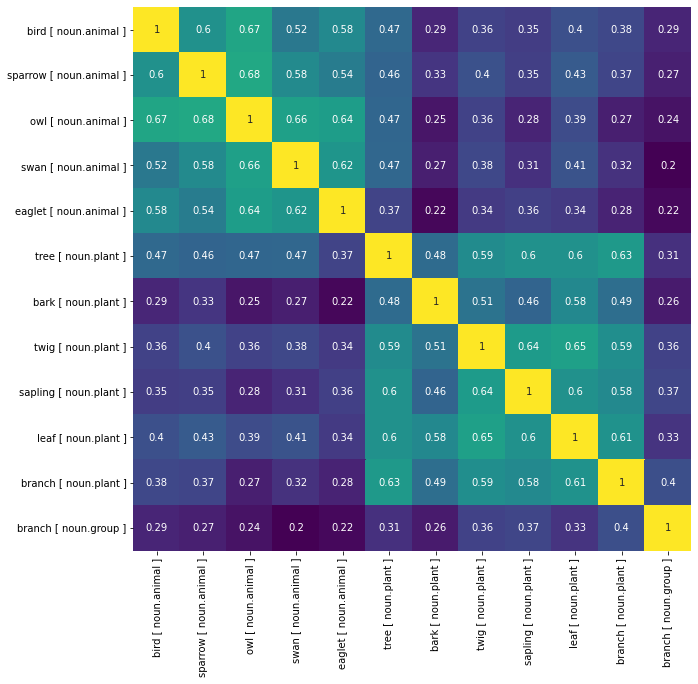

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10, 10))
sns.heatmap(similarity_trf, 
            xticklabels = list(dict_emb_trf.keys()), 
            yticklabels = list(dict_emb_trf.keys()),
            annot=True, fmt=".2g", cmap='viridis', cbar = False, ax = ax);

-------------------------

# Binary classifier of proverbs - Figurative vs Real Semantics

In [ ]:
import tensorflow as tf
from sklearn.metrics import confusion_matrix

#logging levels : 0 = INFO , 1 = WARN , 2 = ERROR, 3 = none (not used in TF2)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

#logging level for TF2
tf.get_logger().setLevel('ERROR')

In [ ]:
df_figurative = pd.read_csv("/content/gdrive/My Drive/proverbs/figurative_annot.csv")
df_figurative.head()

,Unnamed: 0,Id,Translated,Figurative
0,0,1_1,Breaking the watch does not stop the fleeting time.,N
1,1,1_2,Time and hours do not wait.,N
2,2,1_3,Lost time is never regained.,N
3,3,1_4,No man is rich enough to buy back his past.,Y
4,4,1_5,"The day that has passed, one does not get back.",N


In [ ]:
df_figurative["Figurative"].value_counts()

N    493
Y    168
Name: Figurative, dtype: int64

In [ ]:
df_merged = pd.merge(left = df_proverbs, right = df_figurative,
                     left_on = "id", right_on = "Id", how="inner", suffixes=["","_"])

df_merged = df_merged[["translated", "doc", "Figurative"]]
df_merged.head()

,translated,doc,Figurative
0,Breaking the watch does not stop the fleeting time.,"(Breaking, the, watch, does, not, stop, the, fleeting, time, .)",N
1,Time and hours do not wait.,"(Time, and, hours, do, not, wait, .)",N
2,Lost time is never regained.,"(Lost, time, is, never, regained, .)",N
3,No man is rich enough to buy back his past.,"(No, man, is, rich, enough, to, buy, back, his, past, .)",Y
4,"The day that has passed, one does not get back.","(The, day, that, has, passed, ,, one, does, not, get, back, .)",N


In [ ]:
df_merged["Figurative"].value_counts()

N    489
Y    168
Name: Figurative, dtype: int64

Stratified sampling to exemplify both classes:

In [ ]:
df_merged.groupby('Figurative', group_keys=False).apply(lambda x: x.sample(min(len(x), 5)))

,translated,doc,Figurative
344,Patience is the virtue of the wise men.,"(Patience, is, the, virtue, of, the, wise, men, .)",N
156,"Without stooping down for the mushroom, you cannot put it in your basket.","(Without, stooping, down, for, the, mushroom, ,, you, can, not, put, it, in, your, basket, .)",N
73,"When there is one sheep over the dam, more will follow it.","(When, there, is, one, sheep, over, the, dam, ,, more, will, follow, it, .)",N
598,"Of the flattering friend, repugnance and fear.","(Of, the, flattering, friend, ,, repugnance, and, fear, .)",N
148,"He that would eat the kernel, must crack the nut.","(He, that, would, eat, the, kernel, ,, must, crack, the, nut, .)",N
586,You have to adapt your flight to your wings,"(You, have, to, adapt, your, flight, to, your, wings)",Y
430,A limited brain can store an unlimited amount of stupid thoughts.,"(A, limited, brain, can, store, an, unlimited, amount, of, stupid, thoughts, .)",Y
617,"You can adorn yourself with someone else's feathers, but you cannot fly.","(You, can, adorn, yourself, with, someone, else, 's, feathers, ,, but, you, can, not, fly, .)",Y
134,"All that we see or seem, is but a dream within a dream.","(All, that, we, see, or, seem, ,, is, but, a, dream, within, a, dream, .)",Y
648,The owl sees in his son a falcon.,"(The, owl, sees, in, his, son, a, falcon, .)",Y


As before, but return Tensorflow tensors , "tf" instead of "pt"

In [ ]:
arr_sentences = df_merged["translated"].str.lower().values

arr_sentences[0:5]

array(['breaking the watch does not stop the fleeting time.',
       'time and hours do not wait.', 'lost time is never regained.',
       'no man is rich enough to buy back his past.',
       'the day that has passed, one does not get back.'], dtype=object)

In [ ]:
labels_ohe = pd.get_dummies(df_merged["Figurative"])
labels_ohe

,N,Y
0,1,0
1,1,0
2,1,0
3,0,1
4,1,0
...,...,...
654,0,1
655,0,1
656,1,0
657,0,1


In [ ]:
labels = labels_ohe.values
labels.shape

(659, 2)

In [ ]:
ds = tf.data.Dataset.from_tensor_slices((arr_sentences, labels))

def name_func(texts, labs):
    return {"input_text" : texts}, labs

ds = ds.map(name_func)

for el in ds.take(1):
    print(el)

({'input_text': <tf.Tensor: shape=(), dtype=string, numpy=b'breaking the watch does not stop the fleeting time.'>}, <tf.Tensor: shape=(2,), dtype=uint8, numpy=array([1, 0], dtype=uint8)>)


In [ ]:
batch_size = 32
#here we use drop_remainder=True to keep only complete batches (discarding last incomplete batch)
ds = ds.shuffle(10000).batch(batch_size, drop_remainder=True)

#number of batches
num_batches = len(list(ds))
num_batches

20

In [ ]:
train_ds = ds.take(round(0.8 * num_batches))
valid_ds = ds.skip(round(0.8 * num_batches))

num_batches_train = len(list(train_ds))
num_batches_valid = len(list(valid_ds))
print("num batches train: {} , nm batches valid ={}".format(num_batches_train, num_batches_valid))

num batches train: 16 , nm batches valid =4


Model architecture:


In [ ]:
trf_tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")

In [ ]:
trf_model = TFAutoModel.from_pretrained("bert-base-uncased", output_attentions=True, force_download = True)


Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['mlm___cls', 'nsp___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [ ]:
@tf.function
def debug_function(x):
    #tf.print(type(x), " | shape:", tf.shape(x),
    #         output_stream=sys.stdout)
    #would be <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [32 30 768]
    return x


def tokenize_trf(x):
    #since trf_tokenizer cannot act on tensors, we can't decorate this as @tf.function    
    #note: the input x is tf.Tensor([[b'Hurry is spoiling the job.'],  [b'False praise is worse than insult.'], ...], shape=(32, 1), dtype=string)
    list_x = [bytes.decode(el[0]) for el in x.numpy()]
    #note: list_x is ['Hurry is spoiling the job.', 'False praise is worse than insult.', ...]    
    tokens_trff2 = trf_tokenizer(list_x, max_length=30, 
                        padding="max_length", truncation=True, 
                        add_special_tokens =True, return_offsets_mapping=False,
                        return_attention_mask = True, return_token_type_ids = False,
                        return_tensors='tf')
    #we convert the results back to tensors
    tens_ids = tf.convert_to_tensor(tokens_trff2["input_ids"], dtype = tf.int32)
    tens_attent = tf.convert_to_tensor(tokens_trff2["attention_mask"], dtype = tf.int32)
    return [tens_ids, tens_attent]


@tf.function
def setsize_func(x):
    #we need to explicitly set size 
    x.set_shape([batch_size, 30])
    return x

#--------------------------------------------------------------------------------

text_input = tf.keras.Input(shape=(1,), dtype=tf.string, name='input_text')

token = tf.py_function(func=tokenize_trf, inp=[text_input] , Tout=[tf.int32, tf.int32])

token1 = tf.keras.layers.Lambda(lambda x: setsize_func(x[0]),
                                name = "setsize1")(token)
token2 = tf.keras.layers.Lambda(lambda x: setsize_func(x[1]),
                                name = "setsize2")(token)

embeddings = trf_model(token1, attention_mask = token2)[0]

debug_layer = tf.keras.layers.Lambda(lambda x: debug_function(x),
                                               name = "debug1")(embeddings)

X = tf.keras.layers.GlobalAvgPool1D()(debug_layer)
X = tf.keras.layers.BatchNormalization()(X)

X = tf.keras.layers.Dense(128, activation="relu")(X)
X = tf.keras.layers.Dropout(0.1)(X)
X = tf.keras.layers.Dense(32, activation="relu")(X)

output1 = tf.keras.layers.Dense(2, activation="softmax", name="outputs")(X)

model = tf.keras.Model(inputs = text_input, outputs = output1, name = "model_classif")

assert(model.layers[4].name == "tf_bert_model")
model.layers[4].trainable = False

In [ ]:
model.summary()

Model: "model_classif"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_text (InputLayer)         [(None, 1)]          0                                            
__________________________________________________________________________________________________
tf.py_function_2 (TFOpLambda)   [None, None]         0           input_text[0][0]                 
__________________________________________________________________________________________________
setsize1 (Lambda)               (32, 30)             0           tf.py_function_2[0][0]           
                                                                 tf.py_function_2[0][1]           
__________________________________________________________________________________________________
setsize2 (Lambda)               (32, 30)             0           tf.py_function_2[0][0

In [ ]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.01),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = [tf.metrics.CategoricalAccuracy("acc")]
              )

In [ ]:
!rm -r -f '/tmp/checkpoint_model1'
!mkdir -p '/tmp/checkpoint_model1'

In [ ]:
checkpoint_filepath = '/tmp/checkpoint_model1'
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
                                filepath=checkpoint_filepath,
                                save_weights_only=True,
                                monitor='val_loss',
                                mode='min',
                                save_best_only=True,
                                verbose=1)

In [ ]:
#handling class imbalance by penalizing double a misclassif of original "yes"(fictive proverbs)
#classes are 0 = no, 1 = yes
class_weight = {0: 1, 1: 2}

history = model.fit(train_ds, validation_data = valid_ds,
                    class_weight=class_weight,
                    callbacks = [checkpoint_callback],
                    epochs = 10)

Epoch 1/10
16/16 [==============================] - 72s 4s/step - loss: 0.9818 - acc: 0.7241 - val_loss: 0.5749 - val_acc: 0.7344

Epoch 00001: val_loss improved from inf to 0.57491, saving model to /tmp/checkpoint_model1
Epoch 2/10
16/16 [==============================] - 63s 4s/step - loss: 0.6595 - acc: 0.7815 - val_loss: 0.5736 - val_acc: 0.7656

Epoch 00002: val_loss improved from 0.57491 to 0.57360, saving model to /tmp/checkpoint_model1
Epoch 3/10
16/16 [==============================] - 63s 4s/step - loss: 0.6073 - acc: 0.7865 - val_loss: 0.5403 - val_acc: 0.8594

Epoch 00003: val_loss improved from 0.57360 to 0.54031, saving model to /tmp/checkpoint_model1
Epoch 4/10
16/16 [==============================] - 63s 4s/step - loss: 0.5085 - acc: 0.8401 - val_loss: 0.5011 - val_acc: 0.8828

Epoch 00004: val_loss improved from 0.54031 to 0.50105, saving model to /tmp/checkpoint_model1
Epoch 5/10
16/16 [==============================] - 62s 4s/step - loss: 0.3451 - acc: 0.9132 - val_l

In [ ]:
!mkdir -p "/content/gdrive/My Drive/proverbs/checkpoint_model_classif"

!cp -r /tmp/checkpoint_model1 "/content/gdrive/My Drive/proverbs/checkpoint_model_classif/"
!cp /tmp/checkpoint_model1.data-00000-of-00001 "/content/gdrive/My Drive/proverbs/checkpoint_model_classif/"
!cp /tmp/checkpoint_model1.index "/content/gdrive/My Drive/proverbs/checkpoint_model_classif/"

!tree -h "/content/gdrive/My Drive/proverbs/checkpoint_model_classif/"

/content/gdrive/My Drive/proverbs/checkpoint_model_classif/
├── [  91]  checkpoint
├── [4.0K]  checkpoint_model1
├── [419M]  checkpoint_model1.data-00000-of-00001
└── [ 16K]  checkpoint_model1.index

1 directory, 3 files


**Plots**

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'acc', 'val_loss', 'val_acc'])


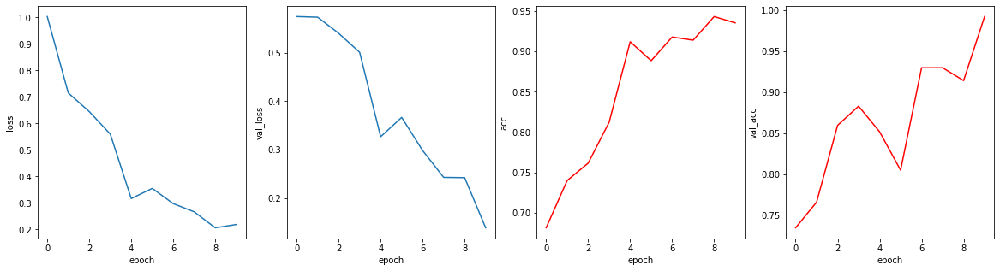

In [ ]:
#plot the evolution of loss and val_loss
fig, ax = plt.subplots(1, 4, figsize = (20, 5))
ax[0].plot(history.history['loss'])
ax[1].plot(history.history['val_loss'])
ax[2].plot(history.history['acc'], color = "red")
ax[3].plot(history.history['val_acc'], color = "red")

ax[0].set_ylabel('loss')
ax[0].set_xlabel('epoch')

ax[1].set_ylabel('val_loss')
ax[1].set_xlabel('epoch')

ax[2].set_ylabel('acc')
ax[2].set_xlabel('epoch')

ax[3].set_ylabel('val_acc')
ax[3].set_xlabel('epoch');

**Confusion matrix:**

In [ ]:
%%time
res = model.predict(arr_sentences[0:num_batches*batch_size])

print(res.shape)

(640, 2)
CPU times: user 1min 44s, sys: 11.4 s, total: 1min 55s
Wall time: 1min 5s


In [ ]:
arr_res_label = np.argmax(res, axis =1)
print(arr_res_label[0:20])

print("vs")

print(labels_ohe["Y"].values[0:20])

[0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1]
vs
[0 0 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1]


In [ ]:
cmat = confusion_matrix(arr_res_label, labels_ohe["Y"].values[0:num_batches*batch_size])
cmat

array([[476,  11],
       [  7, 146]])

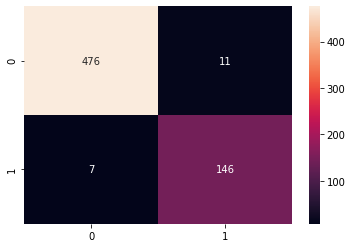

In [ ]:
sns.heatmap(cmat, annot=True, fmt="g");

only 18 misclassified out of total 640

**Misclassified instances:**

In [ ]:
idx_misclassif = np.where(np.not_equal(arr_res_label, labels_ohe["Y"].values[0:num_batches*batch_size]))

df_merged.iloc[idx_misclassif].sort_values(by="Figurative")

,translated,doc,Figurative
369,A small tear relieves a great sorrow.,"(A, small, tear, relieves, a, great, sorrow, .)",N
42,"He that would make a golden gate, must bring a nail to it daily.","(He, that, would, make, a, golden, gate, ,, must, bring, a, nail, to, it, daily, .)",N
186,"Charm strikes the sight, but merit wins the soul.","(Charm, strikes, the, sight, ,, but, merit, wins, the, soul, .)",N
306,A friend in need is a friend indeed.,"(A, friend, in, need, is, a, friend, indeed, .)",N
621,Good fame is better than a golden belt.,"(Good, fame, is, better, than, a, golden, belt, .)",N
372,A friend to all is the same as a friend to none.,"(A, friend, to, all, is, the, same, as, a, friend, to, none, .)",N
382,Better a good neighbor than a distant friend.,"(Better, a, good, neighbor, than, a, distant, friend, .)",N
537,Old habit is stronger than letter and seal.,"(Old, habit, is, stronger, than, letter, and, seal, .)",Y
477,Good fences make good neighbors.,"(Good, fences, make, good, neighbors, .)",Y
442,You don't have to worry about the snow burning.,"(You, do, n't, have, to, worry, about, the, snow, burning, .)",Y


**Test with new proverbs:**

In [ ]:
test_proverbs = ["A kiss without a hug is like a flower without the fragrance.",
                 "My friends are like stars, pick one and it'll guide you.",
                 "The stars are the eyes of Heaven",
                 "Don't expect a cherry tree from an acorn.",
                 "The wound of words is worse than the wound of swords.",
                 "Dogs have so many friends because they wag their tails, not their tongues.",
                 "A kind word is like a spring day.",
                 "Spring has come when you can put your foot on three daisies.",
                 "There is no winter without snow, no spring without sunshine, and no happiness without companions.",
                 "No year has two summers."]

len_init = len(test_proverbs)

#the workaround earlier to explicitly set tensor size urges us to alays provide a batch of 32 for inference
for ii in range(len_init, batch_size):
    test_proverbs.append("Dummy")

In [ ]:
res = model.predict(test_proverbs)
print("---------------------------------------------")
#the columns in res are in order: No , Yes
res[0:len_init]

---------------------------------------------


array([[0.3099716 , 0.6900284 ],
       [0.11241914, 0.8875808 ],
       [0.41531658, 0.5846834 ],
       [0.71514773, 0.28485224],
       [0.18588203, 0.81411797],
       [0.50634485, 0.49365512],
       [0.03809045, 0.96190953],
       [0.7321531 , 0.26784688],
       [0.59893626, 0.4010637 ],
       [0.9966016 , 0.00339845]], dtype=float32)

**Model Predictions Explainability**

see https://github.com/marcotcr/lime/issues/356

In [ ]:
from lime.lime_text import LimeTextExplainer

In [ ]:
def helper_explain(input_sentence):
    """glue code between the explainer and our model"""

    if isinstance(input_sentence, list):
        exp_proverbs = input_sentence
    elif isinstance(input_sentence, str):
        exp_proverbs = [input_sentence]

    len_init = len(exp_proverbs)
    ceil_num_batches = math.ceil(len_init/batch_size)

    print("ceil_num_batches = ", ceil_num_batches)

    for ii in range(len_init, ceil_num_batches * batch_size):
        exp_proverbs.append("Dummy")

    #pp.pprint(exp_proverbs)
    res = model.predict(exp_proverbs)

    return res[0:len_init]
    

####example:
helper_explain("The stars are the eyes of Heaven")

ceil_num_batches =  1


array([[0.41531658, 0.5846834 ]], dtype=float32)

In [ ]:
explainer = LimeTextExplainer(class_names=["no", "yes"])

In [ ]:
help(explainer.explain_instance)

Help on method explain_instance in module lime.lime_text:

explain_instance(text_instance, classifier_fn, labels=(1,), top_labels=None, num_features=10, num_samples=5000, distance_metric='cosine', model_regressor=None) method of lime.lime_text.LimeTextExplainer instance
    Generates explanations for a prediction.
    
    First, we generate neighborhood data by randomly hiding features from
    the instance (see __data_labels_distance_mapping). We then learn
    locally weighted linear models on this neighborhood data to explain
    each of the classes in an interpretable way (see lime_base.py).
    
    Args:
        text_instance: raw text string to be explained.
        classifier_fn: classifier prediction probability function, which
            takes a list of d strings and outputs a (d, k) numpy array with
            prediction probabilities, where k is the number of classes.
            For ScikitClassifiers , this is classifier.predict_proba.
        labels: iterable with labe

#### Illustrations with non-figurative proverbs

In [ ]:
%%time

a_proverb = "There is no winter without snow, no spring without sunshine, and no happiness without companions."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 40s, sys: 1min 4s, total: 14min 44s
Wall time: 8min 9s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
utility_dir(exp)

as_html    as_list           as_map      as_pyplot_figure  available_labels  class_names   domain_mapper
intercept  local_exp         local_pred  mode              predict_proba     random_state  save_to_file
score      show_in_notebook  top_labels


In [ ]:
print(exp.available_labels())
print(exp.class_names)

[1]
['no', 'yes']


**Another illustration:**

In [ ]:
%%time

a_proverb = "Spring has come when you can put your foot on three daisies."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 40s, sys: 1min 6s, total: 14min 46s
Wall time: 8min 11s


In [ ]:
exp.show_in_notebook(text=a_proverb)

**Another illustration:**

In [ ]:
%%time

a_proverb = "You cannot build a wall with one stone."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 38s, sys: 1min 15s, total: 14min 54s
Wall time: 8min 20s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('wall', 0.16118770085823167),
 ('You', 0.1538925532317557),
 ('stone', 0.10316414833537886),
 ('cannot', -0.09098519938246642),
 ('with', 0.08830586968729126),
 ('build', 0.057819438170677896),
 ('one', -0.04763633225967606),
 ('a', 0.008905184350443433)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "White flowers are not to be found in a coal sack."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 38s, sys: 1min 16s, total: 14min 55s
Wall time: 8min 21s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('flowers', -0.07402497804395848),
 ('found', -0.046124466195383816),
 ('are', -0.03858931516241072),
 ('coal', 0.03490555230881176),
 ('sack', -0.025520239859015848),
 ('not', -0.02415693826204705),
 ('in', -0.01613892707634439),
 ('White', -0.01567667564584503),
 ('a', 0.013690103191697837),
 ('be', 0.006340703914947534)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "Don't expect a cherry tree from an acorn."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 39s, sys: 1min 16s, total: 14min 56s
Wall time: 8min 22s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('acorn', 0.13606333083917652),
 ('tree', 0.08555296134342225),
 ('expect', -0.07218870653373335),
 ('Don', 0.06947649421196307),
 ('from', 0.03552223115063015),
 ('an', 0.03472627208832087),
 ('t', -0.018805436829869814),
 ('a', 0.015355830326053267),
 ('cherry', -0.011409552719718795)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "Those who can't dance, blame it on the music."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 39s, sys: 1min 16s, total: 14min 56s
Wall time: 8min 22s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('dance', 0.15714695697439413),
 ('blame', -0.11182388975124725),
 ('the', -0.10846353290927953),
 ('music', 0.09165140063817762),
 ('on', 0.07629208718973027),
 ('Those', 0.07371597899940643),
 ('can', 0.0676729963551916),
 ('who', 0.03640956938495916),
 ('t', -0.017403154079439192),
 ('it', 0.006547838150771537)]

#### Illustrations with figurative proverbs

In [ ]:
%%time

a_proverb = "Books speak to the mind, friends to the heart, heaven to the soul, all else to the ears."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 38s, sys: 1min 16s, total: 14min 55s
Wall time: 8min 20s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('to', 0.14315770087514482),
 ('speak', 0.1363187534345878),
 ('ears', 0.10480584428777164),
 ('the', 0.09198980309641452),
 ('mind', 0.08214761427782057),
 ('heaven', 0.07080547903376508),
 ('soul', 0.06305980006840532),
 ('else', 0.062376545547493216),
 ('friends', -0.0494417549834836),
 ('heart', 0.03596477582244786)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "A kind word is like a spring day."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 39s, sys: 1min 16s, total: 14min 55s
Wall time: 8min 20s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('word', 0.26931592119857),
 ('kind', 0.2213056805738558),
 ('like', 0.19307290463151242),
 ('is', 0.17301575680061085),
 ('spring', 0.10599329569613973),
 ('A', 0.09595385062906192),
 ('a', 0.09415155142077213),
 ('day', -0.017790506251218433)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "Ambition is putting a ladder against the sky."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 35s, sys: 1min 11s, total: 14min 46s
Wall time: 8min 14s


In [ ]:
exp.show_in_notebook(text=a_proverb)

**Another illustration:**

In [ ]:
%%time

a_proverb = "The bear knows seven songs and they are all about honey."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 33s, sys: 1min 11s, total: 14min 44s
Wall time: 8min 13s


In [ ]:
exp.show_in_notebook(text=a_proverb)

**Another illustration:**

In [ ]:
%%time

a_proverb = "A book is like a garden carried in the pocket."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 39s, sys: 1min 12s, total: 14min 51s
Wall time: 8min 18s


In [ ]:
exp.show_in_notebook(text=a_proverb)

Sidenote:  if we remove "like" the predicted label becomes "no" (i.e. non-figurative)  :

In [ ]:
%%time

a_proverb = "A book is a garden carried in the pocket."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 40s, sys: 1min 16s, total: 14min 56s
Wall time: 8min 22s


In [ ]:
exp.show_in_notebook(text=a_proverb)

#### Illustrations of misclassified proverbs

In [ ]:
%%time

a_proverb = "It's not healthy to swallow books without chewing."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 33s, sys: 1min 14s, total: 14min 48s
Wall time: 8min 16s


In [ ]:
exp.show_in_notebook(text=a_proverb)

**Another illustration:**

In [ ]:
%%time

a_proverb = "In the kingdom of hope, there is no winter."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

ceil_num_batches =  157
CPU times: user 13min 39s, sys: 1min 8s, total: 14min 47s
Wall time: 8min 13s


In [ ]:
exp.show_in_notebook(text=a_proverb)

In [ ]:
exp.as_list(label=1)

[('hope', 0.15487826794032047),
 ('winter', -0.109587032853814),
 ('no', -0.0717965899090661),
 ('there', 0.06905545591906753),
 ('kingdom', 0.06701915730555014),
 ('the', -0.03171337694054603),
 ('In', 0.01826365923231155),
 ('of', 0.015607097016249107),
 ('is', -0.01213142192882281)]

**Another illustration:**

In [ ]:
%%time

a_proverb = "The word is silver, the silence is gold."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)


ceil_num_batches =  157
CPU times: user 13min 40s, sys: 1min 27s, total: 15min 8s
Wall time: 8min 33s


In [ ]:
exp.show_in_notebook(text=a_proverb)

**Another illustration:**

In [ ]:
a_proverb = "He that would make a golden gate, must bring a nail to it daily."

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain)

In [ ]:
exp.show_in_notebook(text=a_proverb)

------------

Sidenote: which versions of a proverb are used in LIME

In [ ]:
def helper_explain_debug(input_sentence):
    """glue code between the explainer and our model"""

    if isinstance(input_sentence, list):
        exp_proverbs = input_sentence
    elif isinstance(input_sentence, str):
        exp_proverbs = [input_sentence]

    len_init = len(exp_proverbs)
    ceil_num_batches = math.ceil(len_init/batch_size)

    print("ceil_num_batches = ", ceil_num_batches)
    print("-----------------------------------------------------------")
    count1 = coll.Counter(input_sentence)
    count1_list = [(k,v) for k,v in count1.items()]
    utility_print_lists_columnized(count1_list, num_cols_columnize=4)
    print("-----------------------------------------------------------")

    for ii in range(len_init, ceil_num_batches * batch_size):
        exp_proverbs.append("Dummy")

    #pp.pprint(exp_proverbs)
    res = model.predict(exp_proverbs)

    return res[0:len_init]
    


In [ ]:
%%time

a_proverb = "Love sees no faults"

exp = explainer.explain_instance(text_instance = a_proverb, 
                                 classifier_fn = helper_explain_debug)


ceil_num_batches =  157
-----------------------------------------------------------
('Love sees no faults', 1)  ('Love sees  ', 196)        ('   faults', 341)        ('Love sees no ', 302)
('   ', 1231)               ('Love sees  faults', 315)  ('Love   ', 347)          ('Love   faults', 202)
(' sees no ', 206)          ('  no faults', 229)        ('  no ', 331)            ('Love  no ', 208)
(' sees no faults', 260)    (' sees  faults', 222)      ('Love  no faults', 314)  (' sees  ', 295)

-----------------------------------------------------------
CPU times: user 13min 37s, sys: 1min 11s, total: 14min 48s
Wall time: 8min 16s


In [ ]:
exp.show_in_notebook(text=a_proverb)